# Vanilla GAN

- Referecnce : https://github.com/eriklindernoren/PyTorch-GAN

In [1]:
import argparse
import os
import numpy as np
import math

import torchvision
import torchvision.transforms as transforms
from torchvision.utils import save_image

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch

In [2]:
device = 'cuda:1' if torch.cuda.is_available() else 'cpu'

## Define Generator & Discriminator
- layers would be mlp
- Activations except last one are nn.LeakyReLU(0.2)
- BachNorm parameter = 0.8
- Dropout p = 0.5

In [3]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        #### Implement Here ####
        self.block1 = self.make_block(100,256)
        self.block2 = self.make_block(256,512)
        self.block3 = self.make_block(512,1024)
        self.dropout = nn.Dropout()
        self.fc_last = nn.Linear(1024, 784)
        self.tanh = nn.Tanh()

    def make_block(self, in_feat, out_feat):
        #### Implement Here ####
        layers = []
        layers += [nn.Linear(in_feat, out_feat),
                   nn.LeakyReLU(0.2),
                   nn.BatchNorm1d(out_feat)]

        return nn.Sequential(*layers)

    def forward(self, z):
        #### Implement Here ####
        z = self.block1(z)
        z = self.block2(z)
        z = self.block3(z)
        z = self.dropout(z)
        z = self.fc_last(z)
        z = self.tanh(z)
        img = z.view(z.size(0), 1, 28, 28)
        
        return img

In [4]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        #### Implement Here ####
        self.dropout = nn.Dropout()
        self.fc1 = nn.Linear(784, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc3 = nn.Linear(256, 1)
        self.act = nn.LeakyReLU(0.2)
        self.act_last = nn.Sigmoid()
        
    def forward(self, img):
        #### Implement Here ####
        # Hint : Image should be resized before go through network
        x = img.view(img.size(0), -1)
        x = self.dropout(x)
        x = self.fc1(x)
        x = self.act(x)
        x = self.fc2(x)
        x = self.act(x)
        x = self.fc3(x)
        x = self.act_last(x)

        return x

In [5]:
# Initialize generator and discriminator
G = Generator()
D = Discriminator()

In [8]:
from torchsummary import summary
summary(G, device = 'cpu', batch_size = -1, input_size = (100,))
summary(D, device = 'cpu', batch_size = -1, input_size = (1, 28, 28))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                  [-1, 256]          25,856
         LeakyReLU-2                  [-1, 256]               0
       BatchNorm1d-3                  [-1, 256]             512
            Linear-4                  [-1, 512]         131,584
         LeakyReLU-5                  [-1, 512]               0
       BatchNorm1d-6                  [-1, 512]           1,024
            Linear-7                 [-1, 1024]         525,312
         LeakyReLU-8                 [-1, 1024]               0
       BatchNorm1d-9                 [-1, 1024]           2,048
          Dropout-10                 [-1, 1024]               0
           Linear-11                  [-1, 784]         803,600
             Tanh-12                  [-1, 784]               0
Total params: 1,489,936
Trainable params: 1,489,936
Non-trainable params: 0
---------------------------

## Define loss & Optimizer & model

In [9]:
# Loss function
criterion = torch.nn.BCELoss()

# Optimizer for each network
optimizer_G = torch.optim.Adam(G.parameters(), lr=0.0001, betas = (0.5, 0.9999))
optimizer_D = torch.optim.Adam(D.parameters(), lr=0.0001, betas = (0.5, 0.9999))

## Use MNIST Dataset & DataLoader

In [10]:
train_bs = 64

dataset = datasets.MNIST("./mnist", train=True, download=True, 
                         transform=transforms.Compose([transforms.Resize(28), transforms.ToTensor(), transforms.Normalize([0.5], [0.5])]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=train_bs, shuffle=True, drop_last=True)

torch.Size([64, 1, 28, 28]) tensor([3, 7, 8, 5, 6, 7, 2, 4, 1, 0, 9, 0, 8, 8, 6, 2, 3, 7, 7, 8, 1, 1, 9, 9,
        9, 3, 2, 2, 0, 4, 1, 4, 2, 2, 0, 3, 5, 4, 1, 2, 7, 1, 3, 1, 1, 1, 2, 9,
        3, 2, 8, 4, 3, 5, 7, 4, 5, 0, 2, 1, 9, 5, 5, 0])


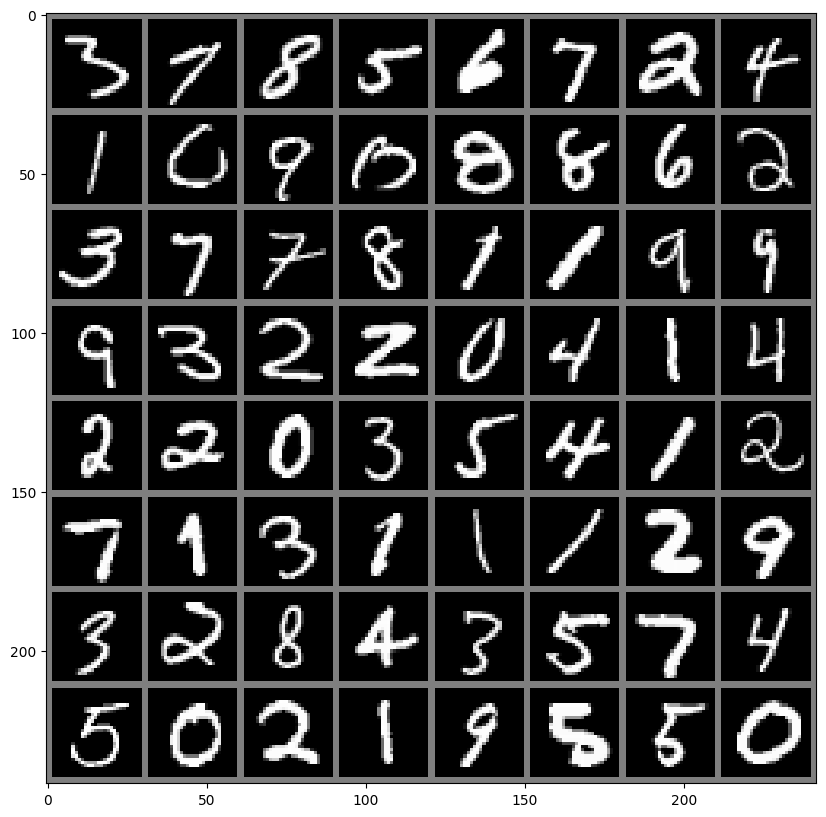

In [11]:
import matplotlib.pyplot as plt
import numpy as np

batch = next(iter(dataloader))
len(batch)
print(batch[0].shape, batch[1])

def imshow(img):
    img = img / 2 + 0.5
    npimg = img.numpy()
    plt.figure(figsize=(20,10))
    plt.imshow(np.transpose(npimg, (1,2,0)))
    plt.show()
    
imshow(torchvision.utils.make_grid(batch[0]))

## Start Training

In [10]:
G, D = G.to(device), D.to(device)
os.makedirs("./mlpgan", exist_ok=True)
epochs = 200

[Epoch 1/200] [Batch 0/937] [D loss: 0.714438] [G loss: 0.704404]


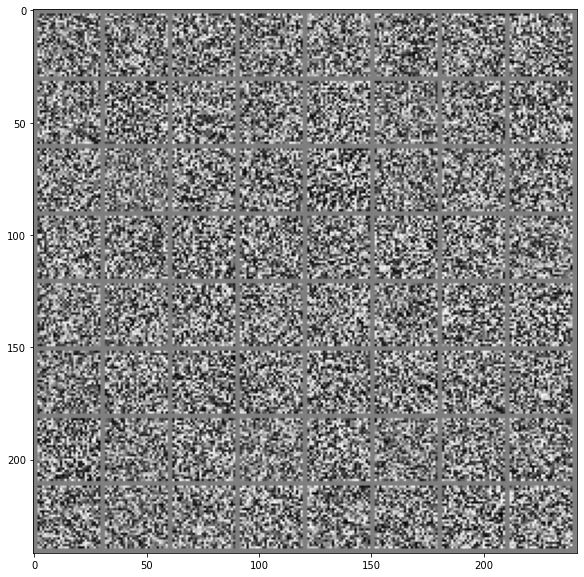

[Epoch 1/200] [Batch 100/937] [D loss: 0.050362] [G loss: 2.632907]
[Epoch 1/200] [Batch 200/937] [D loss: 0.063842] [G loss: 3.656764]
[Epoch 1/200] [Batch 300/937] [D loss: 0.147927] [G loss: 3.503001]
[Epoch 1/200] [Batch 400/937] [D loss: 0.268971] [G loss: 3.390635]
[Epoch 1/200] [Batch 500/937] [D loss: 0.323361] [G loss: 3.122728]
[Epoch 1/200] [Batch 600/937] [D loss: 0.392406] [G loss: 2.298869]
[Epoch 1/200] [Batch 700/937] [D loss: 0.427023] [G loss: 2.147007]
[Epoch 1/200] [Batch 800/937] [D loss: 0.400882] [G loss: 1.397627]
[Epoch 1/200] [Batch 900/937] [D loss: 0.505577] [G loss: 1.341277]
[Epoch 2/200] [Batch 63/937] [D loss: 0.614006] [G loss: 0.707276]
[Epoch 2/200] [Batch 163/937] [D loss: 0.584036] [G loss: 0.687069]
[Epoch 2/200] [Batch 263/937] [D loss: 0.514233] [G loss: 1.089395]
[Epoch 2/200] [Batch 363/937] [D loss: 0.507210] [G loss: 0.748345]
[Epoch 2/200] [Batch 463/937] [D loss: 0.533431] [G loss: 1.136859]
[Epoch 2/200] [Batch 563/937] [D loss: 0.570043] 

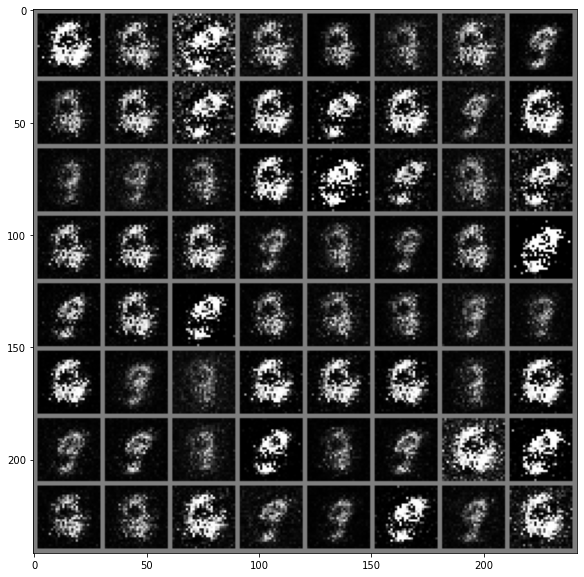

[Epoch 3/200] [Batch 226/937] [D loss: 0.475126] [G loss: 0.876662]
[Epoch 3/200] [Batch 326/937] [D loss: 0.458404] [G loss: 1.156800]
[Epoch 3/200] [Batch 426/937] [D loss: 0.437910] [G loss: 1.804564]
[Epoch 3/200] [Batch 526/937] [D loss: 0.493510] [G loss: 0.655591]
[Epoch 3/200] [Batch 626/937] [D loss: 0.510672] [G loss: 1.507492]
[Epoch 3/200] [Batch 726/937] [D loss: 0.569636] [G loss: 2.264378]
[Epoch 3/200] [Batch 826/937] [D loss: 0.735923] [G loss: 0.515750]
[Epoch 3/200] [Batch 926/937] [D loss: 0.508390] [G loss: 1.379854]
[Epoch 4/200] [Batch 89/937] [D loss: 0.499669] [G loss: 1.269513]
[Epoch 4/200] [Batch 189/937] [D loss: 0.519868] [G loss: 1.004149]
[Epoch 4/200] [Batch 289/937] [D loss: 0.433123] [G loss: 1.311007]
[Epoch 4/200] [Batch 389/937] [D loss: 0.472451] [G loss: 1.810780]
[Epoch 4/200] [Batch 489/937] [D loss: 0.401806] [G loss: 1.192245]
[Epoch 4/200] [Batch 589/937] [D loss: 0.563400] [G loss: 1.217422]
[Epoch 4/200] [Batch 689/937] [D loss: 0.564879] 

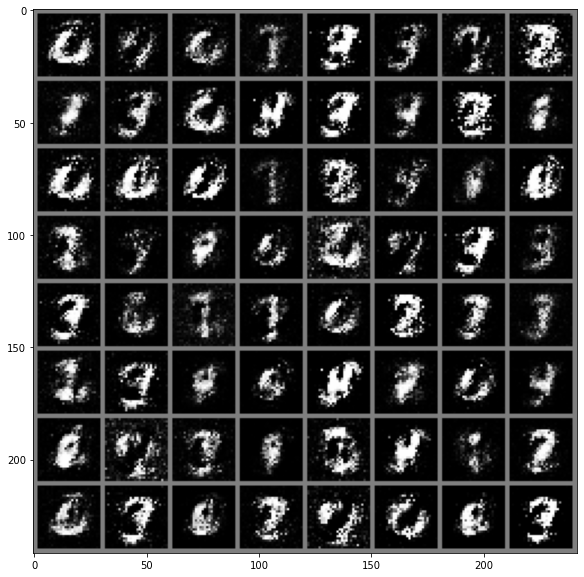

[Epoch 5/200] [Batch 352/937] [D loss: 0.554810] [G loss: 0.892199]
[Epoch 5/200] [Batch 452/937] [D loss: 0.586441] [G loss: 0.633080]
[Epoch 5/200] [Batch 552/937] [D loss: 0.595512] [G loss: 1.237141]
[Epoch 5/200] [Batch 652/937] [D loss: 0.611696] [G loss: 0.800195]
[Epoch 5/200] [Batch 752/937] [D loss: 0.614052] [G loss: 1.047450]
[Epoch 5/200] [Batch 852/937] [D loss: 0.600736] [G loss: 0.915479]
[Epoch 6/200] [Batch 15/937] [D loss: 0.606713] [G loss: 0.839066]
[Epoch 6/200] [Batch 115/937] [D loss: 0.606345] [G loss: 0.861649]
[Epoch 6/200] [Batch 215/937] [D loss: 0.531925] [G loss: 0.958596]
[Epoch 6/200] [Batch 315/937] [D loss: 0.519566] [G loss: 1.053973]
[Epoch 6/200] [Batch 415/937] [D loss: 0.526364] [G loss: 0.917718]
[Epoch 6/200] [Batch 515/937] [D loss: 0.632900] [G loss: 0.803101]
[Epoch 6/200] [Batch 615/937] [D loss: 0.544384] [G loss: 0.940654]
[Epoch 6/200] [Batch 715/937] [D loss: 0.587447] [G loss: 0.755133]
[Epoch 6/200] [Batch 815/937] [D loss: 0.522684] 

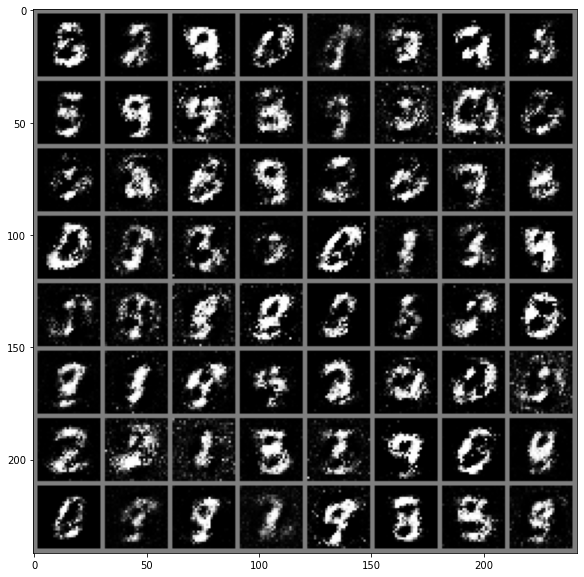

[Epoch 7/200] [Batch 478/937] [D loss: 0.565169] [G loss: 0.856947]
[Epoch 7/200] [Batch 578/937] [D loss: 0.525265] [G loss: 0.915940]
[Epoch 7/200] [Batch 678/937] [D loss: 0.638152] [G loss: 0.969637]
[Epoch 7/200] [Batch 778/937] [D loss: 0.534303] [G loss: 1.024561]
[Epoch 7/200] [Batch 878/937] [D loss: 0.555282] [G loss: 0.843177]
[Epoch 8/200] [Batch 41/937] [D loss: 0.626780] [G loss: 0.879308]
[Epoch 8/200] [Batch 141/937] [D loss: 0.538184] [G loss: 1.278861]
[Epoch 8/200] [Batch 241/937] [D loss: 0.529486] [G loss: 1.204785]
[Epoch 8/200] [Batch 341/937] [D loss: 0.555730] [G loss: 0.844989]
[Epoch 8/200] [Batch 441/937] [D loss: 0.539264] [G loss: 0.969060]
[Epoch 8/200] [Batch 541/937] [D loss: 0.539872] [G loss: 1.075602]
[Epoch 8/200] [Batch 641/937] [D loss: 0.615081] [G loss: 1.179261]
[Epoch 8/200] [Batch 741/937] [D loss: 0.569388] [G loss: 1.049314]
[Epoch 8/200] [Batch 841/937] [D loss: 0.527122] [G loss: 1.154977]
[Epoch 9/200] [Batch 4/937] [D loss: 0.557809] [G

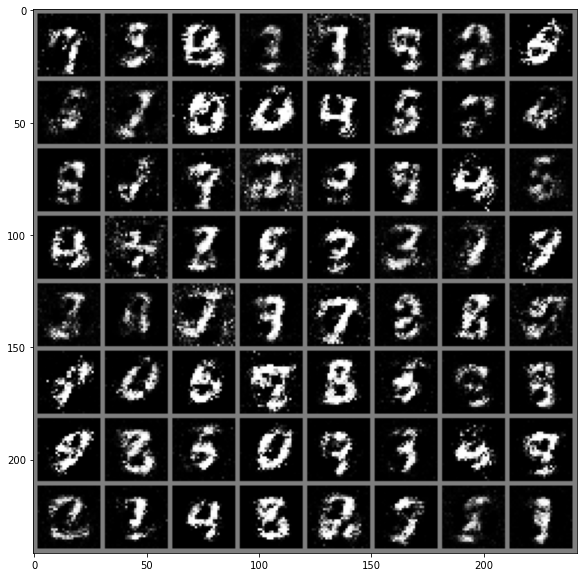

[Epoch 9/200] [Batch 604/937] [D loss: 0.576261] [G loss: 1.218540]
[Epoch 9/200] [Batch 704/937] [D loss: 0.525229] [G loss: 0.872067]
[Epoch 9/200] [Batch 804/937] [D loss: 0.529879] [G loss: 1.409079]
[Epoch 9/200] [Batch 904/937] [D loss: 0.544447] [G loss: 0.850688]
[Epoch 10/200] [Batch 67/937] [D loss: 0.633447] [G loss: 1.310633]
[Epoch 10/200] [Batch 167/937] [D loss: 0.636911] [G loss: 0.742019]
[Epoch 10/200] [Batch 267/937] [D loss: 0.573076] [G loss: 1.041448]
[Epoch 10/200] [Batch 367/937] [D loss: 0.518923] [G loss: 1.263562]
[Epoch 10/200] [Batch 467/937] [D loss: 0.594820] [G loss: 1.115120]
[Epoch 10/200] [Batch 567/937] [D loss: 0.610281] [G loss: 0.973851]
[Epoch 10/200] [Batch 667/937] [D loss: 0.531519] [G loss: 1.369286]
[Epoch 10/200] [Batch 767/937] [D loss: 0.580783] [G loss: 1.215998]
[Epoch 10/200] [Batch 867/937] [D loss: 0.496632] [G loss: 1.007729]
[Epoch 11/200] [Batch 30/937] [D loss: 0.577116] [G loss: 1.434381]
[Epoch 11/200] [Batch 130/937] [D loss: 

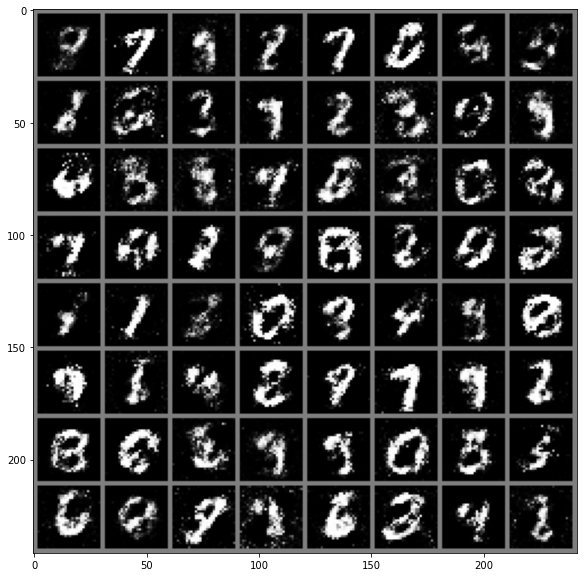

[Epoch 11/200] [Batch 730/937] [D loss: 0.619193] [G loss: 1.051210]
[Epoch 11/200] [Batch 830/937] [D loss: 0.534229] [G loss: 1.166951]
[Epoch 11/200] [Batch 930/937] [D loss: 0.584703] [G loss: 0.937280]
[Epoch 12/200] [Batch 93/937] [D loss: 0.600785] [G loss: 0.793555]
[Epoch 12/200] [Batch 193/937] [D loss: 0.597672] [G loss: 0.839841]
[Epoch 12/200] [Batch 293/937] [D loss: 0.584289] [G loss: 0.938721]
[Epoch 12/200] [Batch 393/937] [D loss: 0.611108] [G loss: 0.973638]
[Epoch 12/200] [Batch 493/937] [D loss: 0.617175] [G loss: 0.814933]
[Epoch 12/200] [Batch 593/937] [D loss: 0.573145] [G loss: 0.925097]
[Epoch 12/200] [Batch 693/937] [D loss: 0.591833] [G loss: 0.983268]
[Epoch 12/200] [Batch 793/937] [D loss: 0.594908] [G loss: 0.964232]
[Epoch 12/200] [Batch 893/937] [D loss: 0.594141] [G loss: 0.857786]
[Epoch 13/200] [Batch 56/937] [D loss: 0.632974] [G loss: 1.091625]
[Epoch 13/200] [Batch 156/937] [D loss: 0.645235] [G loss: 0.986471]
[Epoch 13/200] [Batch 256/937] [D lo

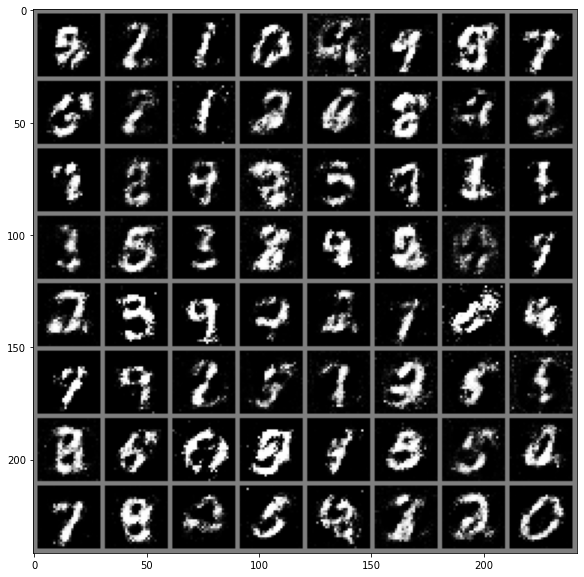

[Epoch 13/200] [Batch 856/937] [D loss: 0.635153] [G loss: 1.090873]
[Epoch 14/200] [Batch 19/937] [D loss: 0.560484] [G loss: 0.908418]
[Epoch 14/200] [Batch 119/937] [D loss: 0.653876] [G loss: 0.813849]
[Epoch 14/200] [Batch 219/937] [D loss: 0.596363] [G loss: 0.752717]
[Epoch 14/200] [Batch 319/937] [D loss: 0.616689] [G loss: 0.927206]
[Epoch 14/200] [Batch 419/937] [D loss: 0.567303] [G loss: 0.890087]
[Epoch 14/200] [Batch 519/937] [D loss: 0.616852] [G loss: 0.816831]
[Epoch 14/200] [Batch 619/937] [D loss: 0.685610] [G loss: 0.874515]
[Epoch 14/200] [Batch 719/937] [D loss: 0.619309] [G loss: 0.809604]
[Epoch 14/200] [Batch 819/937] [D loss: 0.639377] [G loss: 0.997723]
[Epoch 14/200] [Batch 919/937] [D loss: 0.645633] [G loss: 0.922942]
[Epoch 15/200] [Batch 82/937] [D loss: 0.556720] [G loss: 0.754458]
[Epoch 15/200] [Batch 182/937] [D loss: 0.649652] [G loss: 0.903703]
[Epoch 15/200] [Batch 282/937] [D loss: 0.666148] [G loss: 0.883250]
[Epoch 15/200] [Batch 382/937] [D lo

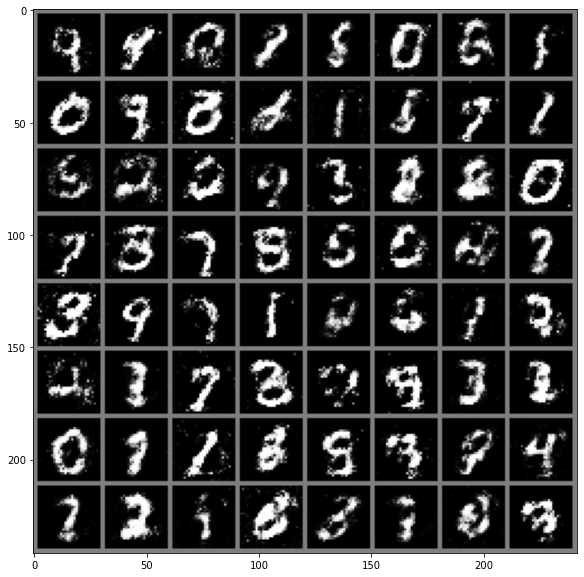

[Epoch 16/200] [Batch 45/937] [D loss: 0.646952] [G loss: 0.843179]
[Epoch 16/200] [Batch 145/937] [D loss: 0.647749] [G loss: 0.907446]
[Epoch 16/200] [Batch 245/937] [D loss: 0.624609] [G loss: 0.953675]
[Epoch 16/200] [Batch 345/937] [D loss: 0.637450] [G loss: 0.922289]
[Epoch 16/200] [Batch 445/937] [D loss: 0.651356] [G loss: 0.960296]
[Epoch 16/200] [Batch 545/937] [D loss: 0.624067] [G loss: 0.784335]
[Epoch 16/200] [Batch 645/937] [D loss: 0.587983] [G loss: 0.893219]
[Epoch 16/200] [Batch 745/937] [D loss: 0.652337] [G loss: 0.796155]
[Epoch 16/200] [Batch 845/937] [D loss: 0.597725] [G loss: 0.848218]
[Epoch 17/200] [Batch 8/937] [D loss: 0.583919] [G loss: 0.920181]
[Epoch 17/200] [Batch 108/937] [D loss: 0.642486] [G loss: 0.989316]
[Epoch 17/200] [Batch 208/937] [D loss: 0.643499] [G loss: 0.879464]
[Epoch 17/200] [Batch 308/937] [D loss: 0.595668] [G loss: 0.913767]
[Epoch 17/200] [Batch 408/937] [D loss: 0.615800] [G loss: 0.935657]
[Epoch 17/200] [Batch 508/937] [D los

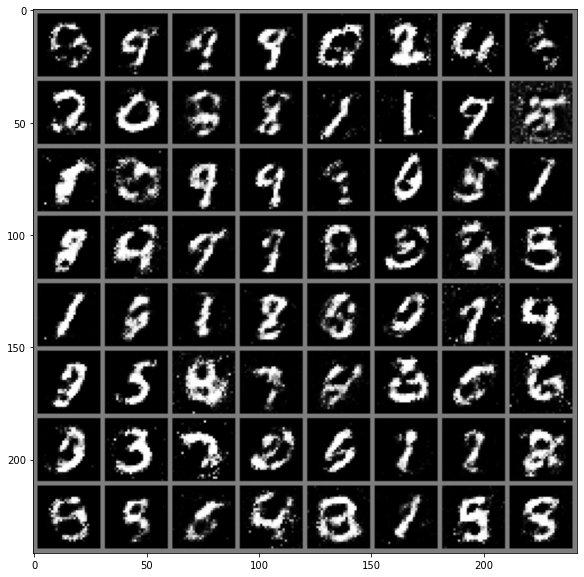

[Epoch 18/200] [Batch 171/937] [D loss: 0.618965] [G loss: 0.879182]
[Epoch 18/200] [Batch 271/937] [D loss: 0.649421] [G loss: 0.921392]
[Epoch 18/200] [Batch 371/937] [D loss: 0.619762] [G loss: 0.875936]
[Epoch 18/200] [Batch 471/937] [D loss: 0.635526] [G loss: 0.963003]
[Epoch 18/200] [Batch 571/937] [D loss: 0.623788] [G loss: 0.871489]
[Epoch 18/200] [Batch 671/937] [D loss: 0.683761] [G loss: 0.789964]
[Epoch 18/200] [Batch 771/937] [D loss: 0.678275] [G loss: 0.771113]
[Epoch 18/200] [Batch 871/937] [D loss: 0.608085] [G loss: 0.829912]
[Epoch 19/200] [Batch 34/937] [D loss: 0.626146] [G loss: 1.007308]
[Epoch 19/200] [Batch 134/937] [D loss: 0.610073] [G loss: 0.759205]
[Epoch 19/200] [Batch 234/937] [D loss: 0.713160] [G loss: 0.963727]
[Epoch 19/200] [Batch 334/937] [D loss: 0.657066] [G loss: 0.788020]
[Epoch 19/200] [Batch 434/937] [D loss: 0.648609] [G loss: 0.854714]
[Epoch 19/200] [Batch 534/937] [D loss: 0.627482] [G loss: 0.859502]
[Epoch 19/200] [Batch 634/937] [D l

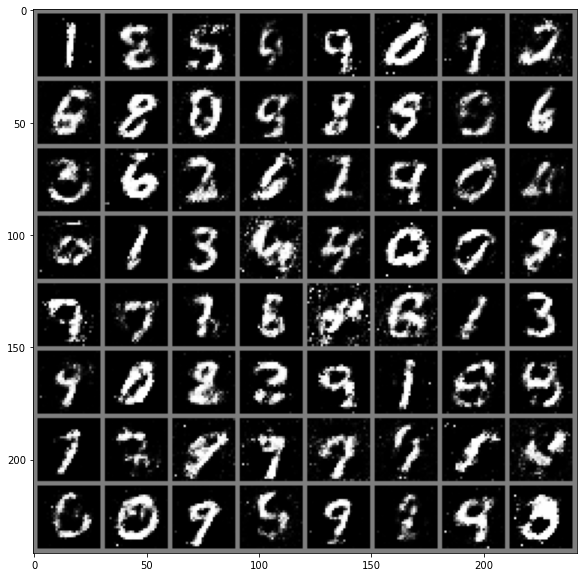

[Epoch 20/200] [Batch 297/937] [D loss: 0.643377] [G loss: 0.822584]
[Epoch 20/200] [Batch 397/937] [D loss: 0.642249] [G loss: 0.875432]
[Epoch 20/200] [Batch 497/937] [D loss: 0.664755] [G loss: 0.873319]
[Epoch 20/200] [Batch 597/937] [D loss: 0.639786] [G loss: 0.843526]
[Epoch 20/200] [Batch 697/937] [D loss: 0.667472] [G loss: 1.043323]
[Epoch 20/200] [Batch 797/937] [D loss: 0.662224] [G loss: 0.793582]
[Epoch 20/200] [Batch 897/937] [D loss: 0.658632] [G loss: 0.800438]
[Epoch 21/200] [Batch 60/937] [D loss: 0.614742] [G loss: 0.870042]
[Epoch 21/200] [Batch 160/937] [D loss: 0.645954] [G loss: 0.801496]
[Epoch 21/200] [Batch 260/937] [D loss: 0.687685] [G loss: 0.943634]
[Epoch 21/200] [Batch 360/937] [D loss: 0.621951] [G loss: 0.830790]
[Epoch 21/200] [Batch 460/937] [D loss: 0.626817] [G loss: 0.857909]
[Epoch 21/200] [Batch 560/937] [D loss: 0.674469] [G loss: 0.739249]
[Epoch 21/200] [Batch 660/937] [D loss: 0.639334] [G loss: 0.799204]
[Epoch 21/200] [Batch 760/937] [D l

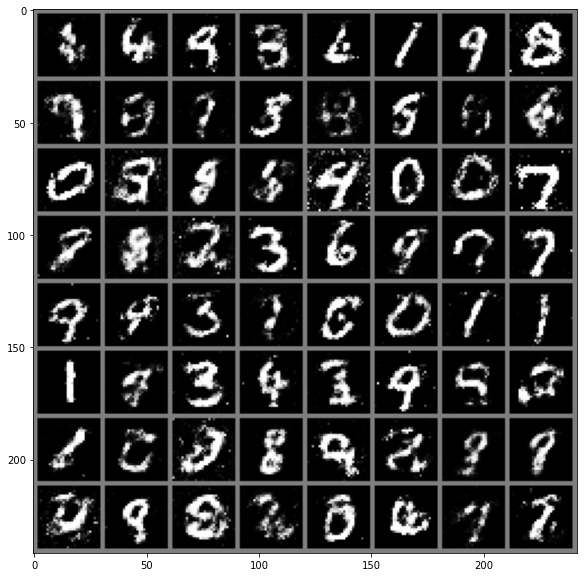

[Epoch 22/200] [Batch 423/937] [D loss: 0.665597] [G loss: 0.907852]
[Epoch 22/200] [Batch 523/937] [D loss: 0.675372] [G loss: 0.770784]
[Epoch 22/200] [Batch 623/937] [D loss: 0.647876] [G loss: 0.867155]
[Epoch 22/200] [Batch 723/937] [D loss: 0.676533] [G loss: 0.846707]
[Epoch 22/200] [Batch 823/937] [D loss: 0.647252] [G loss: 0.941129]
[Epoch 22/200] [Batch 923/937] [D loss: 0.667179] [G loss: 0.801556]
[Epoch 23/200] [Batch 86/937] [D loss: 0.670646] [G loss: 0.832944]
[Epoch 23/200] [Batch 186/937] [D loss: 0.660418] [G loss: 0.891097]
[Epoch 23/200] [Batch 286/937] [D loss: 0.645163] [G loss: 0.766399]
[Epoch 23/200] [Batch 386/937] [D loss: 0.661531] [G loss: 0.697324]
[Epoch 23/200] [Batch 486/937] [D loss: 0.688832] [G loss: 0.714605]
[Epoch 23/200] [Batch 586/937] [D loss: 0.647510] [G loss: 0.866062]
[Epoch 23/200] [Batch 686/937] [D loss: 0.635021] [G loss: 0.766303]
[Epoch 23/200] [Batch 786/937] [D loss: 0.664607] [G loss: 0.800540]
[Epoch 23/200] [Batch 886/937] [D l

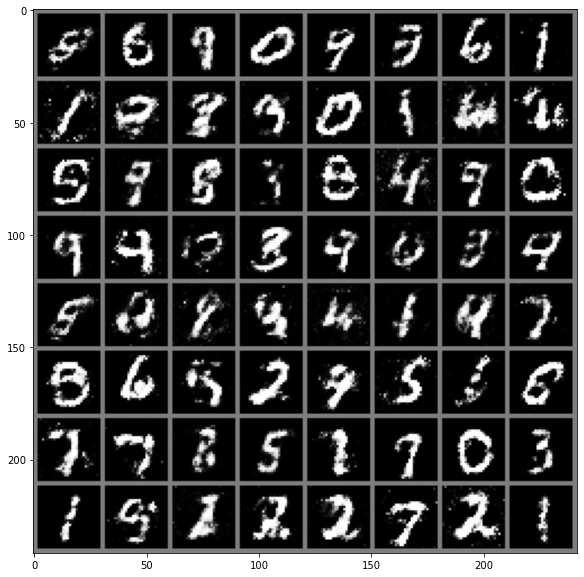

[Epoch 24/200] [Batch 549/937] [D loss: 0.660393] [G loss: 0.823987]
[Epoch 24/200] [Batch 649/937] [D loss: 0.685432] [G loss: 0.881187]
[Epoch 24/200] [Batch 749/937] [D loss: 0.634925] [G loss: 0.952652]
[Epoch 24/200] [Batch 849/937] [D loss: 0.627741] [G loss: 0.784833]
[Epoch 25/200] [Batch 12/937] [D loss: 0.630057] [G loss: 0.751345]
[Epoch 25/200] [Batch 112/937] [D loss: 0.655749] [G loss: 0.764779]
[Epoch 25/200] [Batch 212/937] [D loss: 0.657818] [G loss: 0.844940]
[Epoch 25/200] [Batch 312/937] [D loss: 0.591879] [G loss: 0.894305]
[Epoch 25/200] [Batch 412/937] [D loss: 0.643011] [G loss: 0.742589]
[Epoch 25/200] [Batch 512/937] [D loss: 0.620659] [G loss: 0.811273]
[Epoch 25/200] [Batch 612/937] [D loss: 0.663952] [G loss: 0.765713]
[Epoch 25/200] [Batch 712/937] [D loss: 0.629194] [G loss: 0.771989]
[Epoch 25/200] [Batch 812/937] [D loss: 0.687602] [G loss: 0.915607]
[Epoch 25/200] [Batch 912/937] [D loss: 0.640913] [G loss: 0.832586]
[Epoch 26/200] [Batch 75/937] [D lo

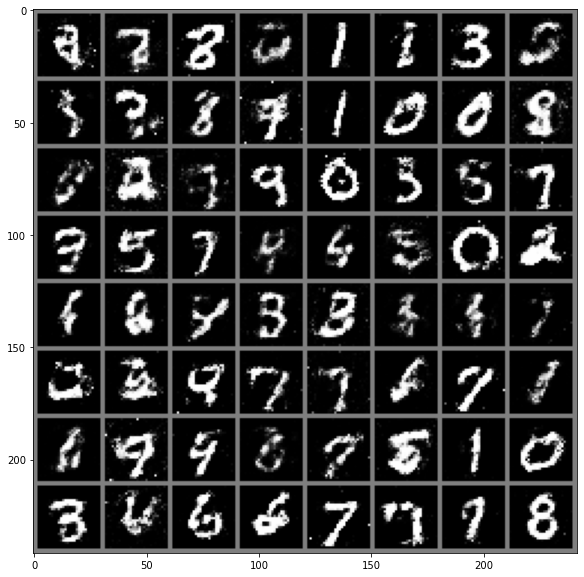

[Epoch 26/200] [Batch 675/937] [D loss: 0.669992] [G loss: 0.784892]
[Epoch 26/200] [Batch 775/937] [D loss: 0.625338] [G loss: 0.841080]
[Epoch 26/200] [Batch 875/937] [D loss: 0.690511] [G loss: 0.794587]
[Epoch 27/200] [Batch 38/937] [D loss: 0.681854] [G loss: 0.834784]
[Epoch 27/200] [Batch 138/937] [D loss: 0.655269] [G loss: 0.816064]
[Epoch 27/200] [Batch 238/937] [D loss: 0.634914] [G loss: 0.818531]
[Epoch 27/200] [Batch 338/937] [D loss: 0.700339] [G loss: 0.793404]
[Epoch 27/200] [Batch 438/937] [D loss: 0.705098] [G loss: 0.699372]
[Epoch 27/200] [Batch 538/937] [D loss: 0.672752] [G loss: 0.867379]
[Epoch 27/200] [Batch 638/937] [D loss: 0.667400] [G loss: 0.786858]
[Epoch 27/200] [Batch 738/937] [D loss: 0.663329] [G loss: 0.828924]
[Epoch 27/200] [Batch 838/937] [D loss: 0.644949] [G loss: 0.837711]
[Epoch 28/200] [Batch 1/937] [D loss: 0.672246] [G loss: 0.753659]
[Epoch 28/200] [Batch 101/937] [D loss: 0.656297] [G loss: 0.841346]
[Epoch 28/200] [Batch 201/937] [D los

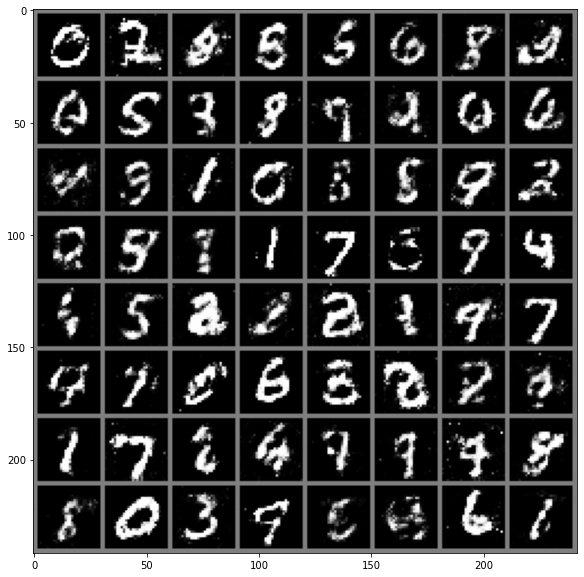

[Epoch 28/200] [Batch 801/937] [D loss: 0.650930] [G loss: 0.923707]
[Epoch 28/200] [Batch 901/937] [D loss: 0.650994] [G loss: 0.816983]
[Epoch 29/200] [Batch 64/937] [D loss: 0.634527] [G loss: 0.879556]
[Epoch 29/200] [Batch 164/937] [D loss: 0.648965] [G loss: 0.701244]
[Epoch 29/200] [Batch 264/937] [D loss: 0.638066] [G loss: 0.827741]
[Epoch 29/200] [Batch 364/937] [D loss: 0.662957] [G loss: 0.739129]
[Epoch 29/200] [Batch 464/937] [D loss: 0.662796] [G loss: 0.834009]
[Epoch 29/200] [Batch 564/937] [D loss: 0.610713] [G loss: 0.884622]
[Epoch 29/200] [Batch 664/937] [D loss: 0.664170] [G loss: 0.871646]
[Epoch 29/200] [Batch 764/937] [D loss: 0.599340] [G loss: 0.870272]
[Epoch 29/200] [Batch 864/937] [D loss: 0.693643] [G loss: 0.788327]
[Epoch 30/200] [Batch 27/937] [D loss: 0.679154] [G loss: 0.808188]
[Epoch 30/200] [Batch 127/937] [D loss: 0.722775] [G loss: 0.668610]
[Epoch 30/200] [Batch 227/937] [D loss: 0.647396] [G loss: 0.884199]
[Epoch 30/200] [Batch 327/937] [D lo

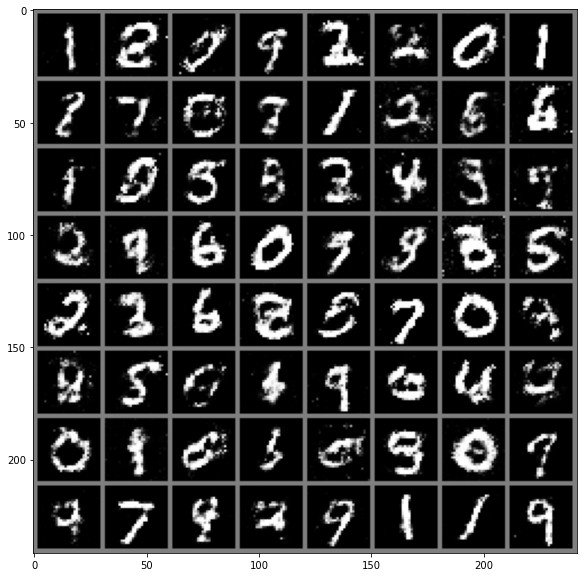

[Epoch 30/200] [Batch 927/937] [D loss: 0.637500] [G loss: 0.857827]
[Epoch 31/200] [Batch 90/937] [D loss: 0.675244] [G loss: 0.782344]
[Epoch 31/200] [Batch 190/937] [D loss: 0.645064] [G loss: 0.809285]
[Epoch 31/200] [Batch 290/937] [D loss: 0.676834] [G loss: 0.807299]
[Epoch 31/200] [Batch 390/937] [D loss: 0.635847] [G loss: 0.825430]
[Epoch 31/200] [Batch 490/937] [D loss: 0.672478] [G loss: 0.820519]
[Epoch 31/200] [Batch 590/937] [D loss: 0.659929] [G loss: 0.762168]
[Epoch 31/200] [Batch 690/937] [D loss: 0.665418] [G loss: 0.779168]
[Epoch 31/200] [Batch 790/937] [D loss: 0.666564] [G loss: 0.753605]
[Epoch 31/200] [Batch 890/937] [D loss: 0.662885] [G loss: 0.846334]
[Epoch 32/200] [Batch 53/937] [D loss: 0.623402] [G loss: 0.784794]
[Epoch 32/200] [Batch 153/937] [D loss: 0.648096] [G loss: 0.810579]
[Epoch 32/200] [Batch 253/937] [D loss: 0.674040] [G loss: 0.845252]
[Epoch 32/200] [Batch 353/937] [D loss: 0.665708] [G loss: 0.803646]
[Epoch 32/200] [Batch 453/937] [D lo

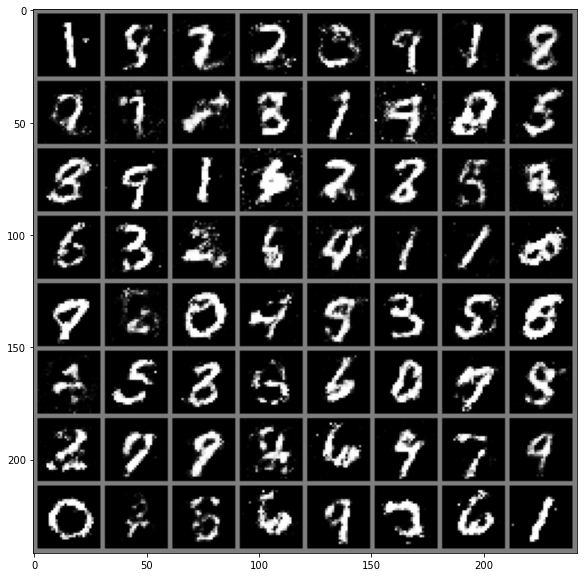

[Epoch 33/200] [Batch 116/937] [D loss: 0.658441] [G loss: 0.859617]
[Epoch 33/200] [Batch 216/937] [D loss: 0.649438] [G loss: 0.714404]
[Epoch 33/200] [Batch 316/937] [D loss: 0.633592] [G loss: 0.813772]
[Epoch 33/200] [Batch 416/937] [D loss: 0.646809] [G loss: 0.822245]
[Epoch 33/200] [Batch 516/937] [D loss: 0.671756] [G loss: 0.771402]
[Epoch 33/200] [Batch 616/937] [D loss: 0.648104] [G loss: 0.778396]
[Epoch 33/200] [Batch 716/937] [D loss: 0.665184] [G loss: 0.804066]
[Epoch 33/200] [Batch 816/937] [D loss: 0.656215] [G loss: 0.751075]
[Epoch 33/200] [Batch 916/937] [D loss: 0.629892] [G loss: 0.867958]
[Epoch 34/200] [Batch 79/937] [D loss: 0.702258] [G loss: 0.838553]
[Epoch 34/200] [Batch 179/937] [D loss: 0.645535] [G loss: 0.835905]
[Epoch 34/200] [Batch 279/937] [D loss: 0.627193] [G loss: 0.779945]
[Epoch 34/200] [Batch 379/937] [D loss: 0.658119] [G loss: 0.655129]
[Epoch 34/200] [Batch 479/937] [D loss: 0.652130] [G loss: 0.817917]
[Epoch 34/200] [Batch 579/937] [D l

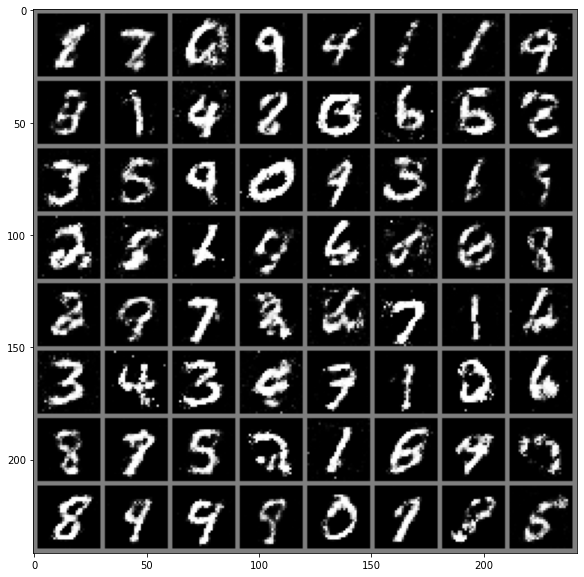

[Epoch 35/200] [Batch 242/937] [D loss: 0.686534] [G loss: 0.789658]
[Epoch 35/200] [Batch 342/937] [D loss: 0.677188] [G loss: 0.805021]
[Epoch 35/200] [Batch 442/937] [D loss: 0.666815] [G loss: 0.794995]
[Epoch 35/200] [Batch 542/937] [D loss: 0.688179] [G loss: 0.824552]
[Epoch 35/200] [Batch 642/937] [D loss: 0.643320] [G loss: 0.769887]
[Epoch 35/200] [Batch 742/937] [D loss: 0.671742] [G loss: 0.781106]
[Epoch 35/200] [Batch 842/937] [D loss: 0.644216] [G loss: 0.803221]
[Epoch 36/200] [Batch 5/937] [D loss: 0.691515] [G loss: 0.663390]
[Epoch 36/200] [Batch 105/937] [D loss: 0.670359] [G loss: 0.847703]
[Epoch 36/200] [Batch 205/937] [D loss: 0.665944] [G loss: 0.750306]
[Epoch 36/200] [Batch 305/937] [D loss: 0.625630] [G loss: 0.798766]
[Epoch 36/200] [Batch 405/937] [D loss: 0.677701] [G loss: 0.852871]
[Epoch 36/200] [Batch 505/937] [D loss: 0.683985] [G loss: 0.814726]
[Epoch 36/200] [Batch 605/937] [D loss: 0.675189] [G loss: 0.955467]
[Epoch 36/200] [Batch 705/937] [D lo

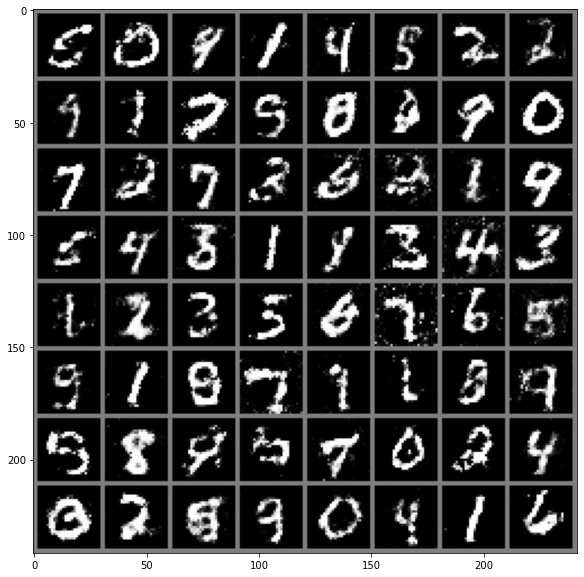

[Epoch 37/200] [Batch 368/937] [D loss: 0.660835] [G loss: 0.790056]
[Epoch 37/200] [Batch 468/937] [D loss: 0.647895] [G loss: 0.801651]
[Epoch 37/200] [Batch 568/937] [D loss: 0.645151] [G loss: 0.764353]
[Epoch 37/200] [Batch 668/937] [D loss: 0.674063] [G loss: 0.795237]
[Epoch 37/200] [Batch 768/937] [D loss: 0.646701] [G loss: 0.784732]
[Epoch 37/200] [Batch 868/937] [D loss: 0.667385] [G loss: 0.783782]
[Epoch 38/200] [Batch 31/937] [D loss: 0.674209] [G loss: 0.780085]
[Epoch 38/200] [Batch 131/937] [D loss: 0.657169] [G loss: 0.793820]
[Epoch 38/200] [Batch 231/937] [D loss: 0.615603] [G loss: 0.801718]
[Epoch 38/200] [Batch 331/937] [D loss: 0.685728] [G loss: 0.771628]
[Epoch 38/200] [Batch 431/937] [D loss: 0.638222] [G loss: 0.748230]
[Epoch 38/200] [Batch 531/937] [D loss: 0.679390] [G loss: 0.751792]
[Epoch 38/200] [Batch 631/937] [D loss: 0.642466] [G loss: 0.724782]
[Epoch 38/200] [Batch 731/937] [D loss: 0.665313] [G loss: 0.835139]
[Epoch 38/200] [Batch 831/937] [D l

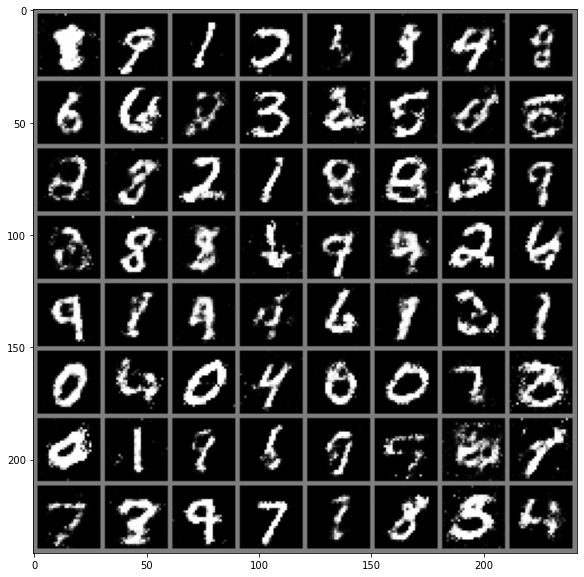

[Epoch 39/200] [Batch 494/937] [D loss: 0.652243] [G loss: 0.833361]
[Epoch 39/200] [Batch 594/937] [D loss: 0.697110] [G loss: 0.923496]
[Epoch 39/200] [Batch 694/937] [D loss: 0.622098] [G loss: 0.798895]
[Epoch 39/200] [Batch 794/937] [D loss: 0.704958] [G loss: 0.913331]
[Epoch 39/200] [Batch 894/937] [D loss: 0.652814] [G loss: 0.910987]
[Epoch 40/200] [Batch 57/937] [D loss: 0.639952] [G loss: 0.814517]
[Epoch 40/200] [Batch 157/937] [D loss: 0.641753] [G loss: 0.830530]
[Epoch 40/200] [Batch 257/937] [D loss: 0.629161] [G loss: 0.872896]
[Epoch 40/200] [Batch 357/937] [D loss: 0.684031] [G loss: 0.747699]
[Epoch 40/200] [Batch 457/937] [D loss: 0.620746] [G loss: 0.795327]
[Epoch 40/200] [Batch 557/937] [D loss: 0.613278] [G loss: 0.888660]
[Epoch 40/200] [Batch 657/937] [D loss: 0.659927] [G loss: 0.855277]
[Epoch 40/200] [Batch 757/937] [D loss: 0.680923] [G loss: 0.849377]
[Epoch 40/200] [Batch 857/937] [D loss: 0.650676] [G loss: 0.790062]
[Epoch 41/200] [Batch 20/937] [D lo

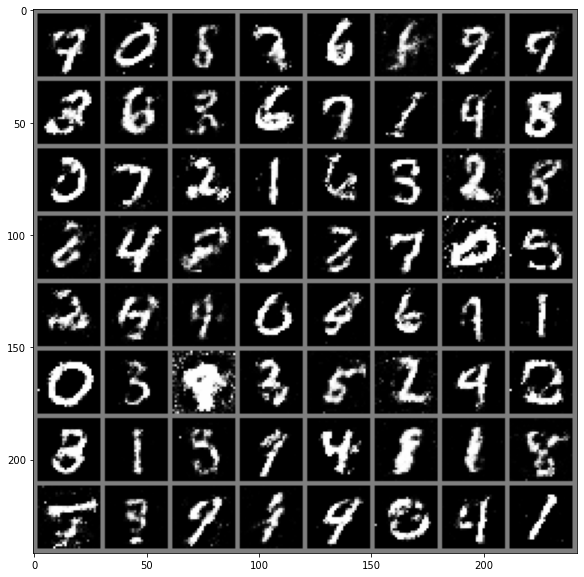

[Epoch 41/200] [Batch 620/937] [D loss: 0.676231] [G loss: 0.875336]
[Epoch 41/200] [Batch 720/937] [D loss: 0.625029] [G loss: 0.875568]
[Epoch 41/200] [Batch 820/937] [D loss: 0.675754] [G loss: 0.897838]
[Epoch 41/200] [Batch 920/937] [D loss: 0.709772] [G loss: 0.689791]
[Epoch 42/200] [Batch 83/937] [D loss: 0.650677] [G loss: 0.705129]
[Epoch 42/200] [Batch 183/937] [D loss: 0.651762] [G loss: 0.759167]
[Epoch 42/200] [Batch 283/937] [D loss: 0.647976] [G loss: 0.815156]
[Epoch 42/200] [Batch 383/937] [D loss: 0.681633] [G loss: 0.881501]
[Epoch 42/200] [Batch 483/937] [D loss: 0.607880] [G loss: 0.858199]
[Epoch 42/200] [Batch 583/937] [D loss: 0.628166] [G loss: 0.797033]
[Epoch 42/200] [Batch 683/937] [D loss: 0.679035] [G loss: 0.767175]
[Epoch 42/200] [Batch 783/937] [D loss: 0.611336] [G loss: 0.859154]
[Epoch 42/200] [Batch 883/937] [D loss: 0.687506] [G loss: 0.885112]
[Epoch 43/200] [Batch 46/937] [D loss: 0.657578] [G loss: 0.839077]
[Epoch 43/200] [Batch 146/937] [D lo

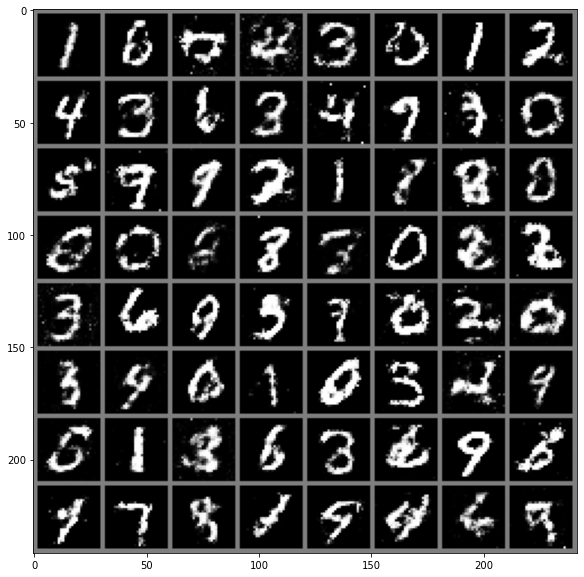

[Epoch 43/200] [Batch 746/937] [D loss: 0.617725] [G loss: 0.831641]
[Epoch 43/200] [Batch 846/937] [D loss: 0.644045] [G loss: 0.835005]
[Epoch 44/200] [Batch 9/937] [D loss: 0.662075] [G loss: 0.782943]
[Epoch 44/200] [Batch 109/937] [D loss: 0.607304] [G loss: 0.724228]
[Epoch 44/200] [Batch 209/937] [D loss: 0.682491] [G loss: 0.732241]
[Epoch 44/200] [Batch 309/937] [D loss: 0.638749] [G loss: 0.784495]
[Epoch 44/200] [Batch 409/937] [D loss: 0.678922] [G loss: 0.790910]
[Epoch 44/200] [Batch 509/937] [D loss: 0.638456] [G loss: 0.858580]
[Epoch 44/200] [Batch 609/937] [D loss: 0.674596] [G loss: 0.802595]
[Epoch 44/200] [Batch 709/937] [D loss: 0.633335] [G loss: 0.837619]
[Epoch 44/200] [Batch 809/937] [D loss: 0.654839] [G loss: 0.772385]
[Epoch 44/200] [Batch 909/937] [D loss: 0.643950] [G loss: 0.866154]
[Epoch 45/200] [Batch 72/937] [D loss: 0.646453] [G loss: 0.768568]
[Epoch 45/200] [Batch 172/937] [D loss: 0.659810] [G loss: 0.880528]
[Epoch 45/200] [Batch 272/937] [D los

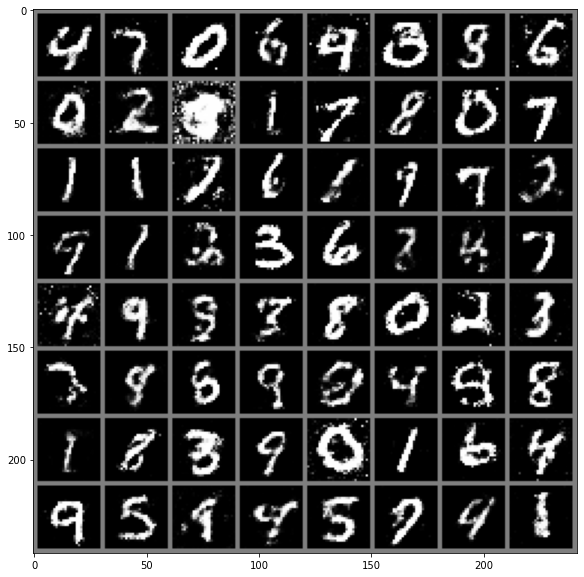

[Epoch 45/200] [Batch 872/937] [D loss: 0.668430] [G loss: 0.842321]
[Epoch 46/200] [Batch 35/937] [D loss: 0.649993] [G loss: 0.733745]
[Epoch 46/200] [Batch 135/937] [D loss: 0.625723] [G loss: 0.762516]
[Epoch 46/200] [Batch 235/937] [D loss: 0.660067] [G loss: 0.842250]
[Epoch 46/200] [Batch 335/937] [D loss: 0.632150] [G loss: 0.878036]
[Epoch 46/200] [Batch 435/937] [D loss: 0.663901] [G loss: 0.767024]
[Epoch 46/200] [Batch 535/937] [D loss: 0.609374] [G loss: 0.804494]
[Epoch 46/200] [Batch 635/937] [D loss: 0.628382] [G loss: 0.758581]
[Epoch 46/200] [Batch 735/937] [D loss: 0.673983] [G loss: 0.763410]
[Epoch 46/200] [Batch 835/937] [D loss: 0.635625] [G loss: 0.912905]
[Epoch 46/200] [Batch 935/937] [D loss: 0.691582] [G loss: 0.727914]
[Epoch 47/200] [Batch 98/937] [D loss: 0.638997] [G loss: 0.746975]
[Epoch 47/200] [Batch 198/937] [D loss: 0.634195] [G loss: 0.826377]
[Epoch 47/200] [Batch 298/937] [D loss: 0.638247] [G loss: 0.838003]
[Epoch 47/200] [Batch 398/937] [D lo

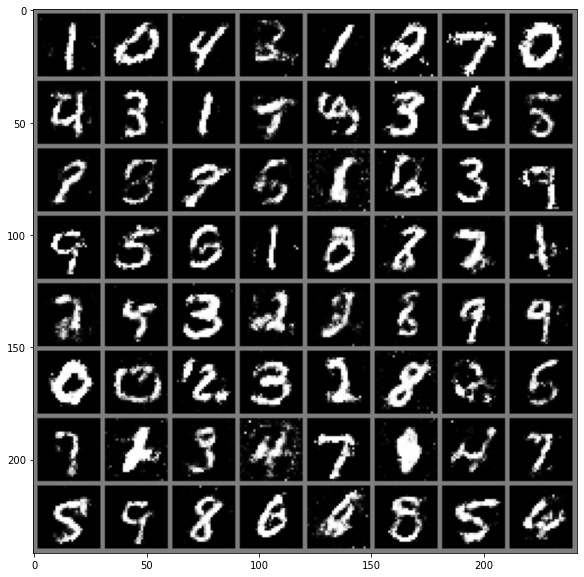

[Epoch 48/200] [Batch 61/937] [D loss: 0.660630] [G loss: 0.901781]
[Epoch 48/200] [Batch 161/937] [D loss: 0.680160] [G loss: 0.828735]
[Epoch 48/200] [Batch 261/937] [D loss: 0.657272] [G loss: 0.790200]
[Epoch 48/200] [Batch 361/937] [D loss: 0.657409] [G loss: 0.914816]
[Epoch 48/200] [Batch 461/937] [D loss: 0.636653] [G loss: 0.821275]
[Epoch 48/200] [Batch 561/937] [D loss: 0.648821] [G loss: 0.806298]
[Epoch 48/200] [Batch 661/937] [D loss: 0.617693] [G loss: 0.940703]
[Epoch 48/200] [Batch 761/937] [D loss: 0.657365] [G loss: 0.772861]
[Epoch 48/200] [Batch 861/937] [D loss: 0.648653] [G loss: 0.837602]
[Epoch 49/200] [Batch 24/937] [D loss: 0.651394] [G loss: 0.862416]
[Epoch 49/200] [Batch 124/937] [D loss: 0.616816] [G loss: 0.790838]
[Epoch 49/200] [Batch 224/937] [D loss: 0.672660] [G loss: 0.849194]
[Epoch 49/200] [Batch 324/937] [D loss: 0.628253] [G loss: 0.874544]
[Epoch 49/200] [Batch 424/937] [D loss: 0.623608] [G loss: 0.928171]
[Epoch 49/200] [Batch 524/937] [D lo

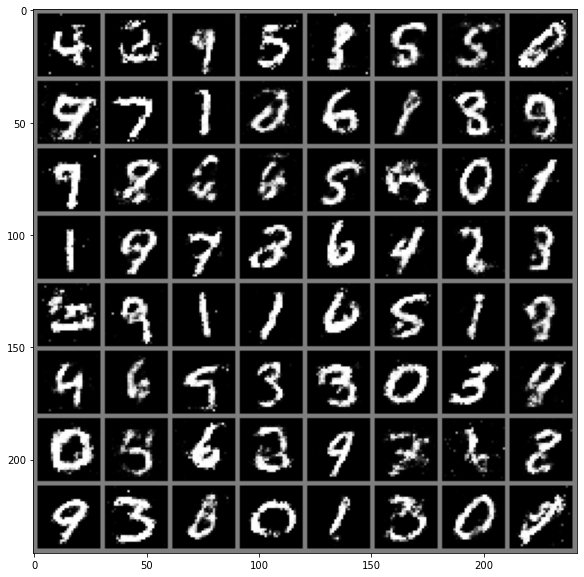

[Epoch 50/200] [Batch 187/937] [D loss: 0.638556] [G loss: 0.866660]
[Epoch 50/200] [Batch 287/937] [D loss: 0.627339] [G loss: 0.804210]
[Epoch 50/200] [Batch 387/937] [D loss: 0.678043] [G loss: 0.820430]
[Epoch 50/200] [Batch 487/937] [D loss: 0.651100] [G loss: 0.755384]
[Epoch 50/200] [Batch 587/937] [D loss: 0.687500] [G loss: 0.798448]
[Epoch 50/200] [Batch 687/937] [D loss: 0.644423] [G loss: 0.807275]
[Epoch 50/200] [Batch 787/937] [D loss: 0.689409] [G loss: 0.787450]
[Epoch 50/200] [Batch 887/937] [D loss: 0.670590] [G loss: 0.767088]
[Epoch 51/200] [Batch 50/937] [D loss: 0.652721] [G loss: 0.888736]
[Epoch 51/200] [Batch 150/937] [D loss: 0.644011] [G loss: 0.772768]
[Epoch 51/200] [Batch 250/937] [D loss: 0.657482] [G loss: 0.809340]
[Epoch 51/200] [Batch 350/937] [D loss: 0.678760] [G loss: 0.820337]
[Epoch 51/200] [Batch 450/937] [D loss: 0.645501] [G loss: 0.759774]
[Epoch 51/200] [Batch 550/937] [D loss: 0.630073] [G loss: 0.803628]
[Epoch 51/200] [Batch 650/937] [D l

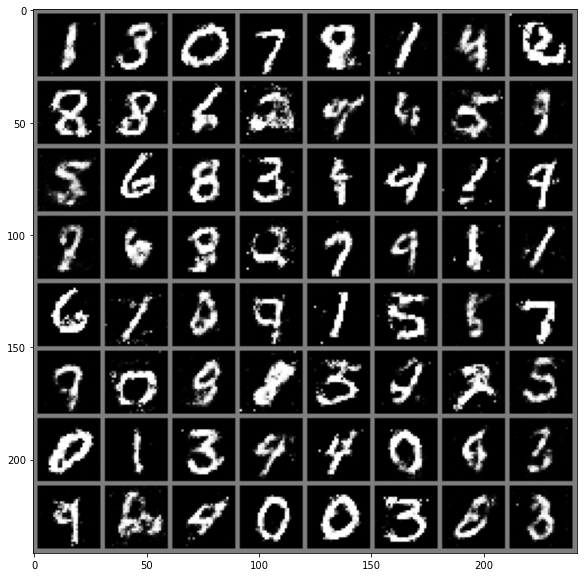

[Epoch 52/200] [Batch 313/937] [D loss: 0.632394] [G loss: 0.756840]
[Epoch 52/200] [Batch 413/937] [D loss: 0.654783] [G loss: 0.734497]
[Epoch 52/200] [Batch 513/937] [D loss: 0.691086] [G loss: 0.825980]
[Epoch 52/200] [Batch 613/937] [D loss: 0.613826] [G loss: 0.820484]
[Epoch 52/200] [Batch 713/937] [D loss: 0.636732] [G loss: 0.913350]
[Epoch 52/200] [Batch 813/937] [D loss: 0.659385] [G loss: 0.779094]
[Epoch 52/200] [Batch 913/937] [D loss: 0.652096] [G loss: 0.792858]
[Epoch 53/200] [Batch 76/937] [D loss: 0.666748] [G loss: 0.711618]
[Epoch 53/200] [Batch 176/937] [D loss: 0.605988] [G loss: 0.823760]
[Epoch 53/200] [Batch 276/937] [D loss: 0.651274] [G loss: 0.905510]
[Epoch 53/200] [Batch 376/937] [D loss: 0.657342] [G loss: 0.818031]
[Epoch 53/200] [Batch 476/937] [D loss: 0.663906] [G loss: 0.777285]
[Epoch 53/200] [Batch 576/937] [D loss: 0.675258] [G loss: 0.785555]
[Epoch 53/200] [Batch 676/937] [D loss: 0.670214] [G loss: 0.755204]
[Epoch 53/200] [Batch 776/937] [D l

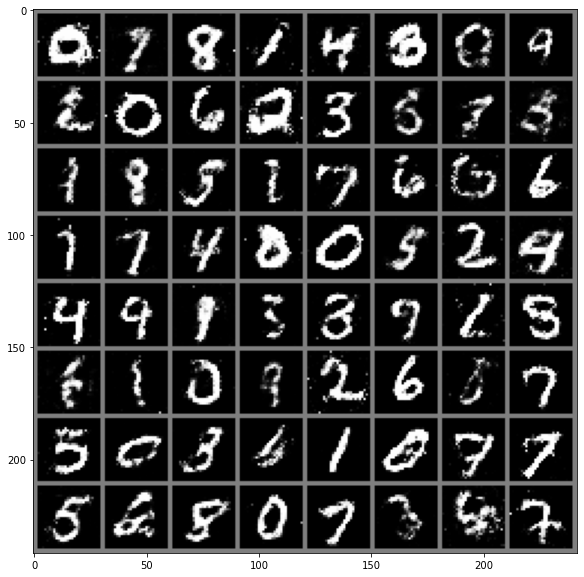

[Epoch 54/200] [Batch 439/937] [D loss: 0.679790] [G loss: 0.768148]
[Epoch 54/200] [Batch 539/937] [D loss: 0.654393] [G loss: 0.780486]
[Epoch 54/200] [Batch 639/937] [D loss: 0.661205] [G loss: 0.859052]
[Epoch 54/200] [Batch 739/937] [D loss: 0.662837] [G loss: 0.910071]
[Epoch 54/200] [Batch 839/937] [D loss: 0.673607] [G loss: 0.764842]
[Epoch 55/200] [Batch 2/937] [D loss: 0.666220] [G loss: 0.808515]
[Epoch 55/200] [Batch 102/937] [D loss: 0.662594] [G loss: 0.851752]
[Epoch 55/200] [Batch 202/937] [D loss: 0.695168] [G loss: 0.755375]
[Epoch 55/200] [Batch 302/937] [D loss: 0.663318] [G loss: 0.750067]
[Epoch 55/200] [Batch 402/937] [D loss: 0.663995] [G loss: 0.752151]
[Epoch 55/200] [Batch 502/937] [D loss: 0.650048] [G loss: 0.841596]
[Epoch 55/200] [Batch 602/937] [D loss: 0.608385] [G loss: 0.736614]
[Epoch 55/200] [Batch 702/937] [D loss: 0.659271] [G loss: 0.760236]
[Epoch 55/200] [Batch 802/937] [D loss: 0.652915] [G loss: 0.860847]
[Epoch 55/200] [Batch 902/937] [D lo

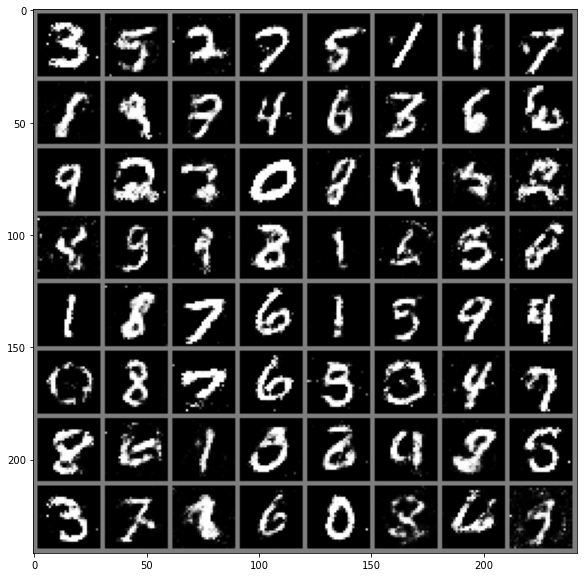

[Epoch 56/200] [Batch 565/937] [D loss: 0.627325] [G loss: 0.792936]
[Epoch 56/200] [Batch 665/937] [D loss: 0.682771] [G loss: 0.909659]
[Epoch 56/200] [Batch 765/937] [D loss: 0.673298] [G loss: 0.849830]
[Epoch 56/200] [Batch 865/937] [D loss: 0.644570] [G loss: 0.838571]
[Epoch 57/200] [Batch 28/937] [D loss: 0.685988] [G loss: 0.734254]
[Epoch 57/200] [Batch 128/937] [D loss: 0.646217] [G loss: 0.866437]
[Epoch 57/200] [Batch 228/937] [D loss: 0.638633] [G loss: 0.789019]
[Epoch 57/200] [Batch 328/937] [D loss: 0.681901] [G loss: 0.839221]
[Epoch 57/200] [Batch 428/937] [D loss: 0.678028] [G loss: 0.823086]
[Epoch 57/200] [Batch 528/937] [D loss: 0.655048] [G loss: 0.758313]
[Epoch 57/200] [Batch 628/937] [D loss: 0.674292] [G loss: 0.749619]
[Epoch 57/200] [Batch 728/937] [D loss: 0.671973] [G loss: 0.801959]
[Epoch 57/200] [Batch 828/937] [D loss: 0.674692] [G loss: 0.804439]
[Epoch 57/200] [Batch 928/937] [D loss: 0.634425] [G loss: 0.882965]
[Epoch 58/200] [Batch 91/937] [D lo

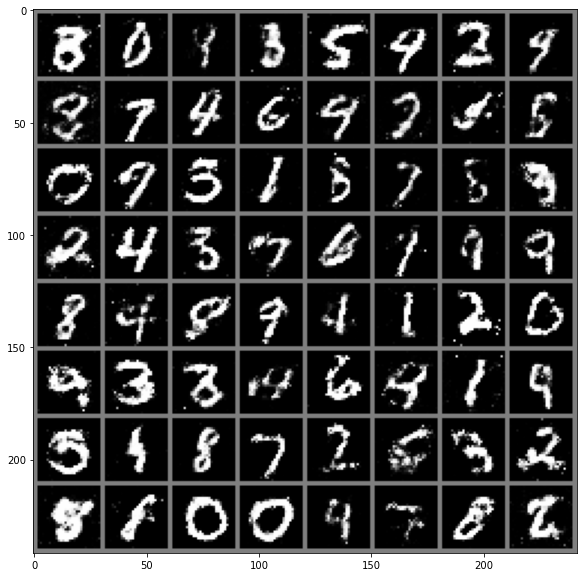

[Epoch 58/200] [Batch 691/937] [D loss: 0.619964] [G loss: 0.796938]
[Epoch 58/200] [Batch 791/937] [D loss: 0.698273] [G loss: 0.797997]
[Epoch 58/200] [Batch 891/937] [D loss: 0.672494] [G loss: 0.856463]
[Epoch 59/200] [Batch 54/937] [D loss: 0.630970] [G loss: 0.912808]
[Epoch 59/200] [Batch 154/937] [D loss: 0.653250] [G loss: 0.837841]
[Epoch 59/200] [Batch 254/937] [D loss: 0.598901] [G loss: 0.808500]
[Epoch 59/200] [Batch 354/937] [D loss: 0.659086] [G loss: 0.877112]
[Epoch 59/200] [Batch 454/937] [D loss: 0.659863] [G loss: 0.811391]
[Epoch 59/200] [Batch 554/937] [D loss: 0.639857] [G loss: 0.948260]
[Epoch 59/200] [Batch 654/937] [D loss: 0.665744] [G loss: 0.794492]
[Epoch 59/200] [Batch 754/937] [D loss: 0.679705] [G loss: 0.796600]
[Epoch 59/200] [Batch 854/937] [D loss: 0.640045] [G loss: 0.836579]
[Epoch 60/200] [Batch 17/937] [D loss: 0.661346] [G loss: 0.865544]
[Epoch 60/200] [Batch 117/937] [D loss: 0.673726] [G loss: 0.776585]
[Epoch 60/200] [Batch 217/937] [D lo

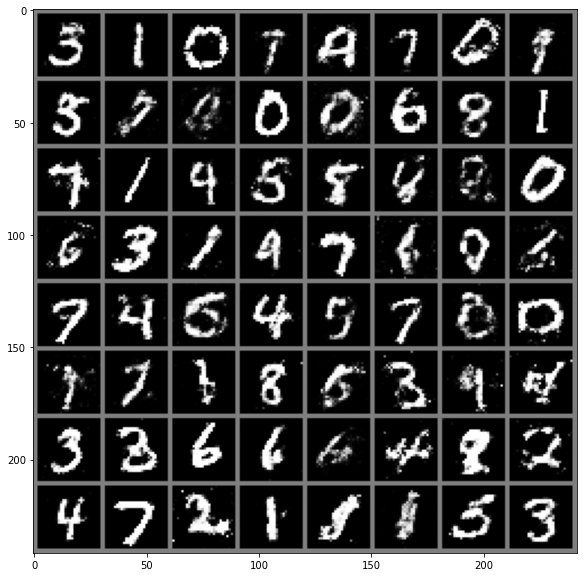

[Epoch 60/200] [Batch 817/937] [D loss: 0.638412] [G loss: 0.837053]
[Epoch 60/200] [Batch 917/937] [D loss: 0.653814] [G loss: 0.815171]
[Epoch 61/200] [Batch 80/937] [D loss: 0.676675] [G loss: 0.996467]
[Epoch 61/200] [Batch 180/937] [D loss: 0.635422] [G loss: 0.765874]
[Epoch 61/200] [Batch 280/937] [D loss: 0.657255] [G loss: 0.806178]
[Epoch 61/200] [Batch 380/937] [D loss: 0.680205] [G loss: 0.819221]
[Epoch 61/200] [Batch 480/937] [D loss: 0.656296] [G loss: 0.860642]
[Epoch 61/200] [Batch 580/937] [D loss: 0.673988] [G loss: 0.864577]
[Epoch 61/200] [Batch 680/937] [D loss: 0.651684] [G loss: 0.838257]
[Epoch 61/200] [Batch 780/937] [D loss: 0.627398] [G loss: 0.724058]
[Epoch 61/200] [Batch 880/937] [D loss: 0.663646] [G loss: 0.841501]
[Epoch 62/200] [Batch 43/937] [D loss: 0.612415] [G loss: 0.736416]
[Epoch 62/200] [Batch 143/937] [D loss: 0.635830] [G loss: 0.802115]
[Epoch 62/200] [Batch 243/937] [D loss: 0.650586] [G loss: 0.789331]
[Epoch 62/200] [Batch 343/937] [D lo

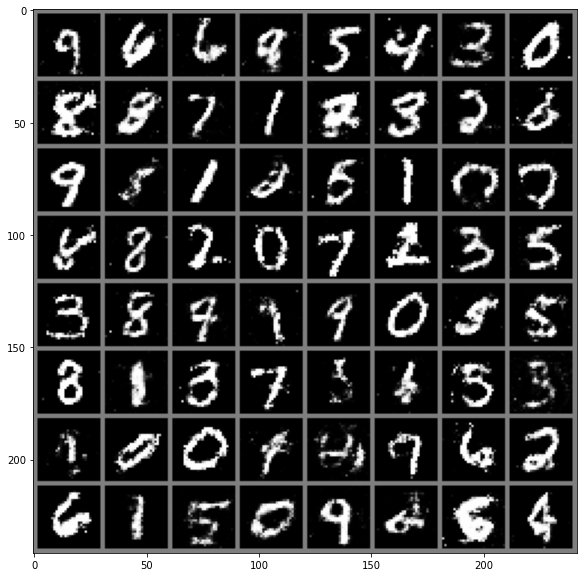

[Epoch 63/200] [Batch 6/937] [D loss: 0.635611] [G loss: 0.776026]
[Epoch 63/200] [Batch 106/937] [D loss: 0.671063] [G loss: 0.823609]
[Epoch 63/200] [Batch 206/937] [D loss: 0.633200] [G loss: 0.762388]
[Epoch 63/200] [Batch 306/937] [D loss: 0.635972] [G loss: 0.842642]
[Epoch 63/200] [Batch 406/937] [D loss: 0.660368] [G loss: 0.803138]
[Epoch 63/200] [Batch 506/937] [D loss: 0.641464] [G loss: 0.886648]
[Epoch 63/200] [Batch 606/937] [D loss: 0.657343] [G loss: 0.775880]
[Epoch 63/200] [Batch 706/937] [D loss: 0.671727] [G loss: 0.884191]
[Epoch 63/200] [Batch 806/937] [D loss: 0.651394] [G loss: 0.754405]
[Epoch 63/200] [Batch 906/937] [D loss: 0.659129] [G loss: 0.799184]
[Epoch 64/200] [Batch 69/937] [D loss: 0.682370] [G loss: 0.907675]
[Epoch 64/200] [Batch 169/937] [D loss: 0.606876] [G loss: 0.850908]
[Epoch 64/200] [Batch 269/937] [D loss: 0.647384] [G loss: 0.792773]
[Epoch 64/200] [Batch 369/937] [D loss: 0.615388] [G loss: 0.877088]
[Epoch 64/200] [Batch 469/937] [D los

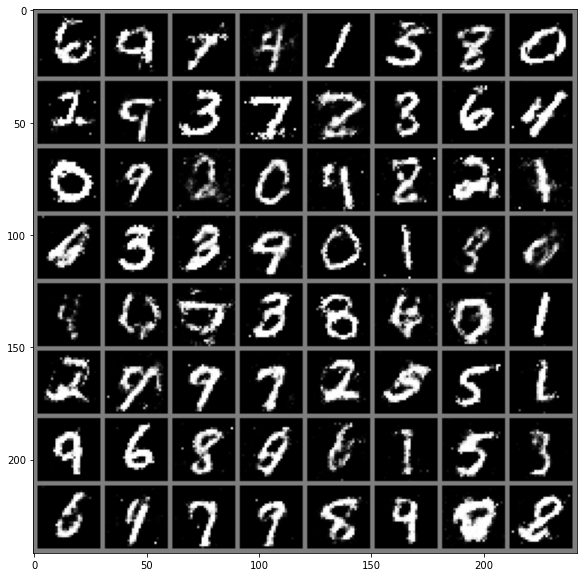

[Epoch 65/200] [Batch 132/937] [D loss: 0.632710] [G loss: 0.836701]
[Epoch 65/200] [Batch 232/937] [D loss: 0.680393] [G loss: 0.812476]
[Epoch 65/200] [Batch 332/937] [D loss: 0.659198] [G loss: 0.792206]
[Epoch 65/200] [Batch 432/937] [D loss: 0.681813] [G loss: 0.896999]
[Epoch 65/200] [Batch 532/937] [D loss: 0.700736] [G loss: 0.831581]
[Epoch 65/200] [Batch 632/937] [D loss: 0.643794] [G loss: 0.857500]
[Epoch 65/200] [Batch 732/937] [D loss: 0.688893] [G loss: 0.887695]
[Epoch 65/200] [Batch 832/937] [D loss: 0.637440] [G loss: 0.732862]
[Epoch 65/200] [Batch 932/937] [D loss: 0.660047] [G loss: 0.796766]
[Epoch 66/200] [Batch 95/937] [D loss: 0.656434] [G loss: 0.795069]
[Epoch 66/200] [Batch 195/937] [D loss: 0.689791] [G loss: 0.708298]
[Epoch 66/200] [Batch 295/937] [D loss: 0.664820] [G loss: 0.761260]
[Epoch 66/200] [Batch 395/937] [D loss: 0.620682] [G loss: 0.784915]
[Epoch 66/200] [Batch 495/937] [D loss: 0.625233] [G loss: 0.755528]
[Epoch 66/200] [Batch 595/937] [D l

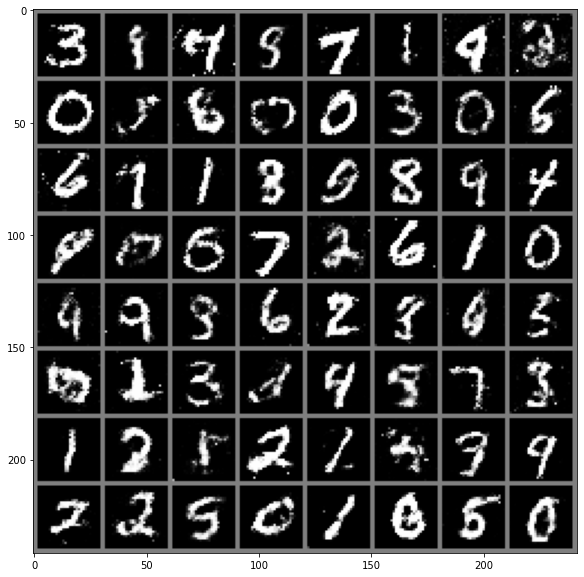

[Epoch 67/200] [Batch 258/937] [D loss: 0.628078] [G loss: 0.951197]
[Epoch 67/200] [Batch 358/937] [D loss: 0.617056] [G loss: 0.822396]
[Epoch 67/200] [Batch 458/937] [D loss: 0.625180] [G loss: 0.740798]
[Epoch 67/200] [Batch 558/937] [D loss: 0.686674] [G loss: 0.850509]
[Epoch 67/200] [Batch 658/937] [D loss: 0.669415] [G loss: 0.878521]
[Epoch 67/200] [Batch 758/937] [D loss: 0.623870] [G loss: 0.828500]
[Epoch 67/200] [Batch 858/937] [D loss: 0.591690] [G loss: 0.927067]
[Epoch 68/200] [Batch 21/937] [D loss: 0.666965] [G loss: 0.799137]
[Epoch 68/200] [Batch 121/937] [D loss: 0.678835] [G loss: 0.821721]
[Epoch 68/200] [Batch 221/937] [D loss: 0.645148] [G loss: 0.800083]
[Epoch 68/200] [Batch 321/937] [D loss: 0.671492] [G loss: 0.895975]
[Epoch 68/200] [Batch 421/937] [D loss: 0.628785] [G loss: 0.847080]
[Epoch 68/200] [Batch 521/937] [D loss: 0.637692] [G loss: 0.839112]
[Epoch 68/200] [Batch 621/937] [D loss: 0.644660] [G loss: 0.758636]
[Epoch 68/200] [Batch 721/937] [D l

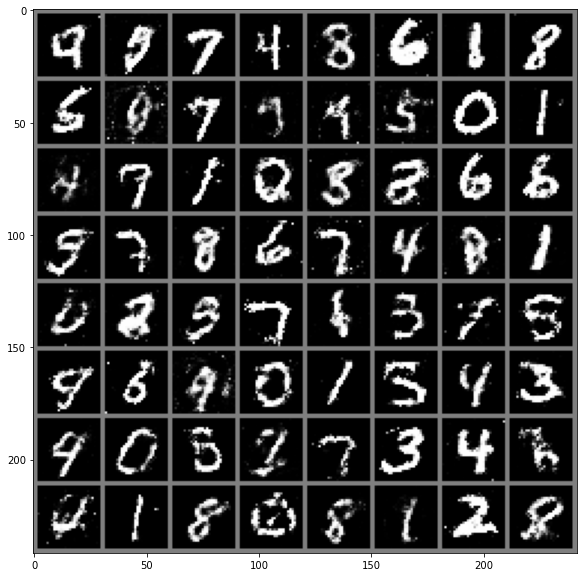

[Epoch 69/200] [Batch 384/937] [D loss: 0.676692] [G loss: 0.924332]
[Epoch 69/200] [Batch 484/937] [D loss: 0.714076] [G loss: 0.834313]
[Epoch 69/200] [Batch 584/937] [D loss: 0.684222] [G loss: 0.906171]
[Epoch 69/200] [Batch 684/937] [D loss: 0.633338] [G loss: 0.874167]
[Epoch 69/200] [Batch 784/937] [D loss: 0.631412] [G loss: 0.805572]
[Epoch 69/200] [Batch 884/937] [D loss: 0.636807] [G loss: 0.792434]
[Epoch 70/200] [Batch 47/937] [D loss: 0.672757] [G loss: 0.767585]
[Epoch 70/200] [Batch 147/937] [D loss: 0.660085] [G loss: 0.766905]
[Epoch 70/200] [Batch 247/937] [D loss: 0.622585] [G loss: 0.817419]
[Epoch 70/200] [Batch 347/937] [D loss: 0.607153] [G loss: 0.804446]
[Epoch 70/200] [Batch 447/937] [D loss: 0.646884] [G loss: 0.885347]
[Epoch 70/200] [Batch 547/937] [D loss: 0.606382] [G loss: 0.810451]
[Epoch 70/200] [Batch 647/937] [D loss: 0.673241] [G loss: 0.833423]
[Epoch 70/200] [Batch 747/937] [D loss: 0.654174] [G loss: 0.773698]
[Epoch 70/200] [Batch 847/937] [D l

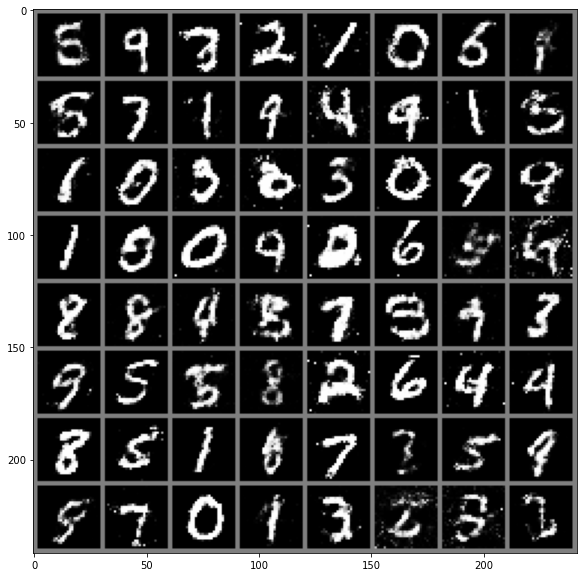

[Epoch 71/200] [Batch 510/937] [D loss: 0.622922] [G loss: 0.807225]
[Epoch 71/200] [Batch 610/937] [D loss: 0.620297] [G loss: 0.939562]
[Epoch 71/200] [Batch 710/937] [D loss: 0.604876] [G loss: 0.736876]
[Epoch 71/200] [Batch 810/937] [D loss: 0.637412] [G loss: 0.805980]
[Epoch 71/200] [Batch 910/937] [D loss: 0.575674] [G loss: 0.774482]
[Epoch 72/200] [Batch 73/937] [D loss: 0.638405] [G loss: 0.812378]
[Epoch 72/200] [Batch 173/937] [D loss: 0.663692] [G loss: 0.772322]
[Epoch 72/200] [Batch 273/937] [D loss: 0.657798] [G loss: 0.960881]
[Epoch 72/200] [Batch 373/937] [D loss: 0.689803] [G loss: 0.942492]
[Epoch 72/200] [Batch 473/937] [D loss: 0.619941] [G loss: 0.790371]
[Epoch 72/200] [Batch 573/937] [D loss: 0.638756] [G loss: 0.834134]
[Epoch 72/200] [Batch 673/937] [D loss: 0.636789] [G loss: 0.792680]
[Epoch 72/200] [Batch 773/937] [D loss: 0.676346] [G loss: 0.833476]
[Epoch 72/200] [Batch 873/937] [D loss: 0.638376] [G loss: 0.862878]
[Epoch 73/200] [Batch 36/937] [D lo

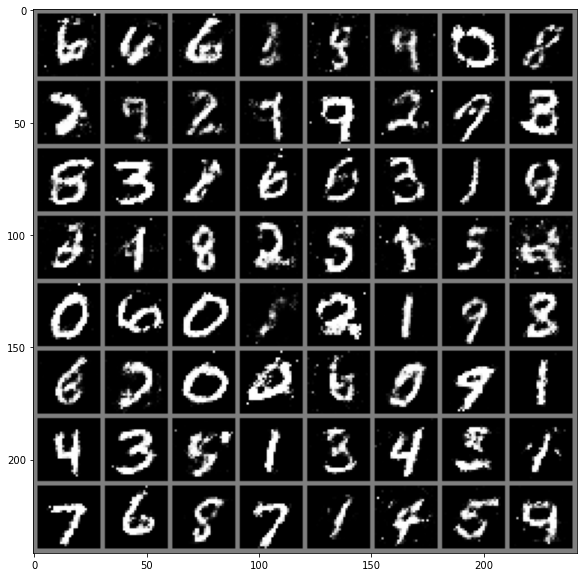

[Epoch 73/200] [Batch 636/937] [D loss: 0.666700] [G loss: 0.801601]
[Epoch 73/200] [Batch 736/937] [D loss: 0.629101] [G loss: 0.792949]
[Epoch 73/200] [Batch 836/937] [D loss: 0.623781] [G loss: 0.817967]
[Epoch 73/200] [Batch 936/937] [D loss: 0.687090] [G loss: 0.863131]
[Epoch 74/200] [Batch 99/937] [D loss: 0.608845] [G loss: 0.859522]
[Epoch 74/200] [Batch 199/937] [D loss: 0.677023] [G loss: 0.814788]
[Epoch 74/200] [Batch 299/937] [D loss: 0.663016] [G loss: 0.898411]
[Epoch 74/200] [Batch 399/937] [D loss: 0.620204] [G loss: 0.887241]
[Epoch 74/200] [Batch 499/937] [D loss: 0.673643] [G loss: 0.838436]
[Epoch 74/200] [Batch 599/937] [D loss: 0.636153] [G loss: 0.800732]
[Epoch 74/200] [Batch 699/937] [D loss: 0.647633] [G loss: 0.837775]
[Epoch 74/200] [Batch 799/937] [D loss: 0.708271] [G loss: 0.805021]
[Epoch 74/200] [Batch 899/937] [D loss: 0.617832] [G loss: 0.802127]
[Epoch 75/200] [Batch 62/937] [D loss: 0.687975] [G loss: 0.780779]
[Epoch 75/200] [Batch 162/937] [D lo

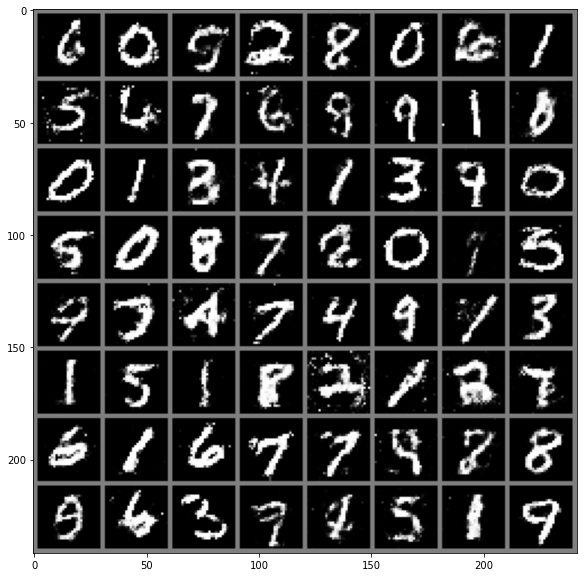

[Epoch 75/200] [Batch 762/937] [D loss: 0.636258] [G loss: 0.762083]
[Epoch 75/200] [Batch 862/937] [D loss: 0.621849] [G loss: 0.836345]
[Epoch 76/200] [Batch 25/937] [D loss: 0.633121] [G loss: 0.942032]
[Epoch 76/200] [Batch 125/937] [D loss: 0.688316] [G loss: 0.724008]
[Epoch 76/200] [Batch 225/937] [D loss: 0.681178] [G loss: 0.782189]
[Epoch 76/200] [Batch 325/937] [D loss: 0.630666] [G loss: 0.848984]
[Epoch 76/200] [Batch 425/937] [D loss: 0.631948] [G loss: 0.746893]
[Epoch 76/200] [Batch 525/937] [D loss: 0.643622] [G loss: 0.841459]
[Epoch 76/200] [Batch 625/937] [D loss: 0.648349] [G loss: 0.762110]
[Epoch 76/200] [Batch 725/937] [D loss: 0.651840] [G loss: 0.816182]
[Epoch 76/200] [Batch 825/937] [D loss: 0.649498] [G loss: 0.873004]
[Epoch 76/200] [Batch 925/937] [D loss: 0.632598] [G loss: 0.837804]
[Epoch 77/200] [Batch 88/937] [D loss: 0.592788] [G loss: 0.827796]
[Epoch 77/200] [Batch 188/937] [D loss: 0.677982] [G loss: 0.756725]
[Epoch 77/200] [Batch 288/937] [D lo

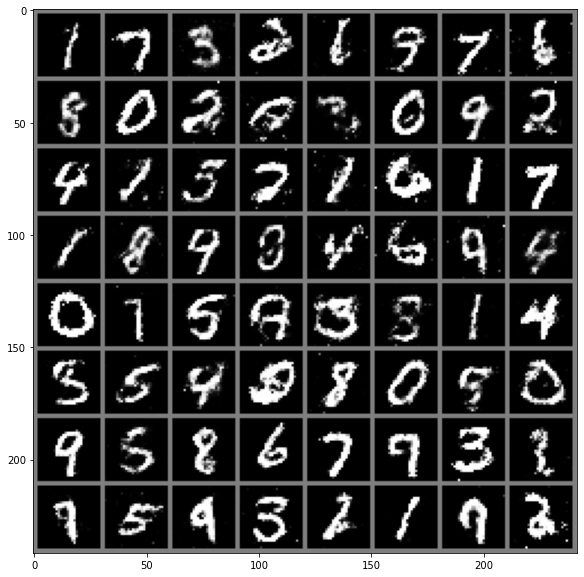

[Epoch 77/200] [Batch 888/937] [D loss: 0.687466] [G loss: 0.755206]
[Epoch 78/200] [Batch 51/937] [D loss: 0.620009] [G loss: 0.758301]
[Epoch 78/200] [Batch 151/937] [D loss: 0.647064] [G loss: 0.836434]
[Epoch 78/200] [Batch 251/937] [D loss: 0.659135] [G loss: 0.744048]
[Epoch 78/200] [Batch 351/937] [D loss: 0.656937] [G loss: 0.862723]
[Epoch 78/200] [Batch 451/937] [D loss: 0.680657] [G loss: 0.861765]
[Epoch 78/200] [Batch 551/937] [D loss: 0.650794] [G loss: 0.715605]
[Epoch 78/200] [Batch 651/937] [D loss: 0.662789] [G loss: 0.792831]
[Epoch 78/200] [Batch 751/937] [D loss: 0.637446] [G loss: 0.940100]
[Epoch 78/200] [Batch 851/937] [D loss: 0.639997] [G loss: 0.908156]
[Epoch 79/200] [Batch 14/937] [D loss: 0.633511] [G loss: 0.786591]
[Epoch 79/200] [Batch 114/937] [D loss: 0.669887] [G loss: 0.830955]
[Epoch 79/200] [Batch 214/937] [D loss: 0.609760] [G loss: 0.889011]
[Epoch 79/200] [Batch 314/937] [D loss: 0.674326] [G loss: 0.906316]
[Epoch 79/200] [Batch 414/937] [D lo

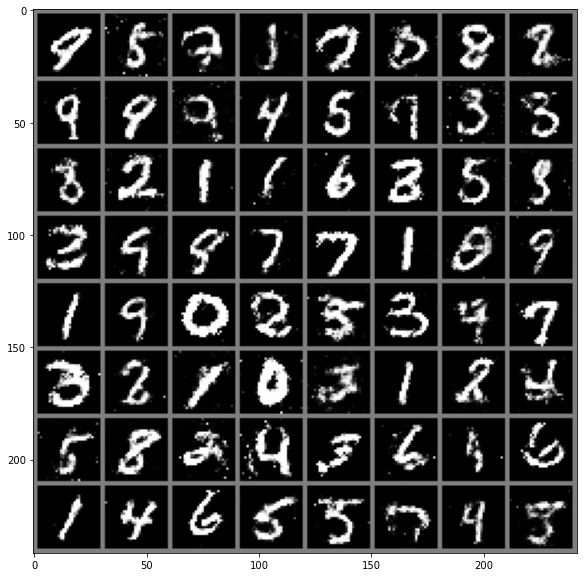

[Epoch 80/200] [Batch 77/937] [D loss: 0.666639] [G loss: 0.779267]
[Epoch 80/200] [Batch 177/937] [D loss: 0.664587] [G loss: 0.883008]
[Epoch 80/200] [Batch 277/937] [D loss: 0.670855] [G loss: 0.889161]
[Epoch 80/200] [Batch 377/937] [D loss: 0.662533] [G loss: 0.787757]
[Epoch 80/200] [Batch 477/937] [D loss: 0.645487] [G loss: 0.810122]
[Epoch 80/200] [Batch 577/937] [D loss: 0.633848] [G loss: 0.847911]
[Epoch 80/200] [Batch 677/937] [D loss: 0.663961] [G loss: 0.849140]
[Epoch 80/200] [Batch 777/937] [D loss: 0.612486] [G loss: 0.864396]
[Epoch 80/200] [Batch 877/937] [D loss: 0.637403] [G loss: 0.780670]
[Epoch 81/200] [Batch 40/937] [D loss: 0.649195] [G loss: 0.896600]
[Epoch 81/200] [Batch 140/937] [D loss: 0.690023] [G loss: 0.804491]
[Epoch 81/200] [Batch 240/937] [D loss: 0.604827] [G loss: 0.848397]
[Epoch 81/200] [Batch 340/937] [D loss: 0.625303] [G loss: 0.924296]
[Epoch 81/200] [Batch 440/937] [D loss: 0.645985] [G loss: 0.855737]
[Epoch 81/200] [Batch 540/937] [D lo

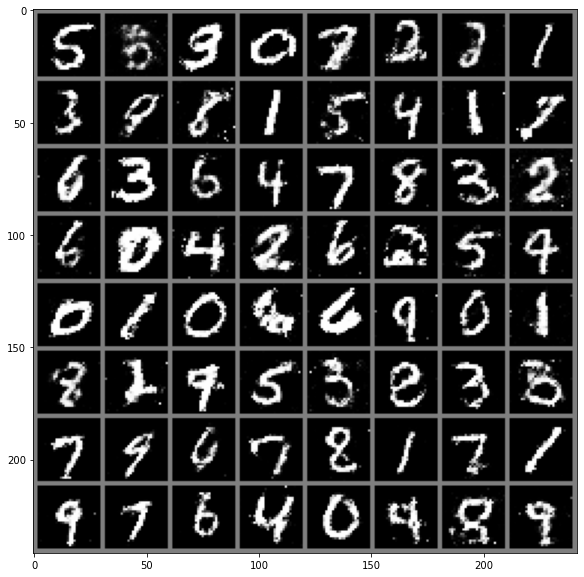

[Epoch 82/200] [Batch 203/937] [D loss: 0.669894] [G loss: 0.889599]
[Epoch 82/200] [Batch 303/937] [D loss: 0.682610] [G loss: 0.766279]
[Epoch 82/200] [Batch 403/937] [D loss: 0.651686] [G loss: 0.908380]
[Epoch 82/200] [Batch 503/937] [D loss: 0.634257] [G loss: 0.914620]
[Epoch 82/200] [Batch 603/937] [D loss: 0.601923] [G loss: 0.922480]
[Epoch 82/200] [Batch 703/937] [D loss: 0.632260] [G loss: 0.780924]
[Epoch 82/200] [Batch 803/937] [D loss: 0.585903] [G loss: 0.879966]
[Epoch 82/200] [Batch 903/937] [D loss: 0.663898] [G loss: 0.812147]
[Epoch 83/200] [Batch 66/937] [D loss: 0.591949] [G loss: 0.920203]
[Epoch 83/200] [Batch 166/937] [D loss: 0.615552] [G loss: 0.935966]
[Epoch 83/200] [Batch 266/937] [D loss: 0.661823] [G loss: 0.758906]
[Epoch 83/200] [Batch 366/937] [D loss: 0.638924] [G loss: 0.822369]
[Epoch 83/200] [Batch 466/937] [D loss: 0.672359] [G loss: 0.864204]
[Epoch 83/200] [Batch 566/937] [D loss: 0.647568] [G loss: 0.775961]
[Epoch 83/200] [Batch 666/937] [D l

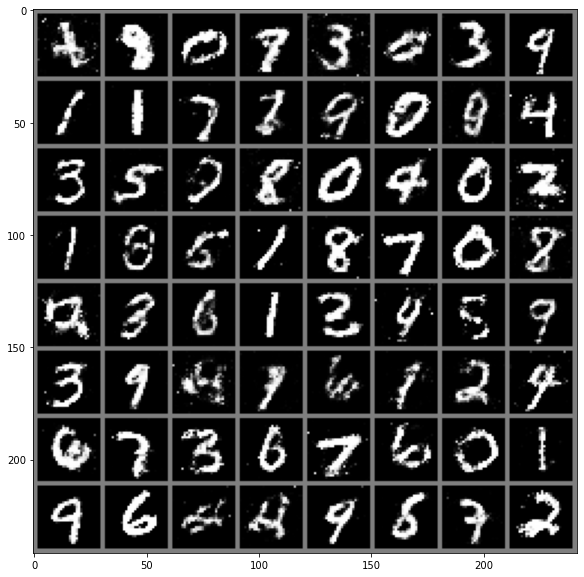

[Epoch 84/200] [Batch 329/937] [D loss: 0.658266] [G loss: 0.830233]
[Epoch 84/200] [Batch 429/937] [D loss: 0.609939] [G loss: 0.795828]
[Epoch 84/200] [Batch 529/937] [D loss: 0.640820] [G loss: 0.801127]
[Epoch 84/200] [Batch 629/937] [D loss: 0.667903] [G loss: 0.765686]
[Epoch 84/200] [Batch 729/937] [D loss: 0.668680] [G loss: 0.886075]
[Epoch 84/200] [Batch 829/937] [D loss: 0.631380] [G loss: 0.774578]
[Epoch 84/200] [Batch 929/937] [D loss: 0.640109] [G loss: 0.832660]
[Epoch 85/200] [Batch 92/937] [D loss: 0.658370] [G loss: 0.878090]
[Epoch 85/200] [Batch 192/937] [D loss: 0.671939] [G loss: 0.833291]
[Epoch 85/200] [Batch 292/937] [D loss: 0.661748] [G loss: 0.830031]
[Epoch 85/200] [Batch 392/937] [D loss: 0.643049] [G loss: 0.958491]
[Epoch 85/200] [Batch 492/937] [D loss: 0.622183] [G loss: 0.797993]
[Epoch 85/200] [Batch 592/937] [D loss: 0.632777] [G loss: 0.816819]
[Epoch 85/200] [Batch 692/937] [D loss: 0.612100] [G loss: 0.800145]
[Epoch 85/200] [Batch 792/937] [D l

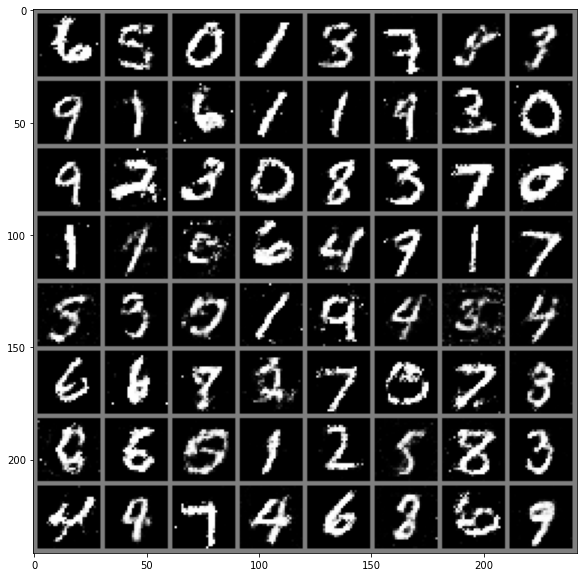

[Epoch 86/200] [Batch 455/937] [D loss: 0.708050] [G loss: 0.796832]
[Epoch 86/200] [Batch 555/937] [D loss: 0.668283] [G loss: 0.848984]
[Epoch 86/200] [Batch 655/937] [D loss: 0.677590] [G loss: 0.781597]
[Epoch 86/200] [Batch 755/937] [D loss: 0.617165] [G loss: 0.867034]
[Epoch 86/200] [Batch 855/937] [D loss: 0.676493] [G loss: 0.792490]
[Epoch 87/200] [Batch 18/937] [D loss: 0.638022] [G loss: 0.852098]
[Epoch 87/200] [Batch 118/937] [D loss: 0.655226] [G loss: 0.824531]
[Epoch 87/200] [Batch 218/937] [D loss: 0.649363] [G loss: 0.792336]
[Epoch 87/200] [Batch 318/937] [D loss: 0.625588] [G loss: 0.883094]
[Epoch 87/200] [Batch 418/937] [D loss: 0.661678] [G loss: 0.755040]
[Epoch 87/200] [Batch 518/937] [D loss: 0.679734] [G loss: 0.769970]
[Epoch 87/200] [Batch 618/937] [D loss: 0.602777] [G loss: 0.738362]
[Epoch 87/200] [Batch 718/937] [D loss: 0.632958] [G loss: 0.797071]
[Epoch 87/200] [Batch 818/937] [D loss: 0.619040] [G loss: 0.832415]
[Epoch 87/200] [Batch 918/937] [D l

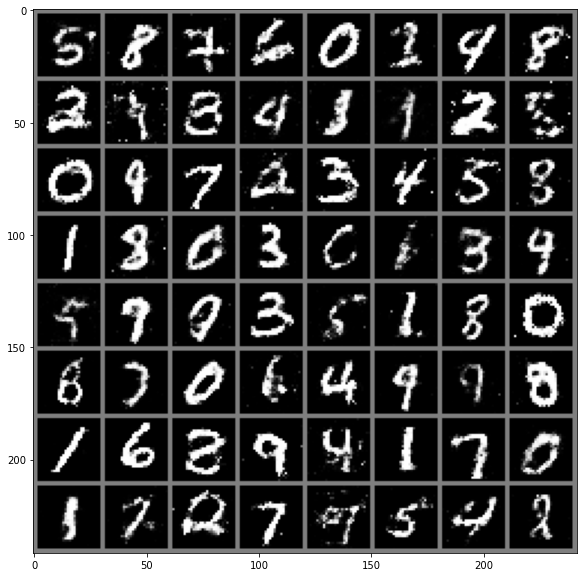

[Epoch 88/200] [Batch 581/937] [D loss: 0.667440] [G loss: 0.864504]
[Epoch 88/200] [Batch 681/937] [D loss: 0.641574] [G loss: 0.820942]
[Epoch 88/200] [Batch 781/937] [D loss: 0.662077] [G loss: 0.791148]
[Epoch 88/200] [Batch 881/937] [D loss: 0.651218] [G loss: 0.845283]
[Epoch 89/200] [Batch 44/937] [D loss: 0.666552] [G loss: 0.865230]
[Epoch 89/200] [Batch 144/937] [D loss: 0.635291] [G loss: 0.862371]
[Epoch 89/200] [Batch 244/937] [D loss: 0.661812] [G loss: 0.742395]
[Epoch 89/200] [Batch 344/937] [D loss: 0.638628] [G loss: 0.915840]
[Epoch 89/200] [Batch 444/937] [D loss: 0.606963] [G loss: 0.889044]
[Epoch 89/200] [Batch 544/937] [D loss: 0.659529] [G loss: 0.754480]
[Epoch 89/200] [Batch 644/937] [D loss: 0.613821] [G loss: 0.863102]
[Epoch 89/200] [Batch 744/937] [D loss: 0.684964] [G loss: 0.801627]
[Epoch 89/200] [Batch 844/937] [D loss: 0.634952] [G loss: 0.756946]
[Epoch 90/200] [Batch 7/937] [D loss: 0.638336] [G loss: 0.828520]
[Epoch 90/200] [Batch 107/937] [D los

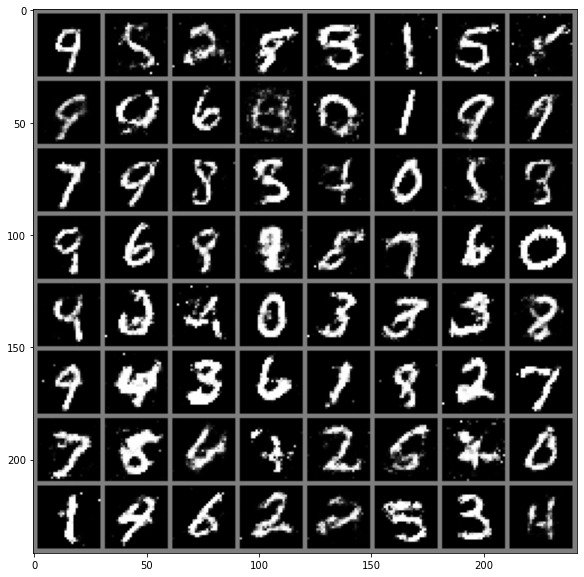

[Epoch 90/200] [Batch 707/937] [D loss: 0.614509] [G loss: 0.886894]
[Epoch 90/200] [Batch 807/937] [D loss: 0.651080] [G loss: 0.893312]
[Epoch 90/200] [Batch 907/937] [D loss: 0.684877] [G loss: 0.734874]
[Epoch 91/200] [Batch 70/937] [D loss: 0.628089] [G loss: 0.883250]
[Epoch 91/200] [Batch 170/937] [D loss: 0.646033] [G loss: 0.823980]
[Epoch 91/200] [Batch 270/937] [D loss: 0.644027] [G loss: 0.818883]
[Epoch 91/200] [Batch 370/937] [D loss: 0.657779] [G loss: 0.772949]
[Epoch 91/200] [Batch 470/937] [D loss: 0.621645] [G loss: 0.789415]
[Epoch 91/200] [Batch 570/937] [D loss: 0.616838] [G loss: 0.779222]
[Epoch 91/200] [Batch 670/937] [D loss: 0.663871] [G loss: 0.797577]
[Epoch 91/200] [Batch 770/937] [D loss: 0.657475] [G loss: 0.866740]
[Epoch 91/200] [Batch 870/937] [D loss: 0.652628] [G loss: 0.764543]
[Epoch 92/200] [Batch 33/937] [D loss: 0.650356] [G loss: 0.796753]
[Epoch 92/200] [Batch 133/937] [D loss: 0.667017] [G loss: 0.954843]
[Epoch 92/200] [Batch 233/937] [D lo

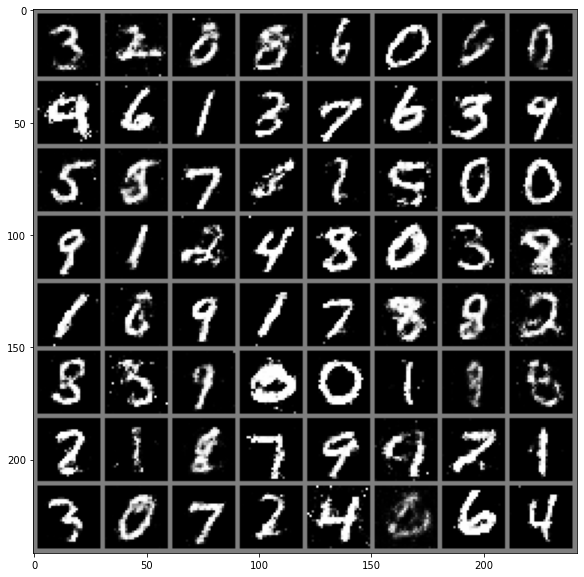

[Epoch 92/200] [Batch 833/937] [D loss: 0.679932] [G loss: 0.934150]
[Epoch 92/200] [Batch 933/937] [D loss: 0.631204] [G loss: 0.892136]
[Epoch 93/200] [Batch 96/937] [D loss: 0.632907] [G loss: 0.910804]
[Epoch 93/200] [Batch 196/937] [D loss: 0.628279] [G loss: 0.786272]
[Epoch 93/200] [Batch 296/937] [D loss: 0.632291] [G loss: 0.781046]
[Epoch 93/200] [Batch 396/937] [D loss: 0.701450] [G loss: 0.886864]
[Epoch 93/200] [Batch 496/937] [D loss: 0.657700] [G loss: 0.768093]
[Epoch 93/200] [Batch 596/937] [D loss: 0.664916] [G loss: 0.879277]
[Epoch 93/200] [Batch 696/937] [D loss: 0.652149] [G loss: 0.776476]
[Epoch 93/200] [Batch 796/937] [D loss: 0.661752] [G loss: 0.800546]
[Epoch 93/200] [Batch 896/937] [D loss: 0.654670] [G loss: 0.843911]
[Epoch 94/200] [Batch 59/937] [D loss: 0.671785] [G loss: 0.854882]
[Epoch 94/200] [Batch 159/937] [D loss: 0.697026] [G loss: 0.872386]
[Epoch 94/200] [Batch 259/937] [D loss: 0.600424] [G loss: 0.895081]
[Epoch 94/200] [Batch 359/937] [D lo

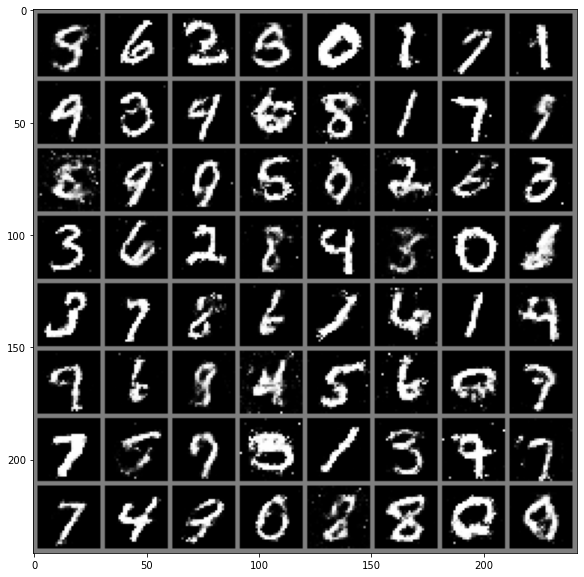

[Epoch 95/200] [Batch 22/937] [D loss: 0.621535] [G loss: 0.798711]
[Epoch 95/200] [Batch 122/937] [D loss: 0.619292] [G loss: 0.862915]
[Epoch 95/200] [Batch 222/937] [D loss: 0.650263] [G loss: 0.761523]
[Epoch 95/200] [Batch 322/937] [D loss: 0.690054] [G loss: 0.830204]
[Epoch 95/200] [Batch 422/937] [D loss: 0.667181] [G loss: 0.833968]
[Epoch 95/200] [Batch 522/937] [D loss: 0.648215] [G loss: 0.822955]
[Epoch 95/200] [Batch 622/937] [D loss: 0.689905] [G loss: 0.835561]
[Epoch 95/200] [Batch 722/937] [D loss: 0.620546] [G loss: 0.857382]
[Epoch 95/200] [Batch 822/937] [D loss: 0.677241] [G loss: 0.885633]
[Epoch 95/200] [Batch 922/937] [D loss: 0.635095] [G loss: 0.881101]
[Epoch 96/200] [Batch 85/937] [D loss: 0.632365] [G loss: 0.899189]
[Epoch 96/200] [Batch 185/937] [D loss: 0.645133] [G loss: 0.873194]
[Epoch 96/200] [Batch 285/937] [D loss: 0.627380] [G loss: 0.784972]
[Epoch 96/200] [Batch 385/937] [D loss: 0.673847] [G loss: 0.796934]
[Epoch 96/200] [Batch 485/937] [D lo

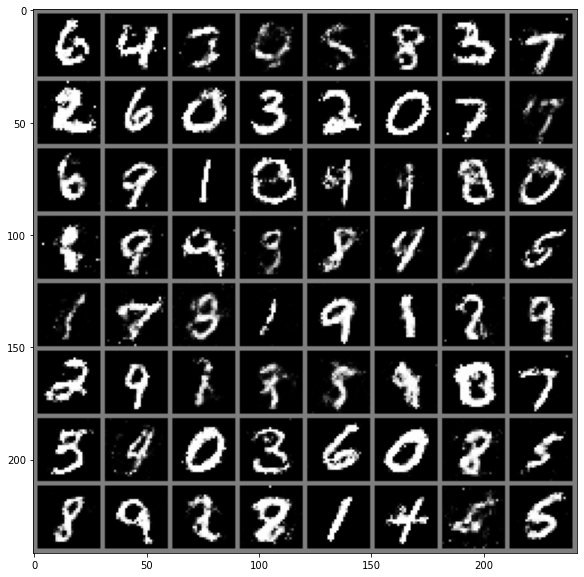

[Epoch 97/200] [Batch 148/937] [D loss: 0.675312] [G loss: 0.795716]
[Epoch 97/200] [Batch 248/937] [D loss: 0.645078] [G loss: 0.870333]
[Epoch 97/200] [Batch 348/937] [D loss: 0.594605] [G loss: 0.837103]
[Epoch 97/200] [Batch 448/937] [D loss: 0.650968] [G loss: 0.854427]
[Epoch 97/200] [Batch 548/937] [D loss: 0.663307] [G loss: 0.876653]
[Epoch 97/200] [Batch 648/937] [D loss: 0.641176] [G loss: 0.772190]
[Epoch 97/200] [Batch 748/937] [D loss: 0.647566] [G loss: 0.813965]
[Epoch 97/200] [Batch 848/937] [D loss: 0.656585] [G loss: 0.810199]
[Epoch 98/200] [Batch 11/937] [D loss: 0.659467] [G loss: 0.851218]
[Epoch 98/200] [Batch 111/937] [D loss: 0.640802] [G loss: 0.806303]
[Epoch 98/200] [Batch 211/937] [D loss: 0.671246] [G loss: 0.857655]
[Epoch 98/200] [Batch 311/937] [D loss: 0.652614] [G loss: 0.870177]
[Epoch 98/200] [Batch 411/937] [D loss: 0.691913] [G loss: 0.788048]
[Epoch 98/200] [Batch 511/937] [D loss: 0.613871] [G loss: 0.889637]
[Epoch 98/200] [Batch 611/937] [D l

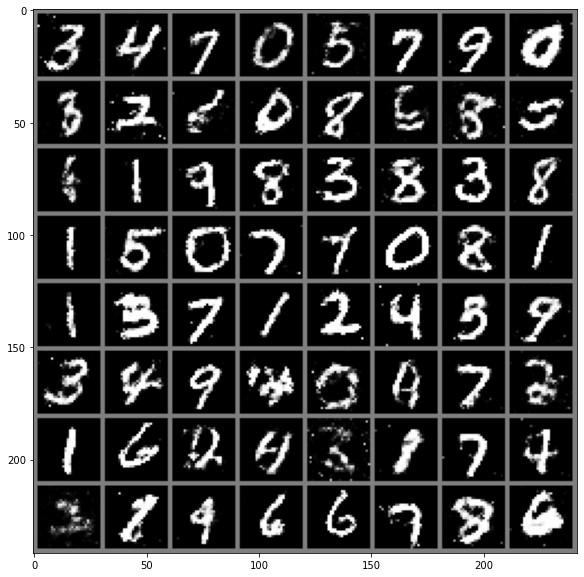

[Epoch 99/200] [Batch 274/937] [D loss: 0.630863] [G loss: 0.848289]
[Epoch 99/200] [Batch 374/937] [D loss: 0.675119] [G loss: 0.775394]
[Epoch 99/200] [Batch 474/937] [D loss: 0.626500] [G loss: 0.914573]
[Epoch 99/200] [Batch 574/937] [D loss: 0.614806] [G loss: 0.775386]
[Epoch 99/200] [Batch 674/937] [D loss: 0.651142] [G loss: 0.771075]
[Epoch 99/200] [Batch 774/937] [D loss: 0.633599] [G loss: 0.796939]
[Epoch 99/200] [Batch 874/937] [D loss: 0.615742] [G loss: 0.816181]
[Epoch 100/200] [Batch 37/937] [D loss: 0.633314] [G loss: 0.884418]
[Epoch 100/200] [Batch 137/937] [D loss: 0.628946] [G loss: 0.887420]
[Epoch 100/200] [Batch 237/937] [D loss: 0.661595] [G loss: 0.889355]
[Epoch 100/200] [Batch 337/937] [D loss: 0.644691] [G loss: 0.840404]
[Epoch 100/200] [Batch 437/937] [D loss: 0.604373] [G loss: 0.790233]
[Epoch 100/200] [Batch 537/937] [D loss: 0.655796] [G loss: 0.738751]
[Epoch 100/200] [Batch 637/937] [D loss: 0.693088] [G loss: 0.815861]
[Epoch 100/200] [Batch 737/9

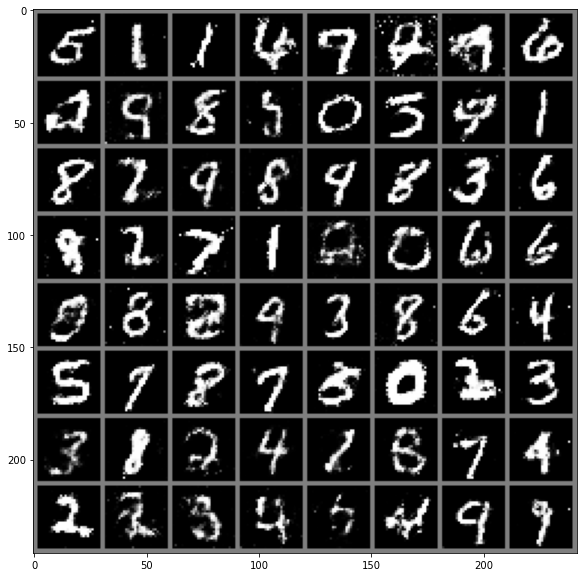

[Epoch 101/200] [Batch 400/937] [D loss: 0.632877] [G loss: 0.851076]
[Epoch 101/200] [Batch 500/937] [D loss: 0.636785] [G loss: 0.902537]
[Epoch 101/200] [Batch 600/937] [D loss: 0.655766] [G loss: 0.876203]
[Epoch 101/200] [Batch 700/937] [D loss: 0.623844] [G loss: 0.862213]
[Epoch 101/200] [Batch 800/937] [D loss: 0.672666] [G loss: 0.749756]
[Epoch 101/200] [Batch 900/937] [D loss: 0.674656] [G loss: 0.823704]
[Epoch 102/200] [Batch 63/937] [D loss: 0.646276] [G loss: 0.841289]
[Epoch 102/200] [Batch 163/937] [D loss: 0.653247] [G loss: 0.819121]
[Epoch 102/200] [Batch 263/937] [D loss: 0.679664] [G loss: 0.885722]
[Epoch 102/200] [Batch 363/937] [D loss: 0.638486] [G loss: 0.861593]
[Epoch 102/200] [Batch 463/937] [D loss: 0.633655] [G loss: 0.757864]
[Epoch 102/200] [Batch 563/937] [D loss: 0.650205] [G loss: 0.720503]
[Epoch 102/200] [Batch 663/937] [D loss: 0.660205] [G loss: 0.818573]
[Epoch 102/200] [Batch 763/937] [D loss: 0.616807] [G loss: 0.806030]
[Epoch 102/200] [Batc

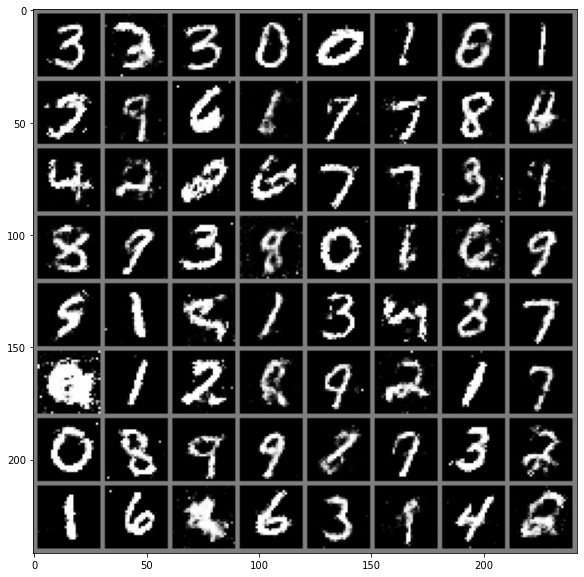

[Epoch 103/200] [Batch 526/937] [D loss: 0.653355] [G loss: 0.738897]
[Epoch 103/200] [Batch 626/937] [D loss: 0.653087] [G loss: 0.918369]
[Epoch 103/200] [Batch 726/937] [D loss: 0.642811] [G loss: 0.753084]
[Epoch 103/200] [Batch 826/937] [D loss: 0.658379] [G loss: 0.957467]
[Epoch 103/200] [Batch 926/937] [D loss: 0.662570] [G loss: 0.824278]
[Epoch 104/200] [Batch 89/937] [D loss: 0.676336] [G loss: 0.777247]
[Epoch 104/200] [Batch 189/937] [D loss: 0.617172] [G loss: 0.857754]
[Epoch 104/200] [Batch 289/937] [D loss: 0.641617] [G loss: 0.757380]
[Epoch 104/200] [Batch 389/937] [D loss: 0.589887] [G loss: 0.749945]
[Epoch 104/200] [Batch 489/937] [D loss: 0.679009] [G loss: 0.907694]
[Epoch 104/200] [Batch 589/937] [D loss: 0.636271] [G loss: 0.899404]
[Epoch 104/200] [Batch 689/937] [D loss: 0.630173] [G loss: 0.944115]
[Epoch 104/200] [Batch 789/937] [D loss: 0.672811] [G loss: 0.849040]
[Epoch 104/200] [Batch 889/937] [D loss: 0.627170] [G loss: 0.701357]
[Epoch 105/200] [Batc

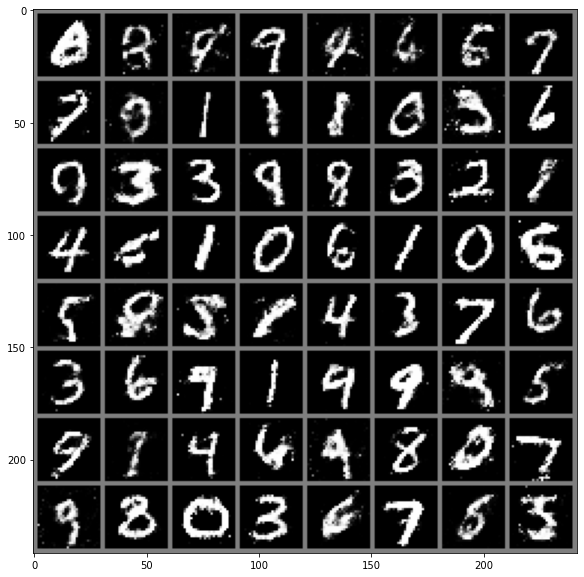

[Epoch 105/200] [Batch 652/937] [D loss: 0.596125] [G loss: 0.843320]
[Epoch 105/200] [Batch 752/937] [D loss: 0.650573] [G loss: 0.847347]
[Epoch 105/200] [Batch 852/937] [D loss: 0.634337] [G loss: 0.806101]
[Epoch 106/200] [Batch 15/937] [D loss: 0.620148] [G loss: 0.833127]
[Epoch 106/200] [Batch 115/937] [D loss: 0.670818] [G loss: 0.771043]
[Epoch 106/200] [Batch 215/937] [D loss: 0.594743] [G loss: 0.868226]
[Epoch 106/200] [Batch 315/937] [D loss: 0.648245] [G loss: 0.930651]
[Epoch 106/200] [Batch 415/937] [D loss: 0.627436] [G loss: 0.935291]
[Epoch 106/200] [Batch 515/937] [D loss: 0.676363] [G loss: 0.835245]
[Epoch 106/200] [Batch 615/937] [D loss: 0.664799] [G loss: 0.901621]
[Epoch 106/200] [Batch 715/937] [D loss: 0.629228] [G loss: 0.908756]
[Epoch 106/200] [Batch 815/937] [D loss: 0.673790] [G loss: 0.901003]
[Epoch 106/200] [Batch 915/937] [D loss: 0.639663] [G loss: 0.780497]
[Epoch 107/200] [Batch 78/937] [D loss: 0.608792] [G loss: 0.803675]
[Epoch 107/200] [Batch

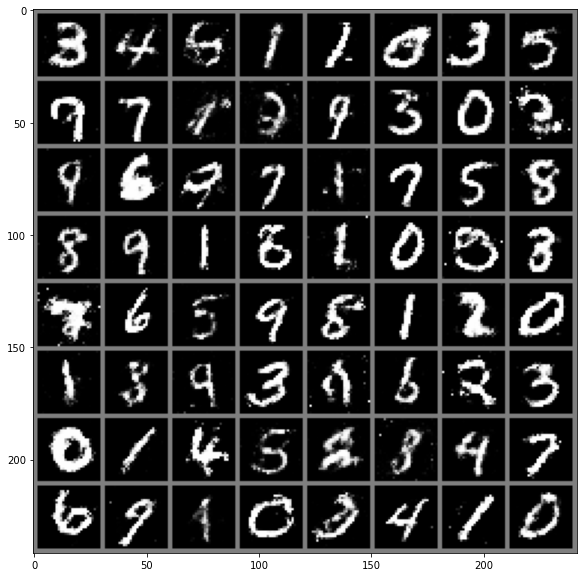

[Epoch 107/200] [Batch 778/937] [D loss: 0.701492] [G loss: 0.813796]
[Epoch 107/200] [Batch 878/937] [D loss: 0.632726] [G loss: 0.844850]
[Epoch 108/200] [Batch 41/937] [D loss: 0.650276] [G loss: 0.847055]
[Epoch 108/200] [Batch 141/937] [D loss: 0.659182] [G loss: 0.814993]
[Epoch 108/200] [Batch 241/937] [D loss: 0.700143] [G loss: 0.853651]
[Epoch 108/200] [Batch 341/937] [D loss: 0.692834] [G loss: 0.820561]
[Epoch 108/200] [Batch 441/937] [D loss: 0.637863] [G loss: 0.795620]
[Epoch 108/200] [Batch 541/937] [D loss: 0.612411] [G loss: 0.923944]
[Epoch 108/200] [Batch 641/937] [D loss: 0.640558] [G loss: 0.823188]
[Epoch 108/200] [Batch 741/937] [D loss: 0.623523] [G loss: 0.919461]
[Epoch 108/200] [Batch 841/937] [D loss: 0.661523] [G loss: 0.911480]
[Epoch 109/200] [Batch 4/937] [D loss: 0.631477] [G loss: 0.825983]
[Epoch 109/200] [Batch 104/937] [D loss: 0.672255] [G loss: 0.842149]
[Epoch 109/200] [Batch 204/937] [D loss: 0.585570] [G loss: 0.890696]
[Epoch 109/200] [Batch 

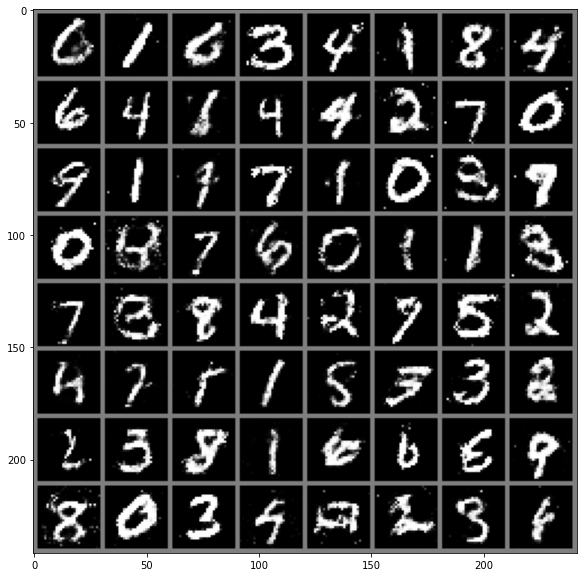

[Epoch 109/200] [Batch 904/937] [D loss: 0.623713] [G loss: 0.847463]
[Epoch 110/200] [Batch 67/937] [D loss: 0.658686] [G loss: 0.770044]
[Epoch 110/200] [Batch 167/937] [D loss: 0.623349] [G loss: 0.841660]
[Epoch 110/200] [Batch 267/937] [D loss: 0.616219] [G loss: 0.844327]
[Epoch 110/200] [Batch 367/937] [D loss: 0.635868] [G loss: 0.868144]
[Epoch 110/200] [Batch 467/937] [D loss: 0.625403] [G loss: 0.862069]
[Epoch 110/200] [Batch 567/937] [D loss: 0.615228] [G loss: 0.888284]
[Epoch 110/200] [Batch 667/937] [D loss: 0.645857] [G loss: 0.982495]
[Epoch 110/200] [Batch 767/937] [D loss: 0.637338] [G loss: 0.842620]
[Epoch 110/200] [Batch 867/937] [D loss: 0.614997] [G loss: 0.913284]
[Epoch 111/200] [Batch 30/937] [D loss: 0.639825] [G loss: 0.813427]
[Epoch 111/200] [Batch 130/937] [D loss: 0.644704] [G loss: 0.780038]
[Epoch 111/200] [Batch 230/937] [D loss: 0.620698] [G loss: 0.946807]
[Epoch 111/200] [Batch 330/937] [D loss: 0.645285] [G loss: 0.902174]
[Epoch 111/200] [Batch

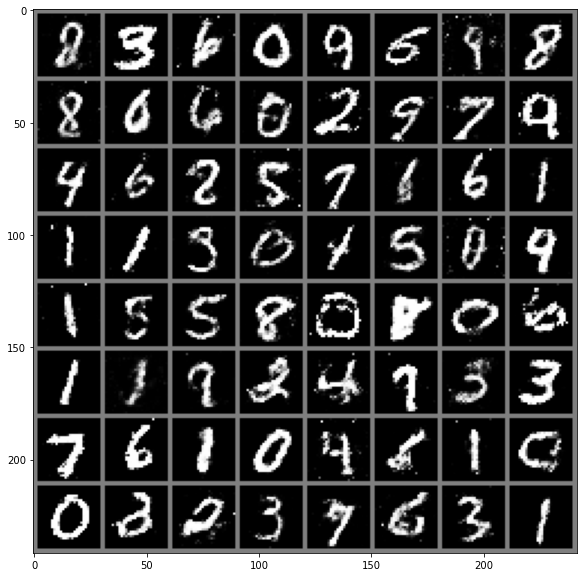

[Epoch 112/200] [Batch 93/937] [D loss: 0.662292] [G loss: 0.785758]
[Epoch 112/200] [Batch 193/937] [D loss: 0.626566] [G loss: 0.868632]
[Epoch 112/200] [Batch 293/937] [D loss: 0.650525] [G loss: 0.813351]
[Epoch 112/200] [Batch 393/937] [D loss: 0.647016] [G loss: 0.843315]
[Epoch 112/200] [Batch 493/937] [D loss: 0.661467] [G loss: 0.890862]
[Epoch 112/200] [Batch 593/937] [D loss: 0.614040] [G loss: 0.921870]
[Epoch 112/200] [Batch 693/937] [D loss: 0.690546] [G loss: 0.849076]
[Epoch 112/200] [Batch 793/937] [D loss: 0.671917] [G loss: 0.794836]
[Epoch 112/200] [Batch 893/937] [D loss: 0.690226] [G loss: 0.836825]
[Epoch 113/200] [Batch 56/937] [D loss: 0.640900] [G loss: 0.730340]
[Epoch 113/200] [Batch 156/937] [D loss: 0.622497] [G loss: 0.767764]
[Epoch 113/200] [Batch 256/937] [D loss: 0.625336] [G loss: 0.843050]
[Epoch 113/200] [Batch 356/937] [D loss: 0.627609] [G loss: 0.976098]
[Epoch 113/200] [Batch 456/937] [D loss: 0.662717] [G loss: 0.870803]
[Epoch 113/200] [Batch

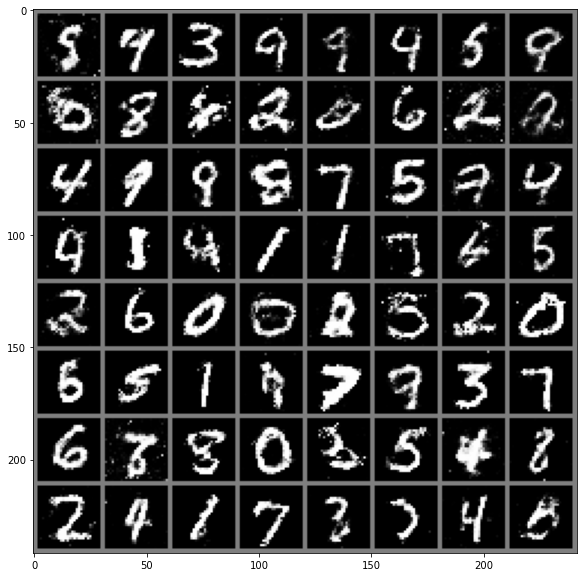

[Epoch 114/200] [Batch 219/937] [D loss: 0.628354] [G loss: 0.845967]
[Epoch 114/200] [Batch 319/937] [D loss: 0.637202] [G loss: 0.873081]
[Epoch 114/200] [Batch 419/937] [D loss: 0.656866] [G loss: 0.788837]
[Epoch 114/200] [Batch 519/937] [D loss: 0.647536] [G loss: 0.967539]
[Epoch 114/200] [Batch 619/937] [D loss: 0.631347] [G loss: 0.820951]
[Epoch 114/200] [Batch 719/937] [D loss: 0.590303] [G loss: 0.865689]
[Epoch 114/200] [Batch 819/937] [D loss: 0.651058] [G loss: 0.767374]
[Epoch 114/200] [Batch 919/937] [D loss: 0.642729] [G loss: 0.836369]
[Epoch 115/200] [Batch 82/937] [D loss: 0.657729] [G loss: 0.803728]
[Epoch 115/200] [Batch 182/937] [D loss: 0.571029] [G loss: 0.803692]
[Epoch 115/200] [Batch 282/937] [D loss: 0.693199] [G loss: 0.872317]
[Epoch 115/200] [Batch 382/937] [D loss: 0.673995] [G loss: 0.816022]
[Epoch 115/200] [Batch 482/937] [D loss: 0.666870] [G loss: 0.896134]
[Epoch 115/200] [Batch 582/937] [D loss: 0.636196] [G loss: 0.946772]
[Epoch 115/200] [Batc

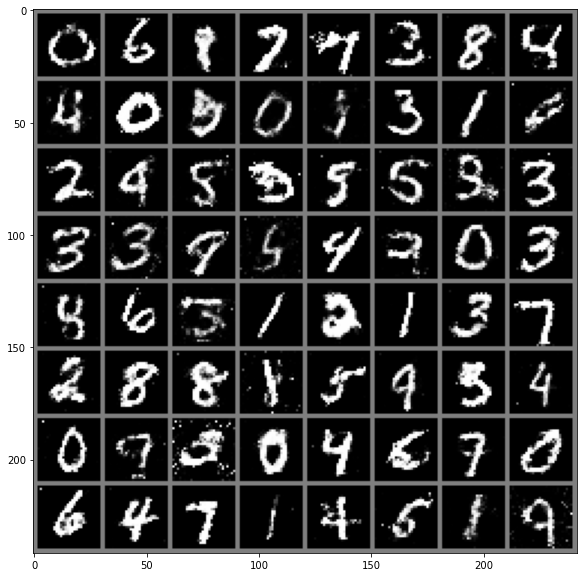

[Epoch 116/200] [Batch 345/937] [D loss: 0.623129] [G loss: 0.832590]
[Epoch 116/200] [Batch 445/937] [D loss: 0.702868] [G loss: 0.891902]
[Epoch 116/200] [Batch 545/937] [D loss: 0.688172] [G loss: 0.794349]
[Epoch 116/200] [Batch 645/937] [D loss: 0.620493] [G loss: 0.872559]
[Epoch 116/200] [Batch 745/937] [D loss: 0.635320] [G loss: 0.830813]
[Epoch 116/200] [Batch 845/937] [D loss: 0.641882] [G loss: 0.883476]
[Epoch 117/200] [Batch 8/937] [D loss: 0.646495] [G loss: 0.854422]
[Epoch 117/200] [Batch 108/937] [D loss: 0.646633] [G loss: 0.818281]
[Epoch 117/200] [Batch 208/937] [D loss: 0.651341] [G loss: 0.836943]
[Epoch 117/200] [Batch 308/937] [D loss: 0.608292] [G loss: 0.875587]
[Epoch 117/200] [Batch 408/937] [D loss: 0.600707] [G loss: 0.860113]
[Epoch 117/200] [Batch 508/937] [D loss: 0.623350] [G loss: 0.857607]
[Epoch 117/200] [Batch 608/937] [D loss: 0.645407] [G loss: 0.875686]
[Epoch 117/200] [Batch 708/937] [D loss: 0.650183] [G loss: 0.771014]
[Epoch 117/200] [Batch

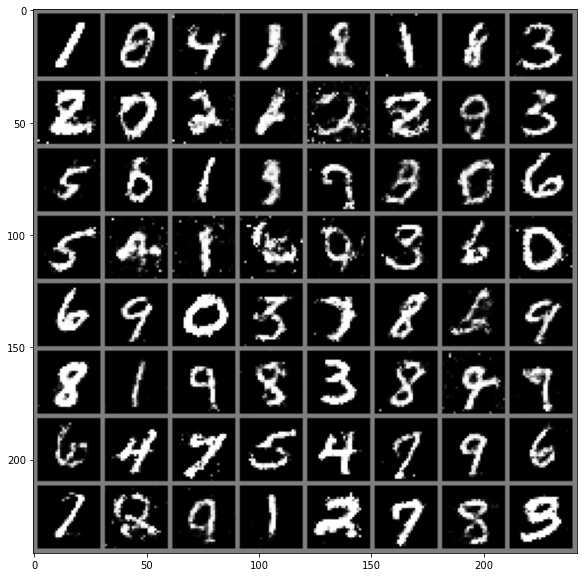

[Epoch 118/200] [Batch 471/937] [D loss: 0.646458] [G loss: 0.790828]
[Epoch 118/200] [Batch 571/937] [D loss: 0.656649] [G loss: 0.854066]
[Epoch 118/200] [Batch 671/937] [D loss: 0.633586] [G loss: 0.813031]
[Epoch 118/200] [Batch 771/937] [D loss: 0.650257] [G loss: 0.797301]
[Epoch 118/200] [Batch 871/937] [D loss: 0.614064] [G loss: 0.838600]
[Epoch 119/200] [Batch 34/937] [D loss: 0.674112] [G loss: 0.803332]
[Epoch 119/200] [Batch 134/937] [D loss: 0.667946] [G loss: 0.845378]
[Epoch 119/200] [Batch 234/937] [D loss: 0.633841] [G loss: 0.888553]
[Epoch 119/200] [Batch 334/937] [D loss: 0.653860] [G loss: 0.880256]
[Epoch 119/200] [Batch 434/937] [D loss: 0.627465] [G loss: 0.839993]
[Epoch 119/200] [Batch 534/937] [D loss: 0.649669] [G loss: 0.753604]
[Epoch 119/200] [Batch 634/937] [D loss: 0.632487] [G loss: 0.838936]
[Epoch 119/200] [Batch 734/937] [D loss: 0.655626] [G loss: 0.803611]
[Epoch 119/200] [Batch 834/937] [D loss: 0.649322] [G loss: 0.828778]
[Epoch 119/200] [Batc

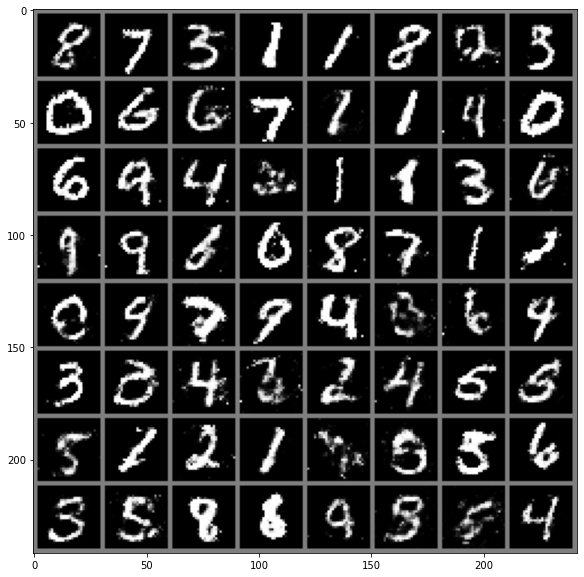

[Epoch 120/200] [Batch 597/937] [D loss: 0.616601] [G loss: 0.866218]
[Epoch 120/200] [Batch 697/937] [D loss: 0.634187] [G loss: 0.791692]
[Epoch 120/200] [Batch 797/937] [D loss: 0.635344] [G loss: 0.860179]
[Epoch 120/200] [Batch 897/937] [D loss: 0.657716] [G loss: 0.819565]
[Epoch 121/200] [Batch 60/937] [D loss: 0.669099] [G loss: 0.858283]
[Epoch 121/200] [Batch 160/937] [D loss: 0.627741] [G loss: 0.817598]
[Epoch 121/200] [Batch 260/937] [D loss: 0.600179] [G loss: 0.860404]
[Epoch 121/200] [Batch 360/937] [D loss: 0.640941] [G loss: 0.826150]
[Epoch 121/200] [Batch 460/937] [D loss: 0.622169] [G loss: 0.869742]
[Epoch 121/200] [Batch 560/937] [D loss: 0.631498] [G loss: 0.878390]
[Epoch 121/200] [Batch 660/937] [D loss: 0.645591] [G loss: 0.864174]
[Epoch 121/200] [Batch 760/937] [D loss: 0.639455] [G loss: 0.881490]
[Epoch 121/200] [Batch 860/937] [D loss: 0.623120] [G loss: 0.830291]
[Epoch 122/200] [Batch 23/937] [D loss: 0.646215] [G loss: 0.847298]
[Epoch 122/200] [Batch

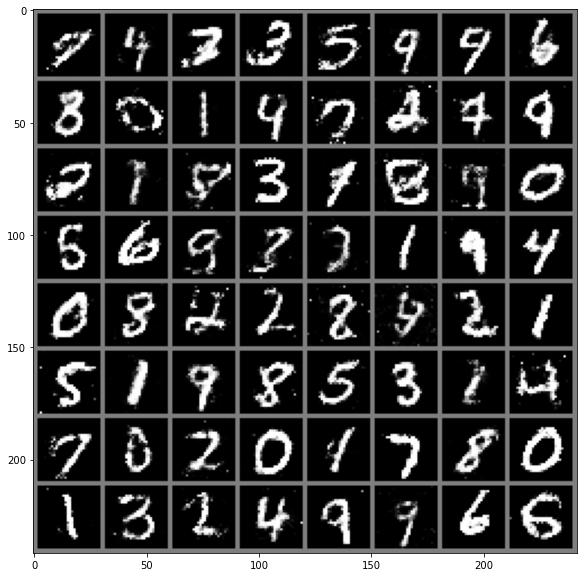

[Epoch 122/200] [Batch 723/937] [D loss: 0.616883] [G loss: 0.803221]
[Epoch 122/200] [Batch 823/937] [D loss: 0.660386] [G loss: 0.833611]
[Epoch 122/200] [Batch 923/937] [D loss: 0.638934] [G loss: 0.807031]
[Epoch 123/200] [Batch 86/937] [D loss: 0.616492] [G loss: 1.012189]
[Epoch 123/200] [Batch 186/937] [D loss: 0.608199] [G loss: 0.915970]
[Epoch 123/200] [Batch 286/937] [D loss: 0.667591] [G loss: 0.866393]
[Epoch 123/200] [Batch 386/937] [D loss: 0.644359] [G loss: 0.889529]
[Epoch 123/200] [Batch 486/937] [D loss: 0.660625] [G loss: 0.932925]
[Epoch 123/200] [Batch 586/937] [D loss: 0.655139] [G loss: 0.803648]
[Epoch 123/200] [Batch 686/937] [D loss: 0.685535] [G loss: 0.818720]
[Epoch 123/200] [Batch 786/937] [D loss: 0.672772] [G loss: 0.945897]
[Epoch 123/200] [Batch 886/937] [D loss: 0.700656] [G loss: 0.803484]
[Epoch 124/200] [Batch 49/937] [D loss: 0.650982] [G loss: 0.788441]
[Epoch 124/200] [Batch 149/937] [D loss: 0.665950] [G loss: 0.878776]
[Epoch 124/200] [Batch

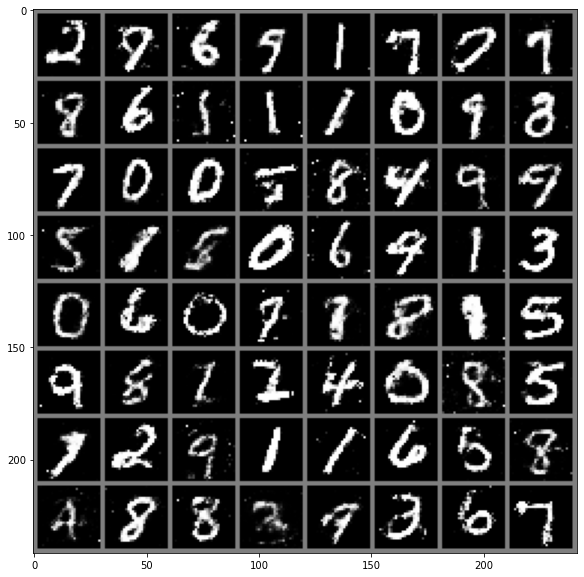

[Epoch 124/200] [Batch 849/937] [D loss: 0.611381] [G loss: 0.814033]
[Epoch 125/200] [Batch 12/937] [D loss: 0.656013] [G loss: 0.829860]
[Epoch 125/200] [Batch 112/937] [D loss: 0.618381] [G loss: 0.868922]
[Epoch 125/200] [Batch 212/937] [D loss: 0.661609] [G loss: 0.938305]
[Epoch 125/200] [Batch 312/937] [D loss: 0.660397] [G loss: 0.938461]
[Epoch 125/200] [Batch 412/937] [D loss: 0.666977] [G loss: 0.829518]
[Epoch 125/200] [Batch 512/937] [D loss: 0.628043] [G loss: 0.729745]
[Epoch 125/200] [Batch 612/937] [D loss: 0.625033] [G loss: 0.901579]
[Epoch 125/200] [Batch 712/937] [D loss: 0.664439] [G loss: 0.896777]
[Epoch 125/200] [Batch 812/937] [D loss: 0.672424] [G loss: 0.835901]
[Epoch 125/200] [Batch 912/937] [D loss: 0.663244] [G loss: 0.847749]
[Epoch 126/200] [Batch 75/937] [D loss: 0.675317] [G loss: 0.899719]
[Epoch 126/200] [Batch 175/937] [D loss: 0.625432] [G loss: 0.941586]
[Epoch 126/200] [Batch 275/937] [D loss: 0.654307] [G loss: 0.831942]
[Epoch 126/200] [Batch

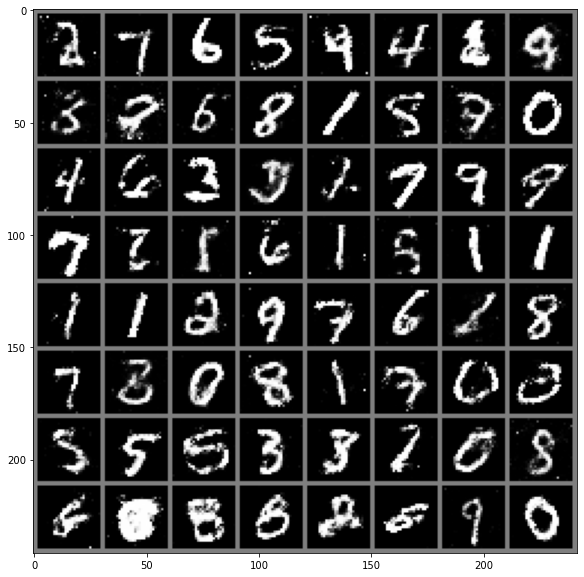

[Epoch 127/200] [Batch 38/937] [D loss: 0.672836] [G loss: 0.901708]
[Epoch 127/200] [Batch 138/937] [D loss: 0.656316] [G loss: 0.962730]
[Epoch 127/200] [Batch 238/937] [D loss: 0.640770] [G loss: 0.855175]
[Epoch 127/200] [Batch 338/937] [D loss: 0.634560] [G loss: 0.803590]
[Epoch 127/200] [Batch 438/937] [D loss: 0.668513] [G loss: 0.825022]
[Epoch 127/200] [Batch 538/937] [D loss: 0.639354] [G loss: 0.906334]
[Epoch 127/200] [Batch 638/937] [D loss: 0.647476] [G loss: 0.899354]
[Epoch 127/200] [Batch 738/937] [D loss: 0.631200] [G loss: 0.811254]
[Epoch 127/200] [Batch 838/937] [D loss: 0.641388] [G loss: 0.861452]
[Epoch 128/200] [Batch 1/937] [D loss: 0.660006] [G loss: 0.907579]
[Epoch 128/200] [Batch 101/937] [D loss: 0.640991] [G loss: 0.886440]
[Epoch 128/200] [Batch 201/937] [D loss: 0.638956] [G loss: 0.911334]
[Epoch 128/200] [Batch 301/937] [D loss: 0.663315] [G loss: 0.835926]
[Epoch 128/200] [Batch 401/937] [D loss: 0.664667] [G loss: 0.856149]
[Epoch 128/200] [Batch 

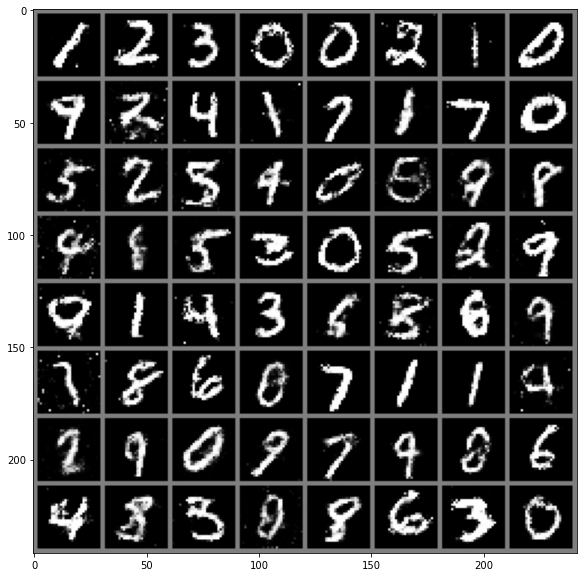

[Epoch 129/200] [Batch 164/937] [D loss: 0.651314] [G loss: 0.721644]
[Epoch 129/200] [Batch 264/937] [D loss: 0.641562] [G loss: 0.800477]
[Epoch 129/200] [Batch 364/937] [D loss: 0.661496] [G loss: 0.904960]
[Epoch 129/200] [Batch 464/937] [D loss: 0.629129] [G loss: 0.811039]
[Epoch 129/200] [Batch 564/937] [D loss: 0.628096] [G loss: 0.869771]
[Epoch 129/200] [Batch 664/937] [D loss: 0.684236] [G loss: 0.736128]
[Epoch 129/200] [Batch 764/937] [D loss: 0.628449] [G loss: 0.777928]
[Epoch 129/200] [Batch 864/937] [D loss: 0.636389] [G loss: 0.842501]
[Epoch 130/200] [Batch 27/937] [D loss: 0.622474] [G loss: 0.855935]
[Epoch 130/200] [Batch 127/937] [D loss: 0.649129] [G loss: 0.885590]
[Epoch 130/200] [Batch 227/937] [D loss: 0.640102] [G loss: 0.968651]
[Epoch 130/200] [Batch 327/937] [D loss: 0.670383] [G loss: 0.869120]
[Epoch 130/200] [Batch 427/937] [D loss: 0.662497] [G loss: 0.819286]
[Epoch 130/200] [Batch 527/937] [D loss: 0.678645] [G loss: 0.882776]
[Epoch 130/200] [Batc

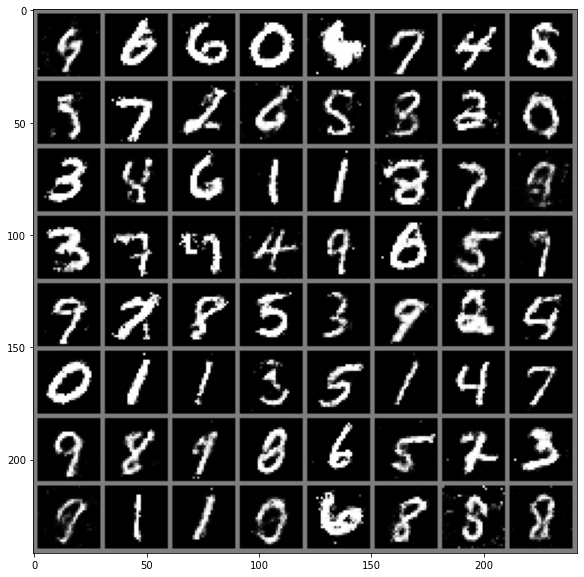

[Epoch 131/200] [Batch 290/937] [D loss: 0.687455] [G loss: 0.790107]
[Epoch 131/200] [Batch 390/937] [D loss: 0.629383] [G loss: 0.918227]
[Epoch 131/200] [Batch 490/937] [D loss: 0.663402] [G loss: 0.809057]
[Epoch 131/200] [Batch 590/937] [D loss: 0.651867] [G loss: 0.864848]
[Epoch 131/200] [Batch 690/937] [D loss: 0.645529] [G loss: 0.855220]
[Epoch 131/200] [Batch 790/937] [D loss: 0.650061] [G loss: 0.841517]
[Epoch 131/200] [Batch 890/937] [D loss: 0.703907] [G loss: 0.796118]
[Epoch 132/200] [Batch 53/937] [D loss: 0.602826] [G loss: 0.849333]
[Epoch 132/200] [Batch 153/937] [D loss: 0.617151] [G loss: 0.807895]
[Epoch 132/200] [Batch 253/937] [D loss: 0.642379] [G loss: 0.771274]
[Epoch 132/200] [Batch 353/937] [D loss: 0.581050] [G loss: 0.850507]
[Epoch 132/200] [Batch 453/937] [D loss: 0.622538] [G loss: 0.868236]
[Epoch 132/200] [Batch 553/937] [D loss: 0.624088] [G loss: 0.835127]
[Epoch 132/200] [Batch 653/937] [D loss: 0.633853] [G loss: 0.855887]
[Epoch 132/200] [Batc

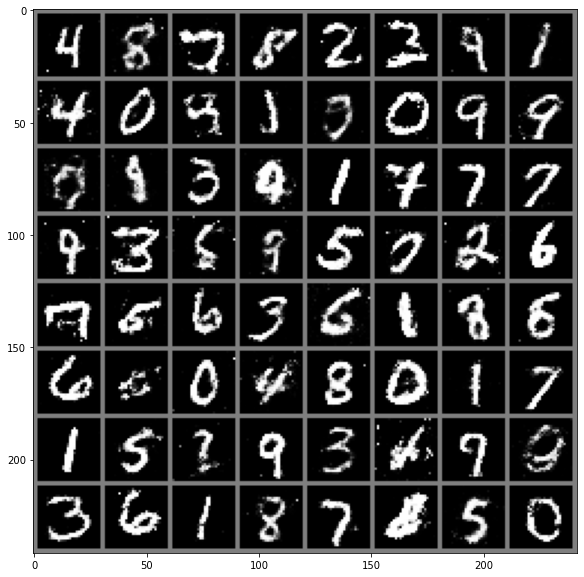

[Epoch 133/200] [Batch 416/937] [D loss: 0.607762] [G loss: 0.855690]
[Epoch 133/200] [Batch 516/937] [D loss: 0.624167] [G loss: 0.927330]
[Epoch 133/200] [Batch 616/937] [D loss: 0.635182] [G loss: 0.827404]
[Epoch 133/200] [Batch 716/937] [D loss: 0.631001] [G loss: 0.789344]
[Epoch 133/200] [Batch 816/937] [D loss: 0.604364] [G loss: 0.791294]
[Epoch 133/200] [Batch 916/937] [D loss: 0.672737] [G loss: 0.797630]
[Epoch 134/200] [Batch 79/937] [D loss: 0.720939] [G loss: 0.811080]
[Epoch 134/200] [Batch 179/937] [D loss: 0.637237] [G loss: 0.895899]
[Epoch 134/200] [Batch 279/937] [D loss: 0.664638] [G loss: 0.886395]
[Epoch 134/200] [Batch 379/937] [D loss: 0.679145] [G loss: 0.805255]
[Epoch 134/200] [Batch 479/937] [D loss: 0.635869] [G loss: 0.827902]
[Epoch 134/200] [Batch 579/937] [D loss: 0.642211] [G loss: 0.892536]
[Epoch 134/200] [Batch 679/937] [D loss: 0.617375] [G loss: 0.824148]
[Epoch 134/200] [Batch 779/937] [D loss: 0.618876] [G loss: 0.959074]
[Epoch 134/200] [Batc

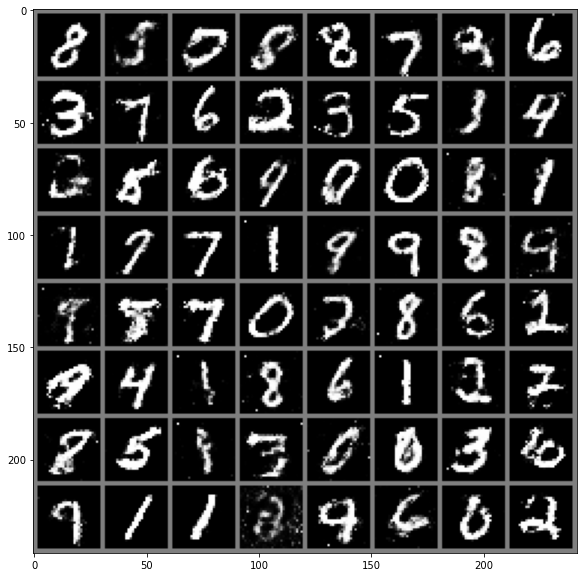

[Epoch 135/200] [Batch 542/937] [D loss: 0.638242] [G loss: 0.848623]
[Epoch 135/200] [Batch 642/937] [D loss: 0.681266] [G loss: 0.780011]
[Epoch 135/200] [Batch 742/937] [D loss: 0.677284] [G loss: 0.873297]
[Epoch 135/200] [Batch 842/937] [D loss: 0.602663] [G loss: 0.903101]
[Epoch 136/200] [Batch 5/937] [D loss: 0.643294] [G loss: 0.755092]
[Epoch 136/200] [Batch 105/937] [D loss: 0.648468] [G loss: 0.804560]
[Epoch 136/200] [Batch 205/937] [D loss: 0.658594] [G loss: 0.888838]
[Epoch 136/200] [Batch 305/937] [D loss: 0.664684] [G loss: 0.808072]
[Epoch 136/200] [Batch 405/937] [D loss: 0.617300] [G loss: 0.852905]
[Epoch 136/200] [Batch 505/937] [D loss: 0.668955] [G loss: 0.789596]
[Epoch 136/200] [Batch 605/937] [D loss: 0.644915] [G loss: 0.922501]
[Epoch 136/200] [Batch 705/937] [D loss: 0.650652] [G loss: 0.808791]
[Epoch 136/200] [Batch 805/937] [D loss: 0.647013] [G loss: 0.890138]
[Epoch 136/200] [Batch 905/937] [D loss: 0.674634] [G loss: 0.897831]
[Epoch 137/200] [Batch

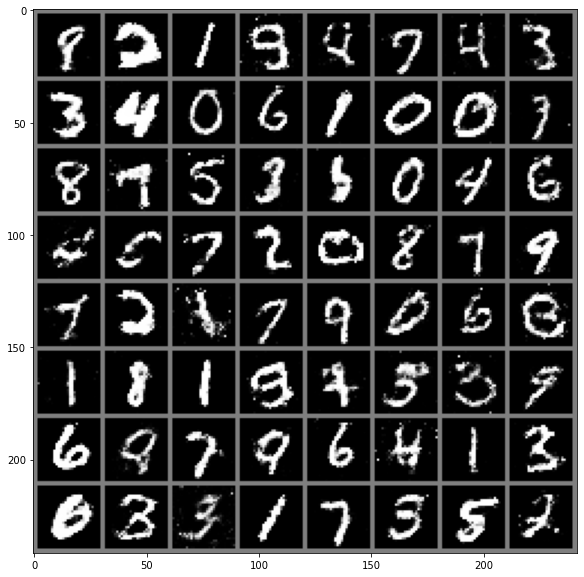

[Epoch 137/200] [Batch 668/937] [D loss: 0.646239] [G loss: 0.835466]
[Epoch 137/200] [Batch 768/937] [D loss: 0.646031] [G loss: 0.864889]
[Epoch 137/200] [Batch 868/937] [D loss: 0.626675] [G loss: 0.866012]
[Epoch 138/200] [Batch 31/937] [D loss: 0.596978] [G loss: 0.886575]
[Epoch 138/200] [Batch 131/937] [D loss: 0.659084] [G loss: 0.719277]
[Epoch 138/200] [Batch 231/937] [D loss: 0.633376] [G loss: 0.823639]
[Epoch 138/200] [Batch 331/937] [D loss: 0.620651] [G loss: 0.844064]
[Epoch 138/200] [Batch 431/937] [D loss: 0.671497] [G loss: 0.814251]
[Epoch 138/200] [Batch 531/937] [D loss: 0.636957] [G loss: 0.859742]
[Epoch 138/200] [Batch 631/937] [D loss: 0.625453] [G loss: 0.772163]
[Epoch 138/200] [Batch 731/937] [D loss: 0.603587] [G loss: 0.857139]
[Epoch 138/200] [Batch 831/937] [D loss: 0.642635] [G loss: 0.926710]
[Epoch 138/200] [Batch 931/937] [D loss: 0.658558] [G loss: 0.834448]
[Epoch 139/200] [Batch 94/937] [D loss: 0.617798] [G loss: 0.883972]
[Epoch 139/200] [Batch

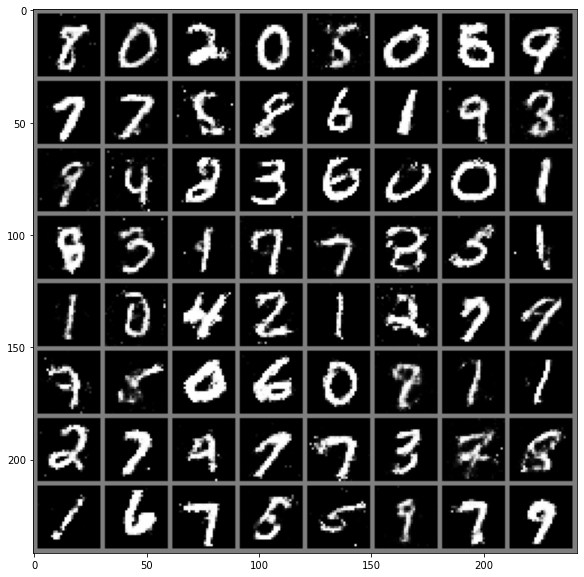

[Epoch 139/200] [Batch 794/937] [D loss: 0.640793] [G loss: 0.884305]
[Epoch 139/200] [Batch 894/937] [D loss: 0.628512] [G loss: 0.782055]
[Epoch 140/200] [Batch 57/937] [D loss: 0.611984] [G loss: 0.901484]
[Epoch 140/200] [Batch 157/937] [D loss: 0.692909] [G loss: 0.778438]
[Epoch 140/200] [Batch 257/937] [D loss: 0.594638] [G loss: 0.855543]
[Epoch 140/200] [Batch 357/937] [D loss: 0.605025] [G loss: 0.868691]
[Epoch 140/200] [Batch 457/937] [D loss: 0.639597] [G loss: 0.851486]
[Epoch 140/200] [Batch 557/937] [D loss: 0.647220] [G loss: 0.940227]
[Epoch 140/200] [Batch 657/937] [D loss: 0.666541] [G loss: 0.797345]
[Epoch 140/200] [Batch 757/937] [D loss: 0.594575] [G loss: 0.832771]
[Epoch 140/200] [Batch 857/937] [D loss: 0.623938] [G loss: 0.824836]
[Epoch 141/200] [Batch 20/937] [D loss: 0.618546] [G loss: 0.821813]
[Epoch 141/200] [Batch 120/937] [D loss: 0.641853] [G loss: 0.821886]
[Epoch 141/200] [Batch 220/937] [D loss: 0.634326] [G loss: 0.846114]
[Epoch 141/200] [Batch

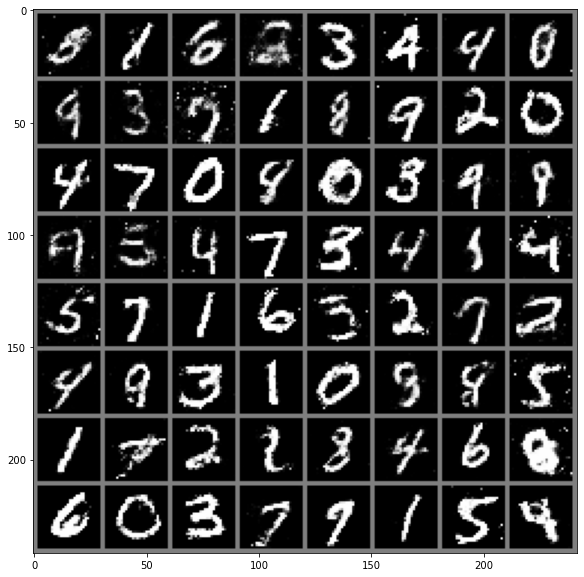

[Epoch 141/200] [Batch 920/937] [D loss: 0.669175] [G loss: 0.930664]
[Epoch 142/200] [Batch 83/937] [D loss: 0.623092] [G loss: 0.902163]
[Epoch 142/200] [Batch 183/937] [D loss: 0.644968] [G loss: 0.968495]
[Epoch 142/200] [Batch 283/937] [D loss: 0.659643] [G loss: 0.800230]
[Epoch 142/200] [Batch 383/937] [D loss: 0.624878] [G loss: 0.980493]
[Epoch 142/200] [Batch 483/937] [D loss: 0.668522] [G loss: 0.775501]
[Epoch 142/200] [Batch 583/937] [D loss: 0.631476] [G loss: 0.855741]
[Epoch 142/200] [Batch 683/937] [D loss: 0.676792] [G loss: 0.818715]
[Epoch 142/200] [Batch 783/937] [D loss: 0.671152] [G loss: 0.824164]
[Epoch 142/200] [Batch 883/937] [D loss: 0.643897] [G loss: 0.931131]
[Epoch 143/200] [Batch 46/937] [D loss: 0.658648] [G loss: 0.957998]
[Epoch 143/200] [Batch 146/937] [D loss: 0.628343] [G loss: 0.852520]
[Epoch 143/200] [Batch 246/937] [D loss: 0.669578] [G loss: 0.882654]
[Epoch 143/200] [Batch 346/937] [D loss: 0.685177] [G loss: 0.826601]
[Epoch 143/200] [Batch

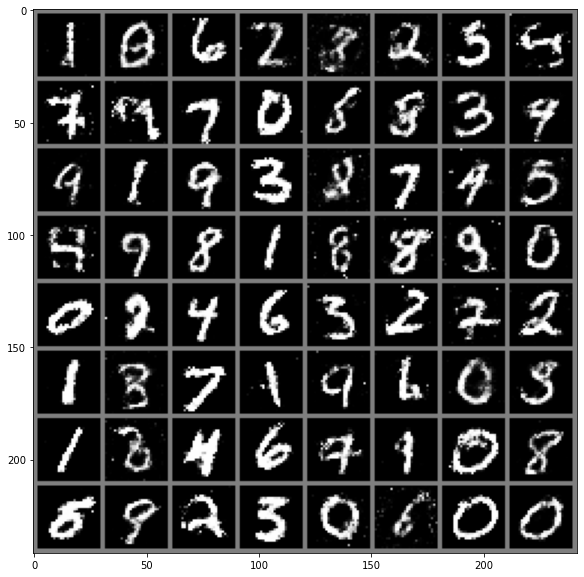

[Epoch 144/200] [Batch 109/937] [D loss: 0.666801] [G loss: 0.799813]
[Epoch 144/200] [Batch 209/937] [D loss: 0.665272] [G loss: 0.823470]
[Epoch 144/200] [Batch 309/937] [D loss: 0.631638] [G loss: 0.856629]
[Epoch 144/200] [Batch 409/937] [D loss: 0.640582] [G loss: 0.796178]
[Epoch 144/200] [Batch 509/937] [D loss: 0.636110] [G loss: 0.852001]
[Epoch 144/200] [Batch 609/937] [D loss: 0.701122] [G loss: 0.869507]
[Epoch 144/200] [Batch 709/937] [D loss: 0.650428] [G loss: 0.840186]
[Epoch 144/200] [Batch 809/937] [D loss: 0.694024] [G loss: 0.846892]
[Epoch 144/200] [Batch 909/937] [D loss: 0.667899] [G loss: 0.813098]
[Epoch 145/200] [Batch 72/937] [D loss: 0.628952] [G loss: 0.874089]
[Epoch 145/200] [Batch 172/937] [D loss: 0.651536] [G loss: 0.802683]
[Epoch 145/200] [Batch 272/937] [D loss: 0.626188] [G loss: 0.877075]
[Epoch 145/200] [Batch 372/937] [D loss: 0.660522] [G loss: 0.809665]
[Epoch 145/200] [Batch 472/937] [D loss: 0.650864] [G loss: 0.824266]
[Epoch 145/200] [Batc

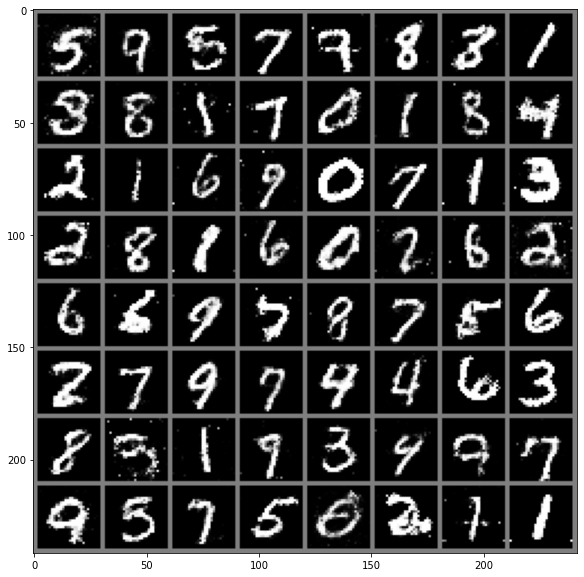

[Epoch 146/200] [Batch 235/937] [D loss: 0.608496] [G loss: 0.854244]
[Epoch 146/200] [Batch 335/937] [D loss: 0.622605] [G loss: 0.847400]
[Epoch 146/200] [Batch 435/937] [D loss: 0.628027] [G loss: 0.861153]
[Epoch 146/200] [Batch 535/937] [D loss: 0.689676] [G loss: 0.891735]
[Epoch 146/200] [Batch 635/937] [D loss: 0.620686] [G loss: 0.923748]
[Epoch 146/200] [Batch 735/937] [D loss: 0.649041] [G loss: 0.849864]
[Epoch 146/200] [Batch 835/937] [D loss: 0.665738] [G loss: 0.794516]
[Epoch 146/200] [Batch 935/937] [D loss: 0.682582] [G loss: 0.847256]
[Epoch 147/200] [Batch 98/937] [D loss: 0.672270] [G loss: 0.851618]
[Epoch 147/200] [Batch 198/937] [D loss: 0.690039] [G loss: 0.826470]
[Epoch 147/200] [Batch 298/937] [D loss: 0.617013] [G loss: 0.886866]
[Epoch 147/200] [Batch 398/937] [D loss: 0.650339] [G loss: 0.853491]
[Epoch 147/200] [Batch 498/937] [D loss: 0.636471] [G loss: 0.792221]
[Epoch 147/200] [Batch 598/937] [D loss: 0.697518] [G loss: 0.965390]
[Epoch 147/200] [Batc

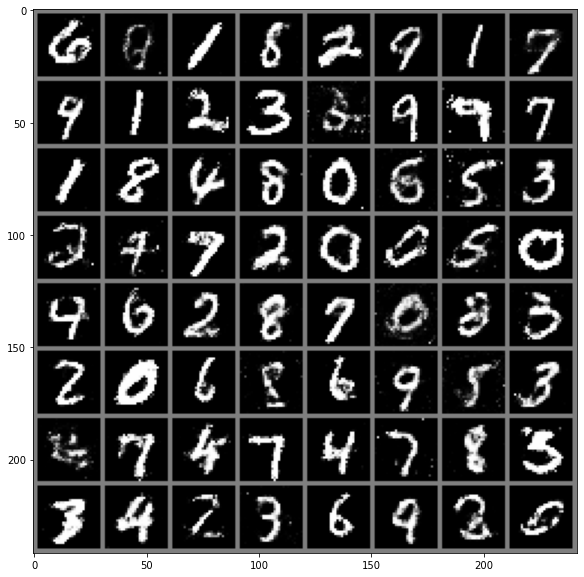

[Epoch 148/200] [Batch 361/937] [D loss: 0.654114] [G loss: 0.867170]
[Epoch 148/200] [Batch 461/937] [D loss: 0.657916] [G loss: 0.882302]
[Epoch 148/200] [Batch 561/937] [D loss: 0.631739] [G loss: 0.803709]
[Epoch 148/200] [Batch 661/937] [D loss: 0.648587] [G loss: 0.854889]
[Epoch 148/200] [Batch 761/937] [D loss: 0.677960] [G loss: 0.761603]
[Epoch 148/200] [Batch 861/937] [D loss: 0.599083] [G loss: 0.861290]
[Epoch 149/200] [Batch 24/937] [D loss: 0.668894] [G loss: 0.822806]
[Epoch 149/200] [Batch 124/937] [D loss: 0.606377] [G loss: 0.954936]
[Epoch 149/200] [Batch 224/937] [D loss: 0.668814] [G loss: 0.870285]
[Epoch 149/200] [Batch 324/937] [D loss: 0.624355] [G loss: 0.900516]
[Epoch 149/200] [Batch 424/937] [D loss: 0.638432] [G loss: 0.846344]
[Epoch 149/200] [Batch 524/937] [D loss: 0.657308] [G loss: 0.813724]
[Epoch 149/200] [Batch 624/937] [D loss: 0.647555] [G loss: 0.846440]
[Epoch 149/200] [Batch 724/937] [D loss: 0.654912] [G loss: 0.787212]
[Epoch 149/200] [Batc

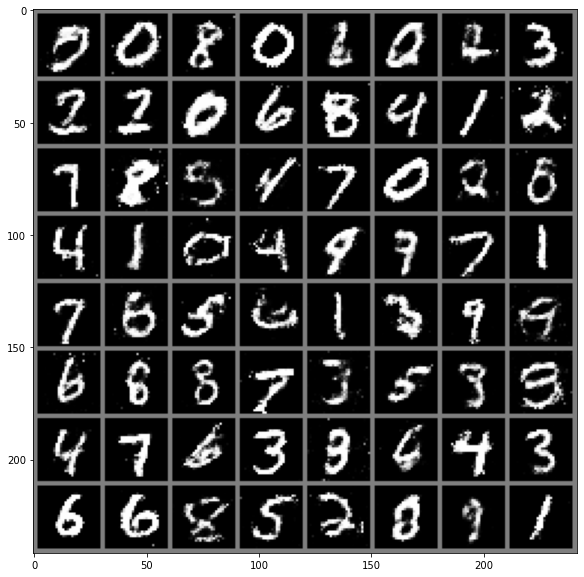

[Epoch 150/200] [Batch 487/937] [D loss: 0.661448] [G loss: 0.842274]
[Epoch 150/200] [Batch 587/937] [D loss: 0.644776] [G loss: 0.780781]
[Epoch 150/200] [Batch 687/937] [D loss: 0.605471] [G loss: 0.897192]
[Epoch 150/200] [Batch 787/937] [D loss: 0.639230] [G loss: 0.722634]
[Epoch 150/200] [Batch 887/937] [D loss: 0.650426] [G loss: 0.831929]
[Epoch 151/200] [Batch 50/937] [D loss: 0.647141] [G loss: 0.939068]
[Epoch 151/200] [Batch 150/937] [D loss: 0.646049] [G loss: 0.868686]
[Epoch 151/200] [Batch 250/937] [D loss: 0.643031] [G loss: 0.868194]
[Epoch 151/200] [Batch 350/937] [D loss: 0.650114] [G loss: 0.828174]
[Epoch 151/200] [Batch 450/937] [D loss: 0.610938] [G loss: 0.808185]
[Epoch 151/200] [Batch 550/937] [D loss: 0.590902] [G loss: 0.832429]
[Epoch 151/200] [Batch 650/937] [D loss: 0.645315] [G loss: 0.828268]
[Epoch 151/200] [Batch 750/937] [D loss: 0.596180] [G loss: 0.901326]
[Epoch 151/200] [Batch 850/937] [D loss: 0.631880] [G loss: 0.831196]
[Epoch 152/200] [Batc

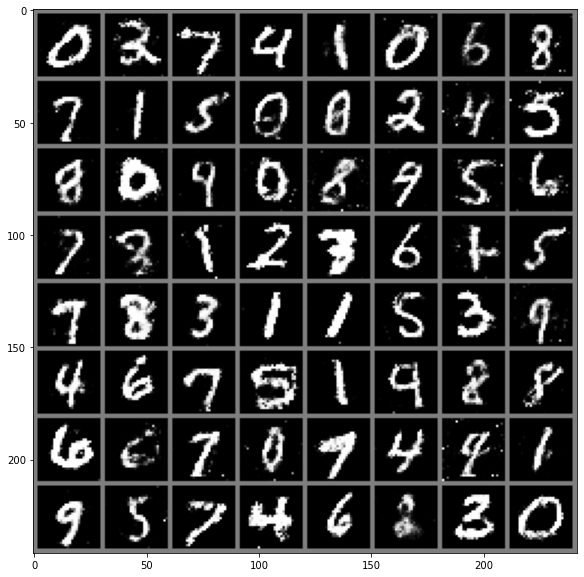

[Epoch 152/200] [Batch 613/937] [D loss: 0.605612] [G loss: 0.877390]
[Epoch 152/200] [Batch 713/937] [D loss: 0.657426] [G loss: 0.844586]
[Epoch 152/200] [Batch 813/937] [D loss: 0.626874] [G loss: 0.933613]
[Epoch 152/200] [Batch 913/937] [D loss: 0.608171] [G loss: 0.908490]
[Epoch 153/200] [Batch 76/937] [D loss: 0.618672] [G loss: 0.861212]
[Epoch 153/200] [Batch 176/937] [D loss: 0.640975] [G loss: 0.845723]
[Epoch 153/200] [Batch 276/937] [D loss: 0.602859] [G loss: 0.811570]
[Epoch 153/200] [Batch 376/937] [D loss: 0.636321] [G loss: 0.831098]
[Epoch 153/200] [Batch 476/937] [D loss: 0.661807] [G loss: 0.898096]
[Epoch 153/200] [Batch 576/937] [D loss: 0.653086] [G loss: 0.796225]
[Epoch 153/200] [Batch 676/937] [D loss: 0.645529] [G loss: 0.899204]
[Epoch 153/200] [Batch 776/937] [D loss: 0.690857] [G loss: 0.828135]
[Epoch 153/200] [Batch 876/937] [D loss: 0.684758] [G loss: 0.781822]
[Epoch 154/200] [Batch 39/937] [D loss: 0.615966] [G loss: 0.922193]
[Epoch 154/200] [Batch

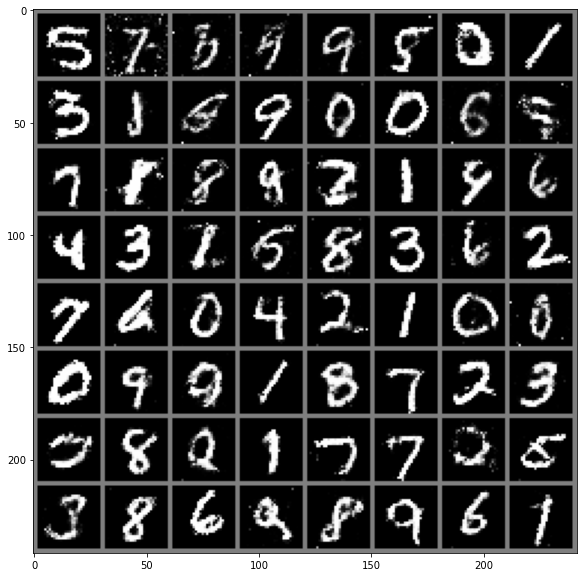

[Epoch 154/200] [Batch 739/937] [D loss: 0.636812] [G loss: 0.923305]
[Epoch 154/200] [Batch 839/937] [D loss: 0.635517] [G loss: 0.860340]
[Epoch 155/200] [Batch 2/937] [D loss: 0.635485] [G loss: 0.838744]
[Epoch 155/200] [Batch 102/937] [D loss: 0.648150] [G loss: 0.806733]
[Epoch 155/200] [Batch 202/937] [D loss: 0.637558] [G loss: 0.870387]
[Epoch 155/200] [Batch 302/937] [D loss: 0.648708] [G loss: 0.890204]
[Epoch 155/200] [Batch 402/937] [D loss: 0.646675] [G loss: 0.850606]
[Epoch 155/200] [Batch 502/937] [D loss: 0.678900] [G loss: 0.829212]
[Epoch 155/200] [Batch 602/937] [D loss: 0.638928] [G loss: 0.835900]
[Epoch 155/200] [Batch 702/937] [D loss: 0.688401] [G loss: 0.761210]
[Epoch 155/200] [Batch 802/937] [D loss: 0.646176] [G loss: 0.820522]
[Epoch 155/200] [Batch 902/937] [D loss: 0.664863] [G loss: 0.791371]
[Epoch 156/200] [Batch 65/937] [D loss: 0.678466] [G loss: 0.759184]
[Epoch 156/200] [Batch 165/937] [D loss: 0.612713] [G loss: 0.867501]
[Epoch 156/200] [Batch 

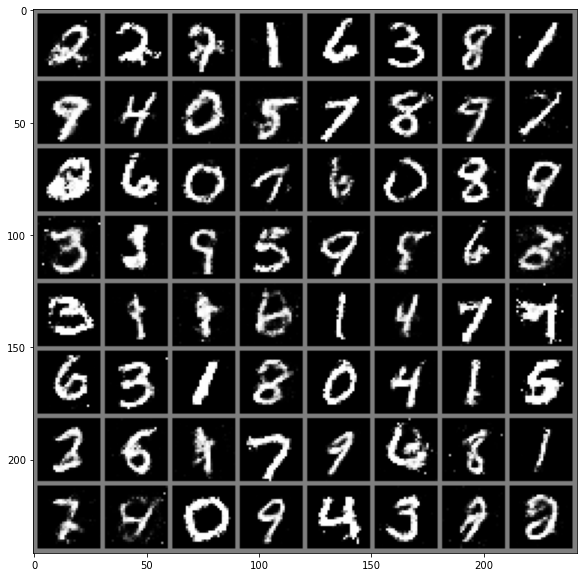

[Epoch 156/200] [Batch 865/937] [D loss: 0.670598] [G loss: 0.802898]
[Epoch 157/200] [Batch 28/937] [D loss: 0.646943] [G loss: 0.925510]
[Epoch 157/200] [Batch 128/937] [D loss: 0.706788] [G loss: 0.847098]
[Epoch 157/200] [Batch 228/937] [D loss: 0.679202] [G loss: 0.781173]
[Epoch 157/200] [Batch 328/937] [D loss: 0.627508] [G loss: 0.801641]
[Epoch 157/200] [Batch 428/937] [D loss: 0.678872] [G loss: 0.789988]
[Epoch 157/200] [Batch 528/937] [D loss: 0.665089] [G loss: 0.905263]
[Epoch 157/200] [Batch 628/937] [D loss: 0.663231] [G loss: 0.834141]
[Epoch 157/200] [Batch 728/937] [D loss: 0.655415] [G loss: 0.809653]
[Epoch 157/200] [Batch 828/937] [D loss: 0.643166] [G loss: 0.783946]
[Epoch 157/200] [Batch 928/937] [D loss: 0.629715] [G loss: 0.825949]
[Epoch 158/200] [Batch 91/937] [D loss: 0.642246] [G loss: 0.776777]
[Epoch 158/200] [Batch 191/937] [D loss: 0.641725] [G loss: 0.926434]
[Epoch 158/200] [Batch 291/937] [D loss: 0.659858] [G loss: 0.868285]
[Epoch 158/200] [Batch

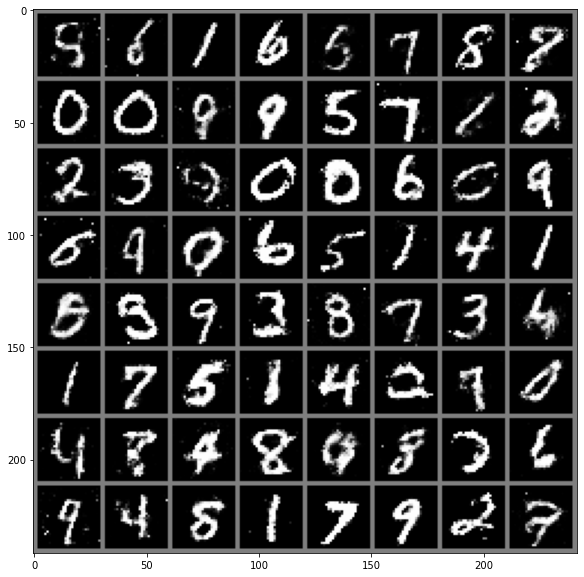

[Epoch 159/200] [Batch 54/937] [D loss: 0.641514] [G loss: 0.918255]
[Epoch 159/200] [Batch 154/937] [D loss: 0.642299] [G loss: 0.935821]
[Epoch 159/200] [Batch 254/937] [D loss: 0.647579] [G loss: 0.922409]
[Epoch 159/200] [Batch 354/937] [D loss: 0.687993] [G loss: 0.823820]
[Epoch 159/200] [Batch 454/937] [D loss: 0.655442] [G loss: 0.864773]
[Epoch 159/200] [Batch 554/937] [D loss: 0.631105] [G loss: 0.981483]
[Epoch 159/200] [Batch 654/937] [D loss: 0.674318] [G loss: 0.837752]
[Epoch 159/200] [Batch 754/937] [D loss: 0.627213] [G loss: 0.822576]
[Epoch 159/200] [Batch 854/937] [D loss: 0.671124] [G loss: 0.892258]
[Epoch 160/200] [Batch 17/937] [D loss: 0.677039] [G loss: 0.755281]
[Epoch 160/200] [Batch 117/937] [D loss: 0.649283] [G loss: 0.879679]
[Epoch 160/200] [Batch 217/937] [D loss: 0.667530] [G loss: 0.847647]
[Epoch 160/200] [Batch 317/937] [D loss: 0.665637] [G loss: 0.771461]
[Epoch 160/200] [Batch 417/937] [D loss: 0.688284] [G loss: 0.820212]
[Epoch 160/200] [Batch

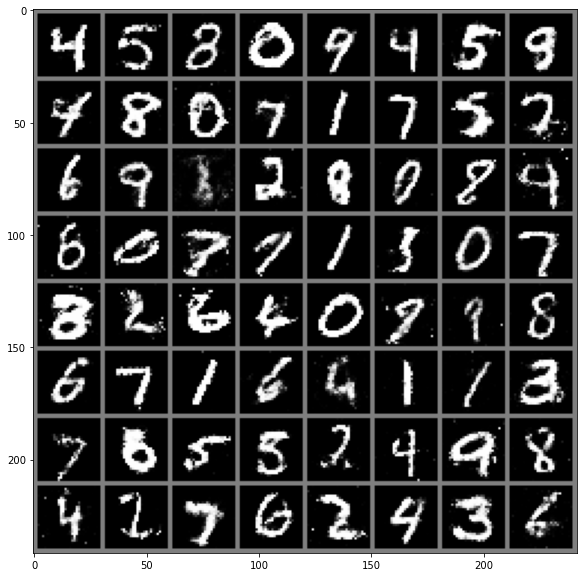

[Epoch 161/200] [Batch 180/937] [D loss: 0.601470] [G loss: 0.821576]
[Epoch 161/200] [Batch 280/937] [D loss: 0.658816] [G loss: 0.866287]
[Epoch 161/200] [Batch 380/937] [D loss: 0.651902] [G loss: 0.832877]
[Epoch 161/200] [Batch 480/937] [D loss: 0.669097] [G loss: 0.884109]
[Epoch 161/200] [Batch 580/937] [D loss: 0.641327] [G loss: 0.757055]
[Epoch 161/200] [Batch 680/937] [D loss: 0.672267] [G loss: 0.810328]
[Epoch 161/200] [Batch 780/937] [D loss: 0.636658] [G loss: 0.848431]
[Epoch 161/200] [Batch 880/937] [D loss: 0.645802] [G loss: 0.818588]
[Epoch 162/200] [Batch 43/937] [D loss: 0.628977] [G loss: 0.836207]
[Epoch 162/200] [Batch 143/937] [D loss: 0.679915] [G loss: 0.864207]
[Epoch 162/200] [Batch 243/937] [D loss: 0.646425] [G loss: 0.850695]
[Epoch 162/200] [Batch 343/937] [D loss: 0.642704] [G loss: 0.834157]
[Epoch 162/200] [Batch 443/937] [D loss: 0.643361] [G loss: 0.833604]
[Epoch 162/200] [Batch 543/937] [D loss: 0.611516] [G loss: 0.784939]
[Epoch 162/200] [Batc

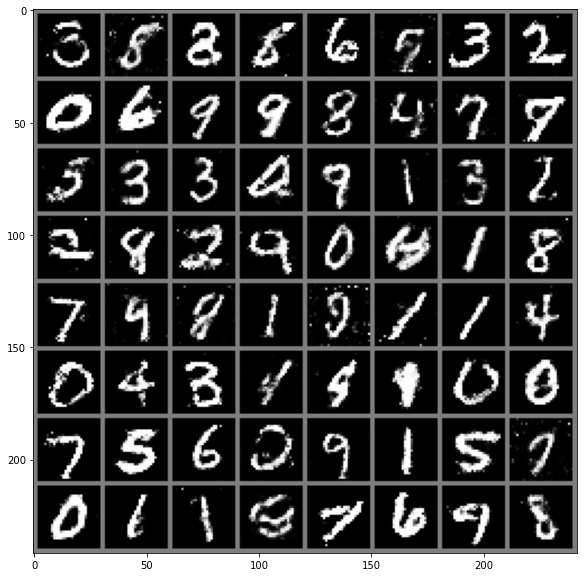

[Epoch 163/200] [Batch 306/937] [D loss: 0.624752] [G loss: 0.970363]
[Epoch 163/200] [Batch 406/937] [D loss: 0.660679] [G loss: 0.780925]
[Epoch 163/200] [Batch 506/937] [D loss: 0.675842] [G loss: 0.831089]
[Epoch 163/200] [Batch 606/937] [D loss: 0.663766] [G loss: 0.778668]
[Epoch 163/200] [Batch 706/937] [D loss: 0.636167] [G loss: 0.834986]
[Epoch 163/200] [Batch 806/937] [D loss: 0.652404] [G loss: 0.803934]
[Epoch 163/200] [Batch 906/937] [D loss: 0.622953] [G loss: 0.802116]
[Epoch 164/200] [Batch 69/937] [D loss: 0.647974] [G loss: 0.918519]
[Epoch 164/200] [Batch 169/937] [D loss: 0.604681] [G loss: 0.847694]
[Epoch 164/200] [Batch 269/937] [D loss: 0.633057] [G loss: 0.827805]
[Epoch 164/200] [Batch 369/937] [D loss: 0.625215] [G loss: 0.873106]
[Epoch 164/200] [Batch 469/937] [D loss: 0.658514] [G loss: 0.863008]
[Epoch 164/200] [Batch 569/937] [D loss: 0.616516] [G loss: 0.912127]
[Epoch 164/200] [Batch 669/937] [D loss: 0.614825] [G loss: 0.819803]
[Epoch 164/200] [Batc

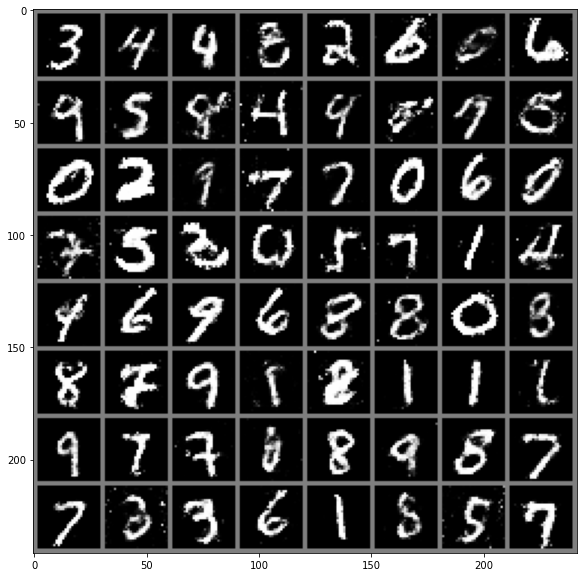

[Epoch 165/200] [Batch 432/937] [D loss: 0.644409] [G loss: 0.842377]
[Epoch 165/200] [Batch 532/937] [D loss: 0.662020] [G loss: 0.838591]
[Epoch 165/200] [Batch 632/937] [D loss: 0.619923] [G loss: 0.818884]
[Epoch 165/200] [Batch 732/937] [D loss: 0.658300] [G loss: 0.833328]
[Epoch 165/200] [Batch 832/937] [D loss: 0.612009] [G loss: 0.816722]
[Epoch 165/200] [Batch 932/937] [D loss: 0.661674] [G loss: 0.880832]
[Epoch 166/200] [Batch 95/937] [D loss: 0.677686] [G loss: 0.850800]
[Epoch 166/200] [Batch 195/937] [D loss: 0.651586] [G loss: 0.759369]
[Epoch 166/200] [Batch 295/937] [D loss: 0.633749] [G loss: 0.834650]
[Epoch 166/200] [Batch 395/937] [D loss: 0.657402] [G loss: 0.866174]
[Epoch 166/200] [Batch 495/937] [D loss: 0.649659] [G loss: 0.873881]
[Epoch 166/200] [Batch 595/937] [D loss: 0.649801] [G loss: 0.741775]
[Epoch 166/200] [Batch 695/937] [D loss: 0.606349] [G loss: 0.960055]
[Epoch 166/200] [Batch 795/937] [D loss: 0.637687] [G loss: 0.853446]
[Epoch 166/200] [Batc

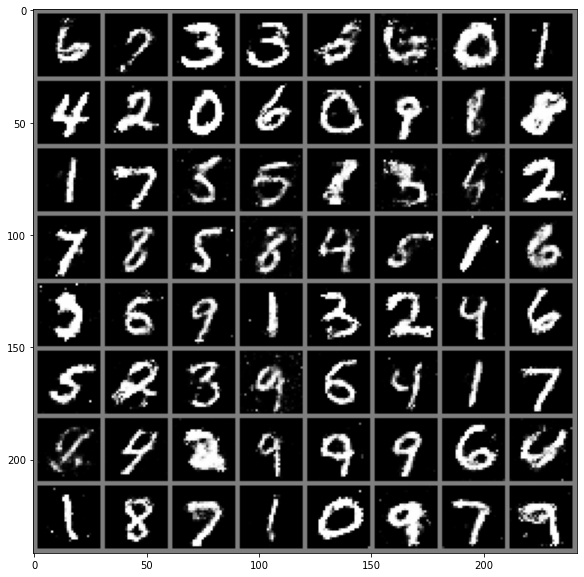

[Epoch 167/200] [Batch 558/937] [D loss: 0.659265] [G loss: 0.890405]
[Epoch 167/200] [Batch 658/937] [D loss: 0.701907] [G loss: 0.765041]
[Epoch 167/200] [Batch 758/937] [D loss: 0.655898] [G loss: 0.889578]
[Epoch 167/200] [Batch 858/937] [D loss: 0.647735] [G loss: 0.854494]
[Epoch 168/200] [Batch 21/937] [D loss: 0.658035] [G loss: 0.896834]
[Epoch 168/200] [Batch 121/937] [D loss: 0.641227] [G loss: 0.850519]
[Epoch 168/200] [Batch 221/937] [D loss: 0.652478] [G loss: 0.776358]
[Epoch 168/200] [Batch 321/937] [D loss: 0.650541] [G loss: 0.873751]
[Epoch 168/200] [Batch 421/937] [D loss: 0.654506] [G loss: 0.885819]
[Epoch 168/200] [Batch 521/937] [D loss: 0.630147] [G loss: 0.931138]
[Epoch 168/200] [Batch 621/937] [D loss: 0.638971] [G loss: 0.847060]
[Epoch 168/200] [Batch 721/937] [D loss: 0.654943] [G loss: 0.914651]
[Epoch 168/200] [Batch 821/937] [D loss: 0.614567] [G loss: 0.863933]
[Epoch 168/200] [Batch 921/937] [D loss: 0.620272] [G loss: 0.881792]
[Epoch 169/200] [Batc

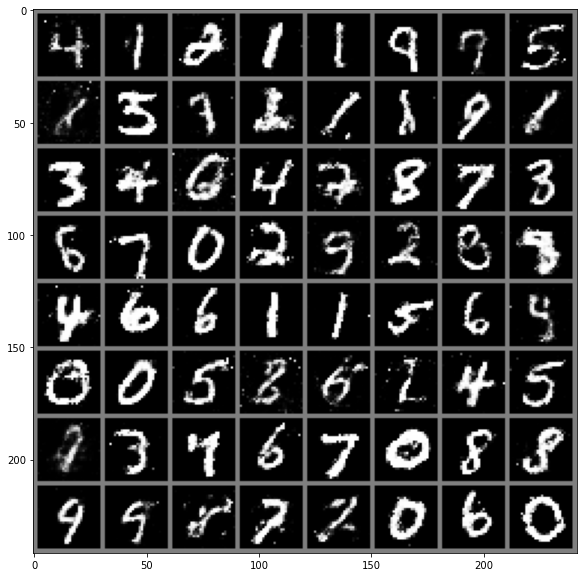

[Epoch 169/200] [Batch 684/937] [D loss: 0.660354] [G loss: 0.821918]
[Epoch 169/200] [Batch 784/937] [D loss: 0.653134] [G loss: 0.812951]
[Epoch 169/200] [Batch 884/937] [D loss: 0.653098] [G loss: 0.842291]
[Epoch 170/200] [Batch 47/937] [D loss: 0.634323] [G loss: 0.894392]
[Epoch 170/200] [Batch 147/937] [D loss: 0.595978] [G loss: 0.858557]
[Epoch 170/200] [Batch 247/937] [D loss: 0.622530] [G loss: 0.833986]
[Epoch 170/200] [Batch 347/937] [D loss: 0.633084] [G loss: 0.915573]
[Epoch 170/200] [Batch 447/937] [D loss: 0.668738] [G loss: 0.756374]
[Epoch 170/200] [Batch 547/937] [D loss: 0.657509] [G loss: 0.836677]
[Epoch 170/200] [Batch 647/937] [D loss: 0.657894] [G loss: 0.974127]
[Epoch 170/200] [Batch 747/937] [D loss: 0.627939] [G loss: 0.829227]
[Epoch 170/200] [Batch 847/937] [D loss: 0.655107] [G loss: 0.892063]
[Epoch 171/200] [Batch 10/937] [D loss: 0.666919] [G loss: 0.824337]
[Epoch 171/200] [Batch 110/937] [D loss: 0.665159] [G loss: 0.793295]
[Epoch 171/200] [Batch

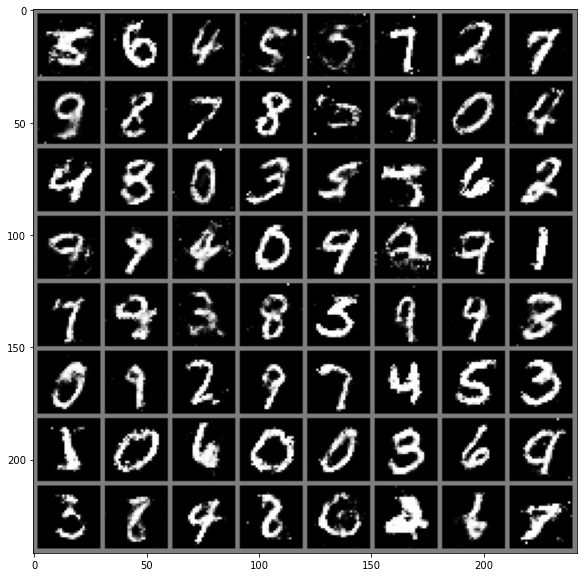

[Epoch 171/200] [Batch 810/937] [D loss: 0.663671] [G loss: 0.817417]
[Epoch 171/200] [Batch 910/937] [D loss: 0.601376] [G loss: 0.840838]
[Epoch 172/200] [Batch 73/937] [D loss: 0.647736] [G loss: 0.768854]
[Epoch 172/200] [Batch 173/937] [D loss: 0.645822] [G loss: 0.914311]
[Epoch 172/200] [Batch 273/937] [D loss: 0.612541] [G loss: 0.815779]
[Epoch 172/200] [Batch 373/937] [D loss: 0.629275] [G loss: 0.873465]
[Epoch 172/200] [Batch 473/937] [D loss: 0.638714] [G loss: 0.878340]
[Epoch 172/200] [Batch 573/937] [D loss: 0.640212] [G loss: 0.797040]
[Epoch 172/200] [Batch 673/937] [D loss: 0.644018] [G loss: 0.819509]
[Epoch 172/200] [Batch 773/937] [D loss: 0.616162] [G loss: 0.883193]
[Epoch 172/200] [Batch 873/937] [D loss: 0.611932] [G loss: 0.814332]
[Epoch 173/200] [Batch 36/937] [D loss: 0.617372] [G loss: 0.783257]
[Epoch 173/200] [Batch 136/937] [D loss: 0.686257] [G loss: 0.899111]
[Epoch 173/200] [Batch 236/937] [D loss: 0.653528] [G loss: 0.825780]
[Epoch 173/200] [Batch

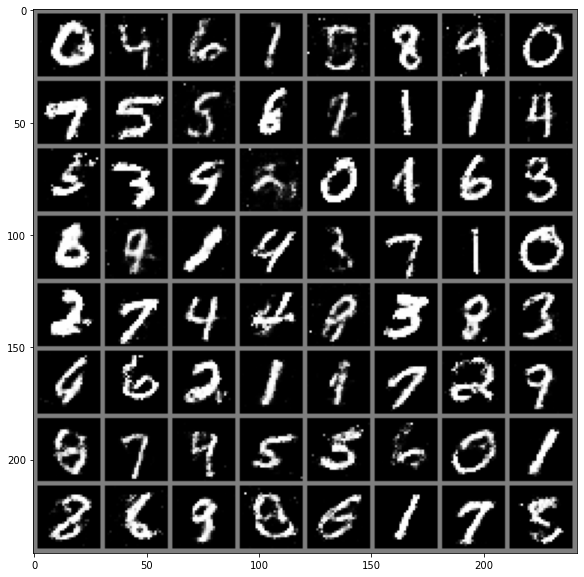

[Epoch 173/200] [Batch 936/937] [D loss: 0.696070] [G loss: 0.775697]
[Epoch 174/200] [Batch 99/937] [D loss: 0.688016] [G loss: 0.919025]
[Epoch 174/200] [Batch 199/937] [D loss: 0.665843] [G loss: 0.744504]
[Epoch 174/200] [Batch 299/937] [D loss: 0.654093] [G loss: 0.856567]
[Epoch 174/200] [Batch 399/937] [D loss: 0.638409] [G loss: 0.751018]
[Epoch 174/200] [Batch 499/937] [D loss: 0.652748] [G loss: 0.762728]
[Epoch 174/200] [Batch 599/937] [D loss: 0.680500] [G loss: 0.801647]
[Epoch 174/200] [Batch 699/937] [D loss: 0.675277] [G loss: 0.843503]
[Epoch 174/200] [Batch 799/937] [D loss: 0.714367] [G loss: 0.775591]
[Epoch 174/200] [Batch 899/937] [D loss: 0.686072] [G loss: 0.867746]
[Epoch 175/200] [Batch 62/937] [D loss: 0.661700] [G loss: 0.833649]
[Epoch 175/200] [Batch 162/937] [D loss: 0.635115] [G loss: 0.889540]
[Epoch 175/200] [Batch 262/937] [D loss: 0.690039] [G loss: 0.776687]
[Epoch 175/200] [Batch 362/937] [D loss: 0.594947] [G loss: 0.742770]
[Epoch 175/200] [Batch

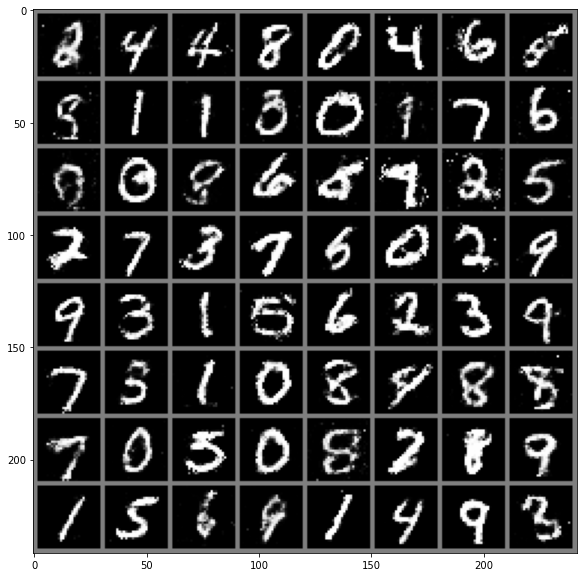

[Epoch 176/200] [Batch 125/937] [D loss: 0.608246] [G loss: 0.906412]
[Epoch 176/200] [Batch 225/937] [D loss: 0.642415] [G loss: 0.836179]
[Epoch 176/200] [Batch 325/937] [D loss: 0.661013] [G loss: 0.803736]
[Epoch 176/200] [Batch 425/937] [D loss: 0.600500] [G loss: 0.809899]
[Epoch 176/200] [Batch 525/937] [D loss: 0.647040] [G loss: 0.864219]
[Epoch 176/200] [Batch 625/937] [D loss: 0.655510] [G loss: 0.812748]
[Epoch 176/200] [Batch 725/937] [D loss: 0.644500] [G loss: 0.890363]
[Epoch 176/200] [Batch 825/937] [D loss: 0.664512] [G loss: 0.841533]
[Epoch 176/200] [Batch 925/937] [D loss: 0.637527] [G loss: 0.767708]
[Epoch 177/200] [Batch 88/937] [D loss: 0.631961] [G loss: 0.884831]
[Epoch 177/200] [Batch 188/937] [D loss: 0.613471] [G loss: 0.815583]
[Epoch 177/200] [Batch 288/937] [D loss: 0.642929] [G loss: 0.853175]
[Epoch 177/200] [Batch 388/937] [D loss: 0.643897] [G loss: 0.749799]
[Epoch 177/200] [Batch 488/937] [D loss: 0.635249] [G loss: 0.789604]
[Epoch 177/200] [Batc

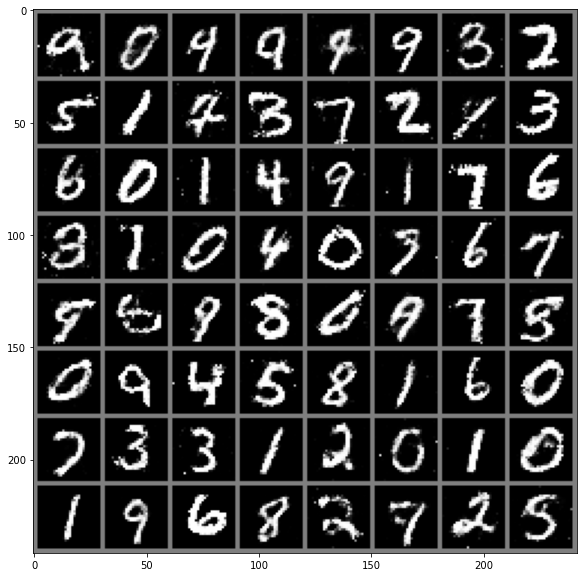

[Epoch 178/200] [Batch 251/937] [D loss: 0.626914] [G loss: 0.884139]
[Epoch 178/200] [Batch 351/937] [D loss: 0.610862] [G loss: 0.865438]
[Epoch 178/200] [Batch 451/937] [D loss: 0.679815] [G loss: 0.839472]
[Epoch 178/200] [Batch 551/937] [D loss: 0.625206] [G loss: 0.884715]
[Epoch 178/200] [Batch 651/937] [D loss: 0.634808] [G loss: 0.853216]
[Epoch 178/200] [Batch 751/937] [D loss: 0.664579] [G loss: 0.876385]
[Epoch 178/200] [Batch 851/937] [D loss: 0.630504] [G loss: 0.835418]
[Epoch 179/200] [Batch 14/937] [D loss: 0.631572] [G loss: 0.907965]
[Epoch 179/200] [Batch 114/937] [D loss: 0.632466] [G loss: 0.797198]
[Epoch 179/200] [Batch 214/937] [D loss: 0.658962] [G loss: 0.862502]
[Epoch 179/200] [Batch 314/937] [D loss: 0.639494] [G loss: 0.759042]
[Epoch 179/200] [Batch 414/937] [D loss: 0.645295] [G loss: 0.832141]
[Epoch 179/200] [Batch 514/937] [D loss: 0.682249] [G loss: 0.860442]
[Epoch 179/200] [Batch 614/937] [D loss: 0.632591] [G loss: 0.898665]
[Epoch 179/200] [Batc

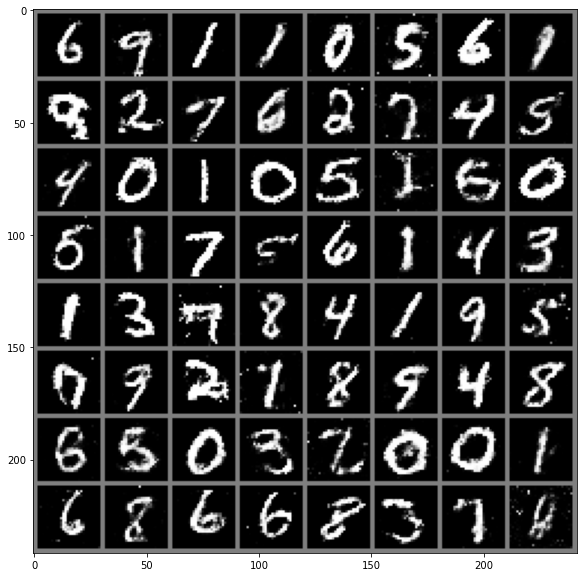

[Epoch 180/200] [Batch 377/937] [D loss: 0.651210] [G loss: 0.847267]
[Epoch 180/200] [Batch 477/937] [D loss: 0.592786] [G loss: 0.785750]
[Epoch 180/200] [Batch 577/937] [D loss: 0.642379] [G loss: 0.812924]
[Epoch 180/200] [Batch 677/937] [D loss: 0.647908] [G loss: 0.827112]
[Epoch 180/200] [Batch 777/937] [D loss: 0.649481] [G loss: 0.840110]
[Epoch 180/200] [Batch 877/937] [D loss: 0.598128] [G loss: 0.860035]
[Epoch 181/200] [Batch 40/937] [D loss: 0.645907] [G loss: 0.823925]
[Epoch 181/200] [Batch 140/937] [D loss: 0.648642] [G loss: 0.733433]
[Epoch 181/200] [Batch 240/937] [D loss: 0.656872] [G loss: 0.916299]
[Epoch 181/200] [Batch 340/937] [D loss: 0.665582] [G loss: 0.874542]
[Epoch 181/200] [Batch 440/937] [D loss: 0.643307] [G loss: 0.791099]
[Epoch 181/200] [Batch 540/937] [D loss: 0.673521] [G loss: 0.790649]
[Epoch 181/200] [Batch 640/937] [D loss: 0.624246] [G loss: 0.788378]
[Epoch 181/200] [Batch 740/937] [D loss: 0.645047] [G loss: 0.842734]
[Epoch 181/200] [Batc

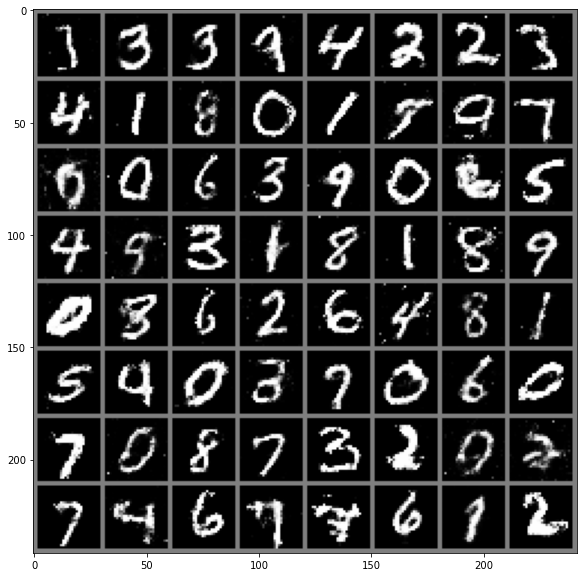

[Epoch 182/200] [Batch 503/937] [D loss: 0.699910] [G loss: 0.797869]
[Epoch 182/200] [Batch 603/937] [D loss: 0.613109] [G loss: 0.881320]
[Epoch 182/200] [Batch 703/937] [D loss: 0.630753] [G loss: 0.855524]
[Epoch 182/200] [Batch 803/937] [D loss: 0.675221] [G loss: 0.877386]
[Epoch 182/200] [Batch 903/937] [D loss: 0.650095] [G loss: 0.945682]
[Epoch 183/200] [Batch 66/937] [D loss: 0.596346] [G loss: 0.875258]
[Epoch 183/200] [Batch 166/937] [D loss: 0.630538] [G loss: 0.891775]
[Epoch 183/200] [Batch 266/937] [D loss: 0.662832] [G loss: 0.851161]
[Epoch 183/200] [Batch 366/937] [D loss: 0.651860] [G loss: 0.894417]
[Epoch 183/200] [Batch 466/937] [D loss: 0.632243] [G loss: 0.884138]
[Epoch 183/200] [Batch 566/937] [D loss: 0.641235] [G loss: 0.841084]
[Epoch 183/200] [Batch 666/937] [D loss: 0.666591] [G loss: 0.950891]
[Epoch 183/200] [Batch 766/937] [D loss: 0.673443] [G loss: 0.855013]
[Epoch 183/200] [Batch 866/937] [D loss: 0.628385] [G loss: 0.875534]
[Epoch 184/200] [Batc

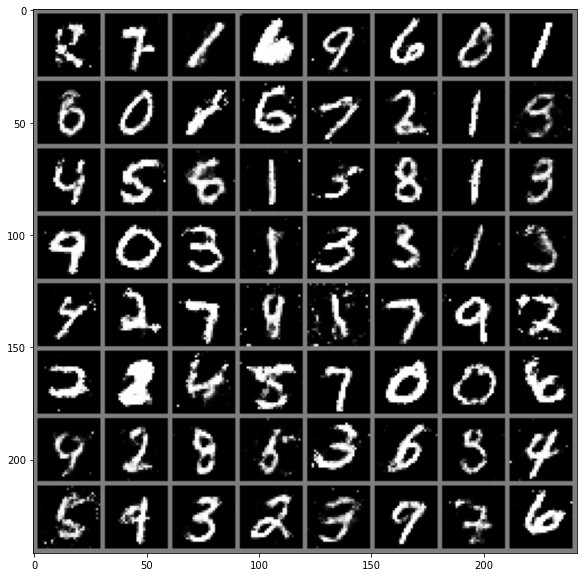

[Epoch 184/200] [Batch 629/937] [D loss: 0.660357] [G loss: 0.849634]
[Epoch 184/200] [Batch 729/937] [D loss: 0.645156] [G loss: 0.895363]
[Epoch 184/200] [Batch 829/937] [D loss: 0.642262] [G loss: 0.800819]
[Epoch 184/200] [Batch 929/937] [D loss: 0.682326] [G loss: 0.921118]
[Epoch 185/200] [Batch 92/937] [D loss: 0.633379] [G loss: 0.875715]
[Epoch 185/200] [Batch 192/937] [D loss: 0.620774] [G loss: 0.850952]
[Epoch 185/200] [Batch 292/937] [D loss: 0.633519] [G loss: 0.840136]
[Epoch 185/200] [Batch 392/937] [D loss: 0.655744] [G loss: 0.800001]
[Epoch 185/200] [Batch 492/937] [D loss: 0.662937] [G loss: 0.906001]
[Epoch 185/200] [Batch 592/937] [D loss: 0.644231] [G loss: 0.844649]
[Epoch 185/200] [Batch 692/937] [D loss: 0.611104] [G loss: 0.980037]
[Epoch 185/200] [Batch 792/937] [D loss: 0.658296] [G loss: 0.895795]
[Epoch 185/200] [Batch 892/937] [D loss: 0.678390] [G loss: 0.816445]
[Epoch 186/200] [Batch 55/937] [D loss: 0.713557] [G loss: 0.894556]
[Epoch 186/200] [Batch

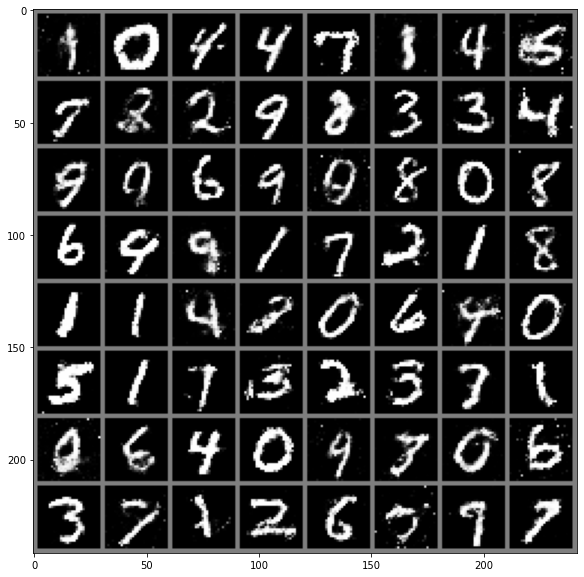

[Epoch 186/200] [Batch 755/937] [D loss: 0.617551] [G loss: 0.835692]
[Epoch 186/200] [Batch 855/937] [D loss: 0.641488] [G loss: 0.806983]
[Epoch 187/200] [Batch 18/937] [D loss: 0.646402] [G loss: 0.908290]
[Epoch 187/200] [Batch 118/937] [D loss: 0.634123] [G loss: 0.841479]
[Epoch 187/200] [Batch 218/937] [D loss: 0.649187] [G loss: 0.763251]
[Epoch 187/200] [Batch 318/937] [D loss: 0.641737] [G loss: 0.824000]
[Epoch 187/200] [Batch 418/937] [D loss: 0.653856] [G loss: 0.814162]
[Epoch 187/200] [Batch 518/937] [D loss: 0.638386] [G loss: 0.945024]
[Epoch 187/200] [Batch 618/937] [D loss: 0.669330] [G loss: 0.824457]
[Epoch 187/200] [Batch 718/937] [D loss: 0.651479] [G loss: 0.882115]
[Epoch 187/200] [Batch 818/937] [D loss: 0.647946] [G loss: 0.850396]
[Epoch 187/200] [Batch 918/937] [D loss: 0.647264] [G loss: 0.789578]
[Epoch 188/200] [Batch 81/937] [D loss: 0.685546] [G loss: 0.802831]
[Epoch 188/200] [Batch 181/937] [D loss: 0.616652] [G loss: 0.779924]
[Epoch 188/200] [Batch

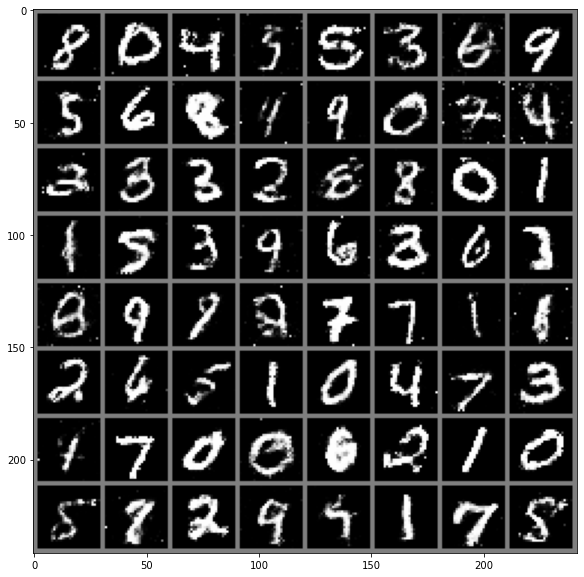

[Epoch 188/200] [Batch 881/937] [D loss: 0.622670] [G loss: 0.771467]
[Epoch 189/200] [Batch 44/937] [D loss: 0.666255] [G loss: 0.725846]
[Epoch 189/200] [Batch 144/937] [D loss: 0.630570] [G loss: 0.826562]
[Epoch 189/200] [Batch 244/937] [D loss: 0.609588] [G loss: 0.916966]
[Epoch 189/200] [Batch 344/937] [D loss: 0.664365] [G loss: 0.870797]
[Epoch 189/200] [Batch 444/937] [D loss: 0.604479] [G loss: 0.933744]
[Epoch 189/200] [Batch 544/937] [D loss: 0.656870] [G loss: 0.874469]
[Epoch 189/200] [Batch 644/937] [D loss: 0.684871] [G loss: 0.925802]
[Epoch 189/200] [Batch 744/937] [D loss: 0.681513] [G loss: 0.880159]
[Epoch 189/200] [Batch 844/937] [D loss: 0.605552] [G loss: 0.880610]
[Epoch 190/200] [Batch 7/937] [D loss: 0.658118] [G loss: 0.896740]
[Epoch 190/200] [Batch 107/937] [D loss: 0.597084] [G loss: 0.863221]
[Epoch 190/200] [Batch 207/937] [D loss: 0.616003] [G loss: 0.898411]
[Epoch 190/200] [Batch 307/937] [D loss: 0.660284] [G loss: 0.850881]
[Epoch 190/200] [Batch 

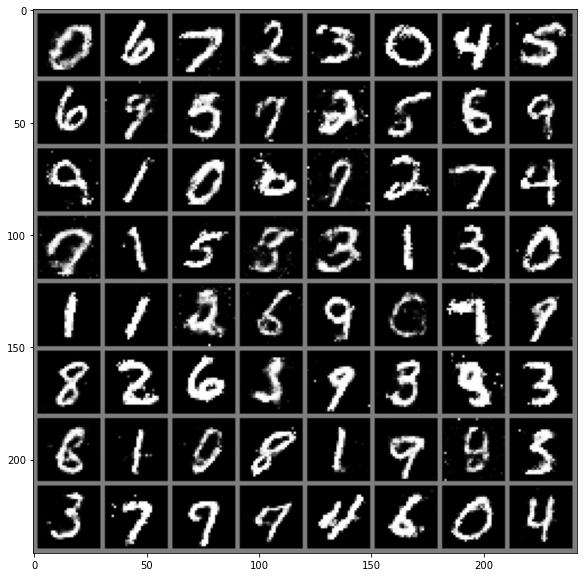

[Epoch 191/200] [Batch 70/937] [D loss: 0.643807] [G loss: 0.817631]
[Epoch 191/200] [Batch 170/937] [D loss: 0.676757] [G loss: 0.837249]
[Epoch 191/200] [Batch 270/937] [D loss: 0.628143] [G loss: 0.825031]
[Epoch 191/200] [Batch 370/937] [D loss: 0.657546] [G loss: 0.815030]
[Epoch 191/200] [Batch 470/937] [D loss: 0.639096] [G loss: 0.817863]
[Epoch 191/200] [Batch 570/937] [D loss: 0.620663] [G loss: 0.779067]
[Epoch 191/200] [Batch 670/937] [D loss: 0.605849] [G loss: 0.889358]
[Epoch 191/200] [Batch 770/937] [D loss: 0.637757] [G loss: 0.788164]
[Epoch 191/200] [Batch 870/937] [D loss: 0.599663] [G loss: 0.820030]
[Epoch 192/200] [Batch 33/937] [D loss: 0.604918] [G loss: 0.889555]
[Epoch 192/200] [Batch 133/937] [D loss: 0.645098] [G loss: 0.862961]
[Epoch 192/200] [Batch 233/937] [D loss: 0.657066] [G loss: 0.950438]
[Epoch 192/200] [Batch 333/937] [D loss: 0.631685] [G loss: 0.938498]
[Epoch 192/200] [Batch 433/937] [D loss: 0.641748] [G loss: 0.859895]
[Epoch 192/200] [Batch

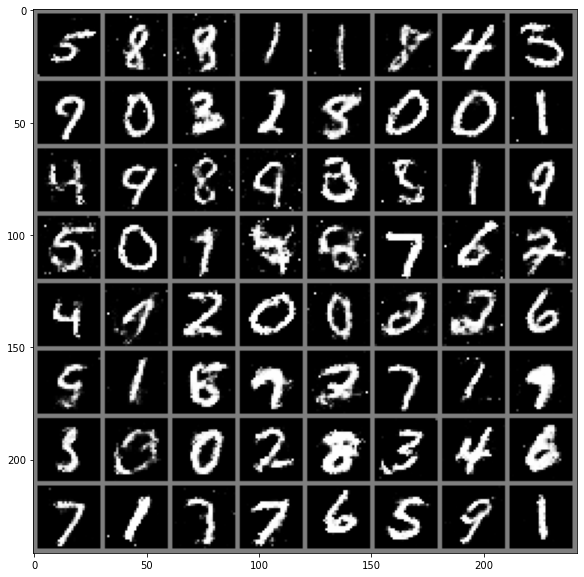

[Epoch 193/200] [Batch 196/937] [D loss: 0.667196] [G loss: 0.878827]
[Epoch 193/200] [Batch 296/937] [D loss: 0.580454] [G loss: 0.871432]
[Epoch 193/200] [Batch 396/937] [D loss: 0.665983] [G loss: 0.797628]
[Epoch 193/200] [Batch 496/937] [D loss: 0.635597] [G loss: 0.931291]
[Epoch 193/200] [Batch 596/937] [D loss: 0.651865] [G loss: 0.839051]
[Epoch 193/200] [Batch 696/937] [D loss: 0.617124] [G loss: 0.914694]
[Epoch 193/200] [Batch 796/937] [D loss: 0.653012] [G loss: 0.876420]
[Epoch 193/200] [Batch 896/937] [D loss: 0.695167] [G loss: 0.849562]
[Epoch 194/200] [Batch 59/937] [D loss: 0.666595] [G loss: 0.810334]
[Epoch 194/200] [Batch 159/937] [D loss: 0.658532] [G loss: 0.871754]
[Epoch 194/200] [Batch 259/937] [D loss: 0.658352] [G loss: 0.886873]
[Epoch 194/200] [Batch 359/937] [D loss: 0.604012] [G loss: 0.848562]
[Epoch 194/200] [Batch 459/937] [D loss: 0.625392] [G loss: 0.899724]
[Epoch 194/200] [Batch 559/937] [D loss: 0.661849] [G loss: 0.842382]
[Epoch 194/200] [Batc

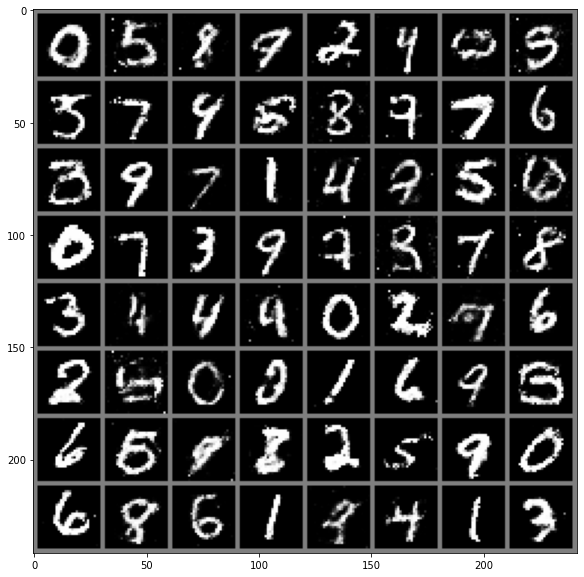

[Epoch 195/200] [Batch 322/937] [D loss: 0.651117] [G loss: 0.770617]
[Epoch 195/200] [Batch 422/937] [D loss: 0.686007] [G loss: 0.825917]
[Epoch 195/200] [Batch 522/937] [D loss: 0.632029] [G loss: 0.831830]
[Epoch 195/200] [Batch 622/937] [D loss: 0.627515] [G loss: 0.905208]
[Epoch 195/200] [Batch 722/937] [D loss: 0.648953] [G loss: 0.800580]
[Epoch 195/200] [Batch 822/937] [D loss: 0.640773] [G loss: 0.840504]
[Epoch 195/200] [Batch 922/937] [D loss: 0.624384] [G loss: 0.798306]
[Epoch 196/200] [Batch 85/937] [D loss: 0.656736] [G loss: 0.867315]
[Epoch 196/200] [Batch 185/937] [D loss: 0.633850] [G loss: 0.920259]
[Epoch 196/200] [Batch 285/937] [D loss: 0.699533] [G loss: 0.852616]
[Epoch 196/200] [Batch 385/937] [D loss: 0.666131] [G loss: 0.937739]
[Epoch 196/200] [Batch 485/937] [D loss: 0.626077] [G loss: 0.829385]
[Epoch 196/200] [Batch 585/937] [D loss: 0.646473] [G loss: 0.772722]
[Epoch 196/200] [Batch 685/937] [D loss: 0.646667] [G loss: 0.800313]
[Epoch 196/200] [Batc

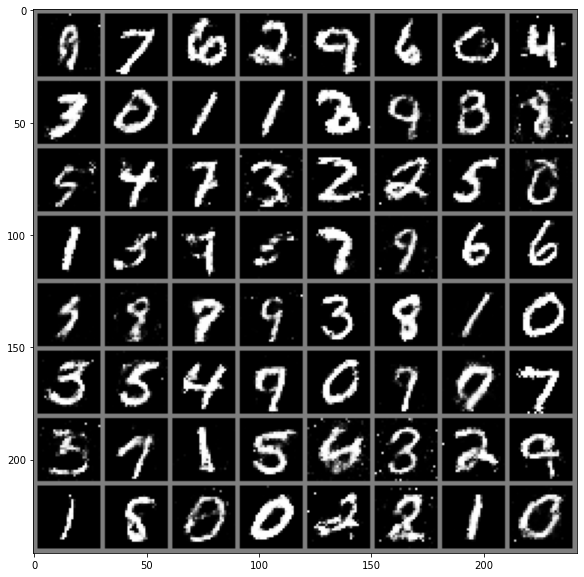

[Epoch 197/200] [Batch 448/937] [D loss: 0.644727] [G loss: 0.782664]
[Epoch 197/200] [Batch 548/937] [D loss: 0.656411] [G loss: 0.813861]
[Epoch 197/200] [Batch 648/937] [D loss: 0.604523] [G loss: 0.780106]
[Epoch 197/200] [Batch 748/937] [D loss: 0.604396] [G loss: 0.862031]
[Epoch 197/200] [Batch 848/937] [D loss: 0.633557] [G loss: 0.870421]
[Epoch 198/200] [Batch 11/937] [D loss: 0.658078] [G loss: 0.860493]
[Epoch 198/200] [Batch 111/937] [D loss: 0.654178] [G loss: 0.816915]
[Epoch 198/200] [Batch 211/937] [D loss: 0.631147] [G loss: 0.828157]
[Epoch 198/200] [Batch 311/937] [D loss: 0.684812] [G loss: 0.907002]
[Epoch 198/200] [Batch 411/937] [D loss: 0.652678] [G loss: 0.804009]
[Epoch 198/200] [Batch 511/937] [D loss: 0.632270] [G loss: 0.877237]
[Epoch 198/200] [Batch 611/937] [D loss: 0.624432] [G loss: 0.840739]
[Epoch 198/200] [Batch 711/937] [D loss: 0.633426] [G loss: 0.717619]
[Epoch 198/200] [Batch 811/937] [D loss: 0.608741] [G loss: 0.959964]
[Epoch 198/200] [Batc

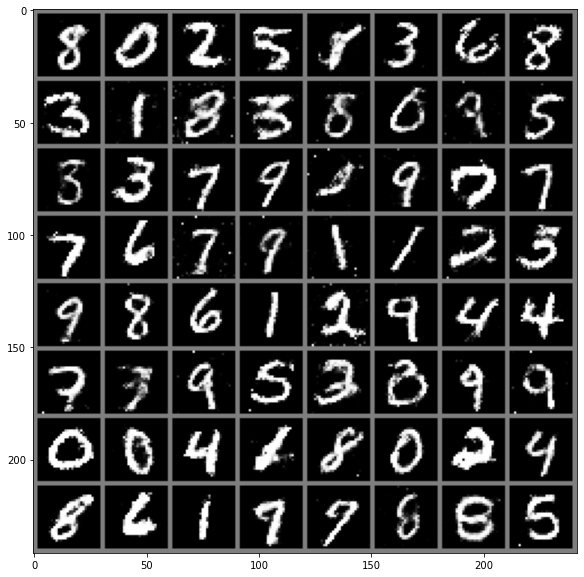

[Epoch 199/200] [Batch 574/937] [D loss: 0.639497] [G loss: 0.844676]
[Epoch 199/200] [Batch 674/937] [D loss: 0.643321] [G loss: 0.927074]
[Epoch 199/200] [Batch 774/937] [D loss: 0.626760] [G loss: 0.889489]
[Epoch 199/200] [Batch 874/937] [D loss: 0.626265] [G loss: 0.840825]
[Epoch 200/200] [Batch 37/937] [D loss: 0.643528] [G loss: 0.822034]
[Epoch 200/200] [Batch 137/937] [D loss: 0.628162] [G loss: 0.837074]
[Epoch 200/200] [Batch 237/937] [D loss: 0.632558] [G loss: 0.919217]
[Epoch 200/200] [Batch 337/937] [D loss: 0.692172] [G loss: 0.907763]
[Epoch 200/200] [Batch 437/937] [D loss: 0.671971] [G loss: 0.809654]
[Epoch 200/200] [Batch 537/937] [D loss: 0.705704] [G loss: 0.825239]
[Epoch 200/200] [Batch 637/937] [D loss: 0.620878] [G loss: 0.908565]
[Epoch 200/200] [Batch 737/937] [D loss: 0.623938] [G loss: 0.963793]
[Epoch 200/200] [Batch 837/937] [D loss: 0.665141] [G loss: 0.888794]


In [11]:
for epoch in range(epochs):
    for i, (real_imgs, _) in enumerate(dataloader):

        # -----------------
        #  Train Generator
        # -----------------
        real_imgs = real_imgs.to(device)

        optimizer_G.zero_grad()

        # Sample noise as generator input
        z = torch.Tensor(np.random.normal(0, 1, (real_imgs.shape[0], 100))).to(device)

        # Generate a batch of images
        gen_imgs = G(z)
        
        # Loss measures generator's ability to fool the discriminator
        ones = torch.ones(gen_imgs.size(0), 1).to(device)
        g_loss = criterion(D(gen_imgs), ones)

        g_loss.backward()
        optimizer_G.step()

        # ---------------------
        #  Train Discriminator
        # ---------------------

        optimizer_D.zero_grad()

        # Measure discriminator's ability to classify real from generated samples
        zeros = torch.zeros((gen_imgs.size(0),1)).to(device)
        real_loss = criterion(D(real_imgs), ones)
        fake_loss = criterion(D(gen_imgs.detach()), zeros)
        d_loss = (real_loss + fake_loss) / 2

        d_loss.backward()
        optimizer_D.step()

        batches_done = epoch * len(dataloader) + i
        
        if batches_done % 100 == 0:
            print(
                "[Epoch %d/%d] [Batch %d/%d] [D loss: %f] [G loss: %f]"
                % (epoch+1,epochs, i, len(dataloader), d_loss.item(), g_loss.item())
            )

        batches_done = epoch * len(dataloader) + i
        if batches_done % 2000 == 0:
            save_image(gen_imgs.data, "mlpgan/%06d.png" % batches_done, nrow=8, normalize=True)
            imshow(torchvision.utils.make_grid(gen_imgs.cpu()))